# Conditional GAN

### Goals
In this notebook, we're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). That way we can choose what digit we want to generate.

We'll also do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



We will be using the MNIST dataset.

This code requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will not take `z_dim` as an argument, but  `input_dim` instead, since we need to pass in both the noise and class vectors. In addition to good variable naming.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import os

torch.manual_seed(42) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images:
    Takes a tensor of images, the number of images, and the size of each image,
    then plots and displays the images in a uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class

    Attributes:
      input_dim: The dimension of the input vector (scalar).
      im_chan: The number of channels in the output image (scalar). Since MNIST images are black-and-white, the default is 1 channel.
      hidden_dim: The internal dimension (scalar)
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to generate a sequence of operations for a DCGAN generator block.
        This includes a transposed convolution, batch normalization (except in the final layer), and an activation.

        Parameters:
          input_channels: The number of channels in the input feature representation.
          output_channels: The number of channels desired in the output feature representation.
          kernel_size: The size of each convolutional filter, given as (kernel_size, kernel_size).
          stride: The stride length for the convolution.
          final_layer: A boolean indicating whether this is the final layer, affecting the application of activation and batch normalization.
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for performing a forward pass of the generator: Given a noise tensor, it returns generated images.

        Parameters:
          noise: A noise tensor with dimensions (n_samples, input_dim).
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for generating noise vectors: Creates a tensor with specified dimensions (n_samples, input_dim) filled with random numbers from a normal distribution.

    Parameters:
      n_samples: The number of samples to generate (scalar).
      input_dim: The dimension of the input vector (scalar).
      device: The device type.
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class

    Attributes:
      im_chan: The number of channels in the output image (scalar). Since MNIST images are black-and-white, the default is 1 channel.
      hidden_dim: The internal dimension (scalar).
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to generate a sequence of operations for a DCGAN discriminator block:
        Includes a convolution, batch normalization (except in the final layer), and activation (except in the final layer).

        Parameters:
          input_channels: The number of channels in the input feature representation.
          output_channels: The number of channels desired in the output feature representation.
          kernel_size: The size of each convolutional filter, given as (kernel_size, kernel_size).
          stride: The stride length for the convolution.
          final_layer: A boolean indicating whether this is the final layer, affecting the application of activation and batch normalization.
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for performing a forward pass of the discriminator: Given an image tensor, it returns a 1-dimensional tensor indicating fake/real.
        Parameters:
          image: A flattened image tensor with dimension (im_chan).
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label.


In [4]:
import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels: Returns a tensor of shape (labels, num_classes).

    Parameters:
      labels: A tensor of labels from the dataloader.
      n_classes: The total number of classes in the dataset (integer scalar).
    '''
    return F.one_hot(labels,n_classes)

Next, we'll need to be concatenate the one-hot class vector to the noise vector before giving it to the generator. We will also need to do this when adding the class channels to the discriminator.

To do this, we need to write a function that combines two vectors.

In [5]:
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, z_dim) and (n_samples, n_classes).
    Parameters:
      x: (n_samples, z_dim) the first vector.
        This will be the noise vector of shape (n_samples, z_dim),
      y: (n_samples, n_classes) the second vector.
        This will be the one-hot class vector with the shape (n_samples, n_classes)
    '''
    combined = torch.cat((x.float(),y.float()), 1)
    return combined

## Training
First, we'll define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [6]:
mnist_shape = (1, 28, 28)
n_classes = 10

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [7]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 100
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Now we'll initialize our generator, discriminator, and optimizers. To do this, we will need to update the input dimensions for both models. For the generator, we will need to calculate the size of the input vector; for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, we need to add a channel for every class.

In [8]:
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function to determine the dimensions of the conditional inputs
    based on the noise vector size, image dimensions, and number of classes.
    Parameters:
        z_dim: The dimension of the noise vector (scalar).
        mnist_shape: The dimensions of each MNIST image in the format (C, W, H), which is (1, 28, 28).
        n_classes: The total number of classes in the dataset (integer scalar), with 10 for MNIST.
    Returns:
        generator_input_dim: The total input dimension for the conditional generator,
                              combining the noise vector and class vectors.
        discriminator_im_chan: The number of input channels for the discriminator,
                                which corresponds to the image channels (e.g., C for MNIST).
    '''
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    return generator_input_dim, discriminator_im_chan

In [9]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, we want both our generator and discriminator to know what class of image should be generated.

For example, if we're generating a picture of the number "1", we would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

## Exploration
We can do a bit of exploration now!

**********************
Epoch number: 0
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Saved best discriminator model with loss: 0.031308822333812714
Saved best generator model with loss: 4.072886943817139
**********************
Epoch number: 1
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 500: Generator loss: 2.035947011351585, discriminator loss: 0.28354866387695077


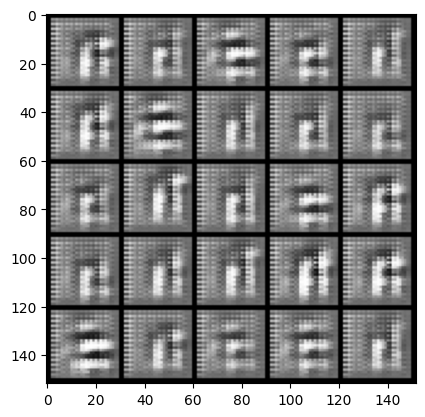

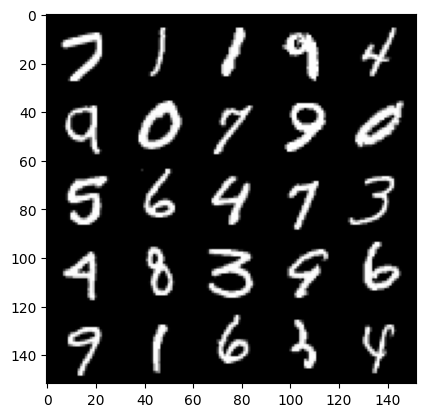

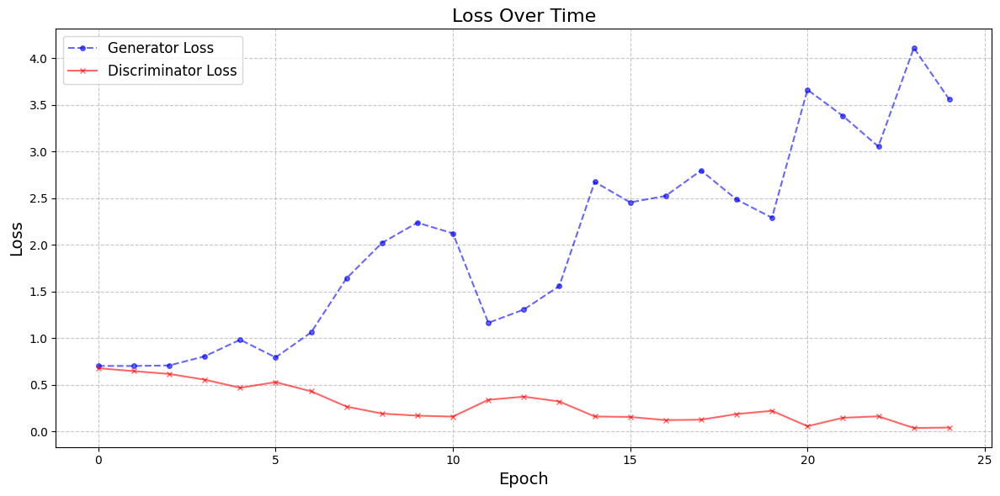

Saved best generator model with loss: 3.683170196533203
**********************
Epoch number: 2
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 1000: Generator loss: 3.5523244972229002, discriminator loss: 0.10995522145926952


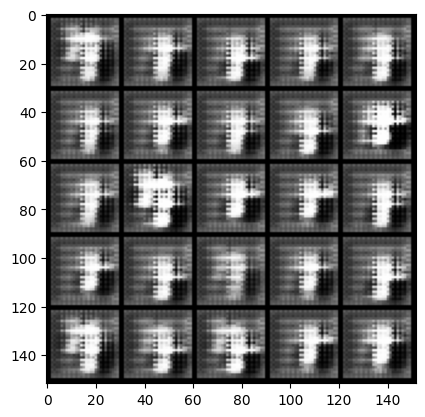

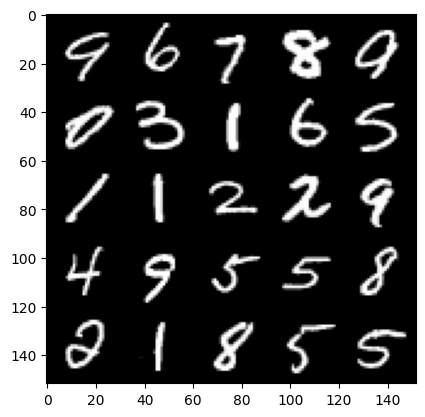

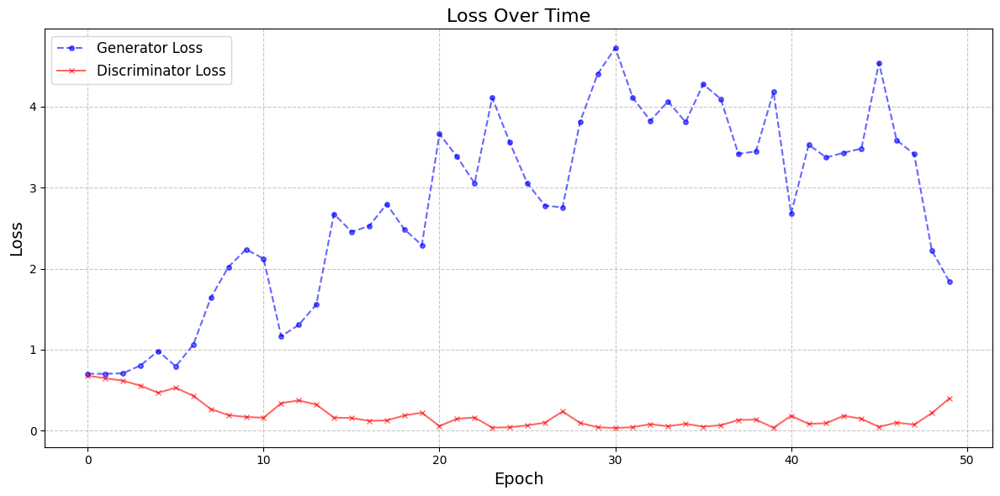

Saved best generator model with loss: 3.63760778260231
**********************
Epoch number: 3
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 1500: Generator loss: 3.6370095450878144, discriminator loss: 0.11456362725794315


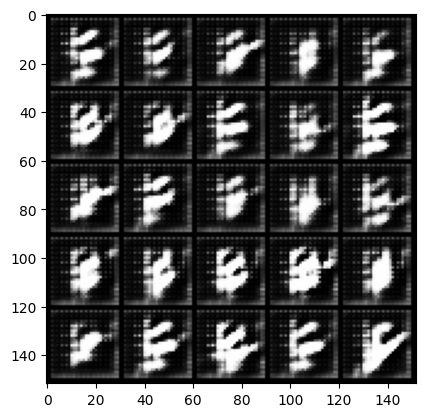

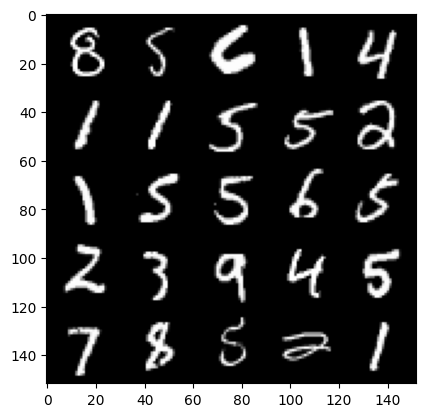

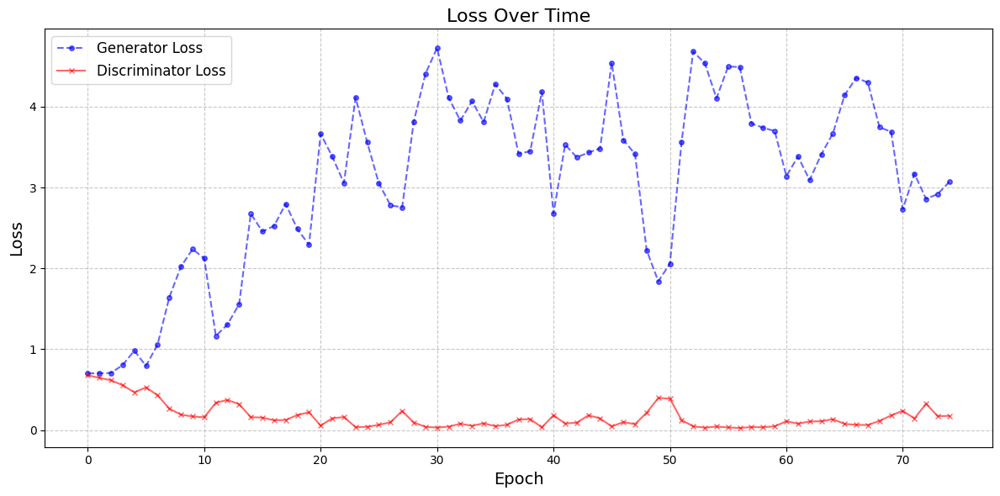

Saved best generator model with loss: 3.4828326396942137
**********************
Epoch number: 4
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 2000: Generator loss: 3.459185110092163, discriminator loss: 0.12619916572421788


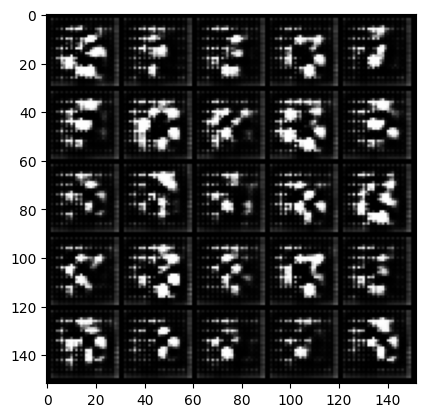

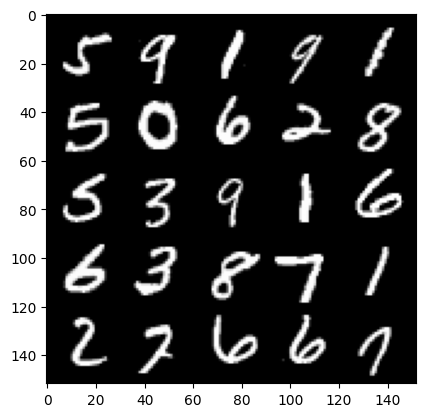

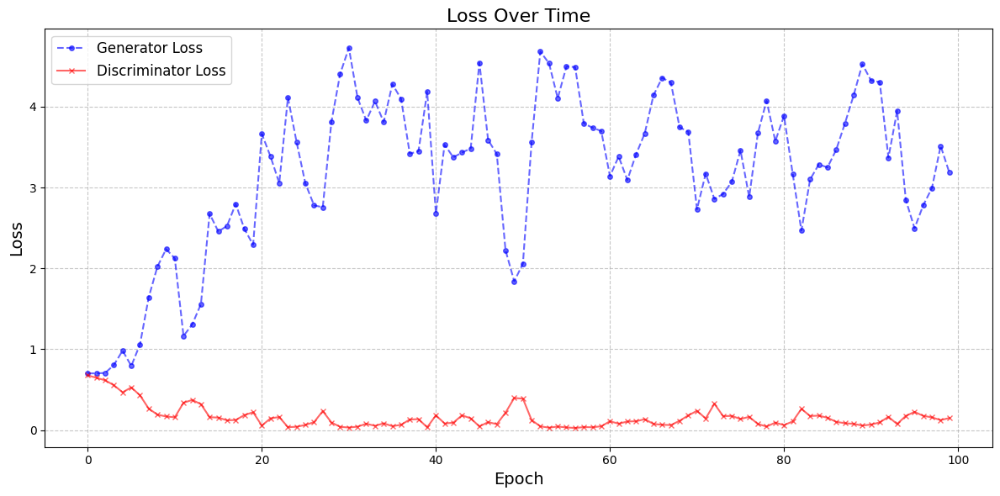

Saved best generator model with loss: 2.9503128616809846
**********************
Epoch number: 5
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 2500: Generator loss: 2.699259867191315, discriminator loss: 0.24096998018026353


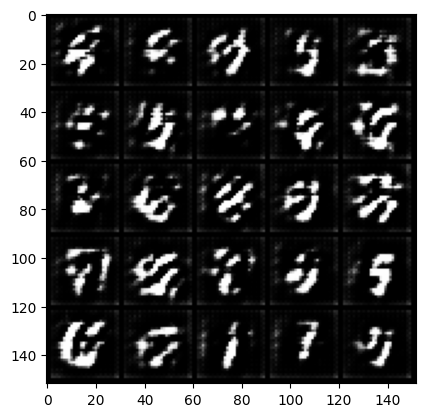

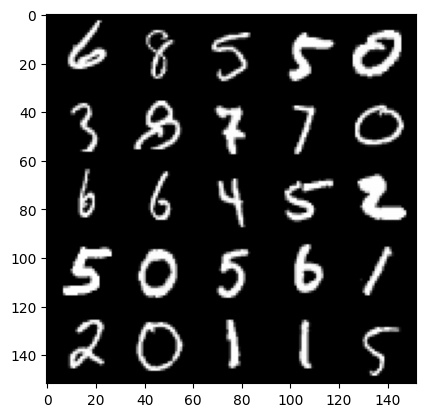

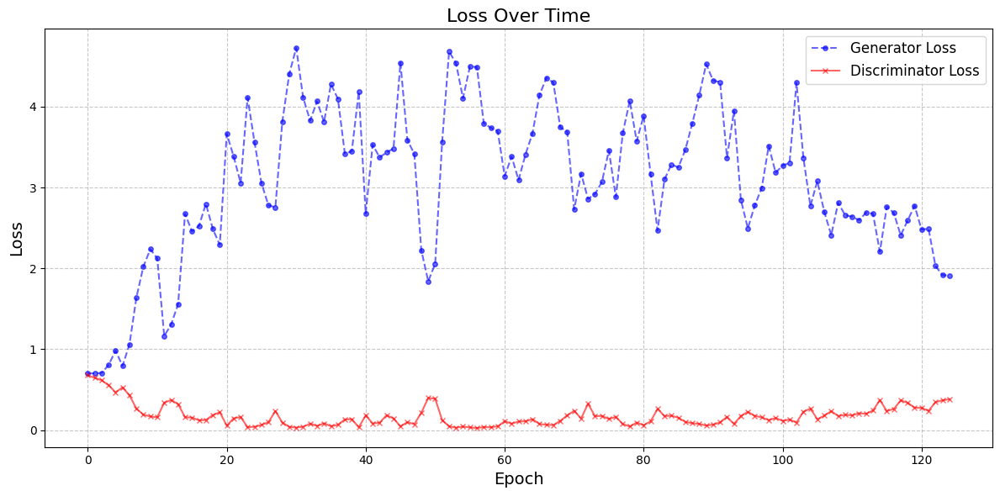

Saved best generator model with loss: 2.0677806231975557
**********************
Epoch number: 6
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 3000: Generator loss: 1.9511911458969116, discriminator loss: 0.34555658699572084


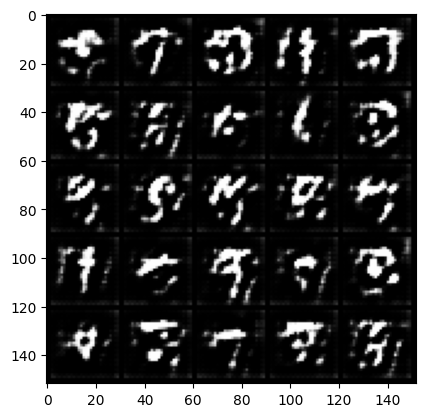

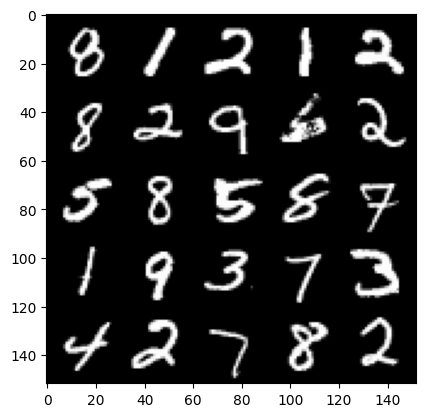

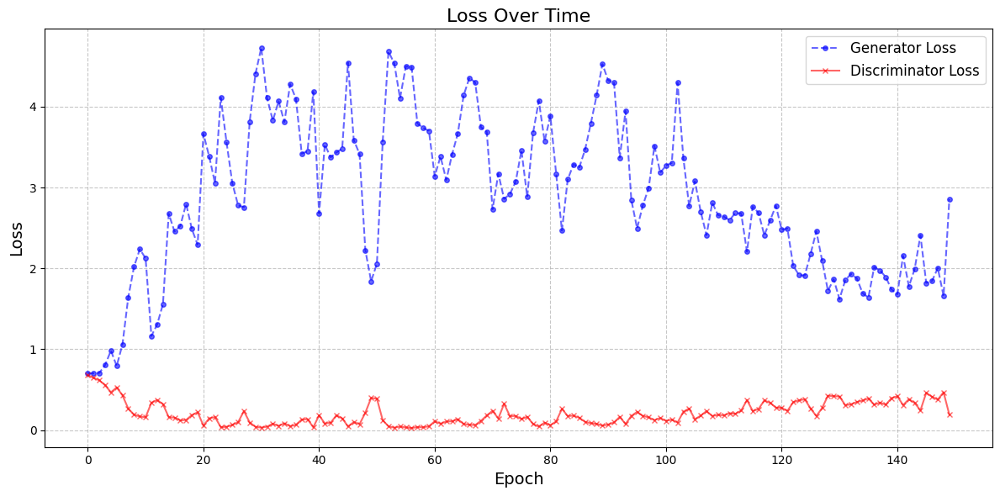

Saved best generator model with loss: 1.9302851819992066
**********************
Epoch number: 7
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 3500: Generator loss: 1.81894965672493, discriminator loss: 0.3883697806596756


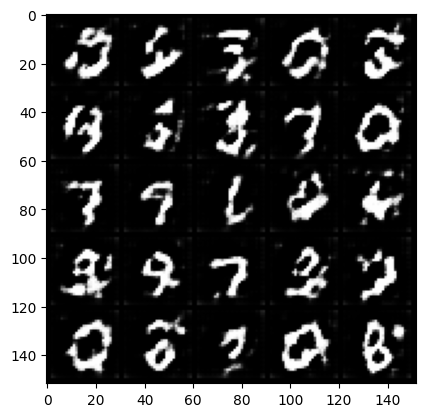

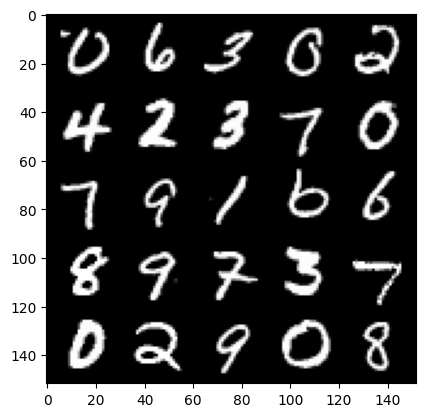

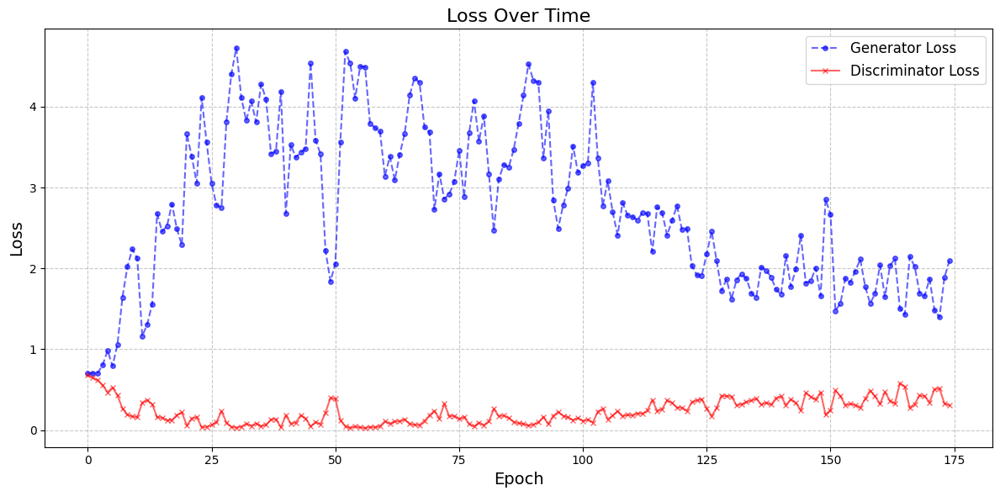

Saved best generator model with loss: 1.7592661395072937
**********************
Epoch number: 8
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 4000: Generator loss: 1.7747846157550813, discriminator loss: 0.4212203460931778


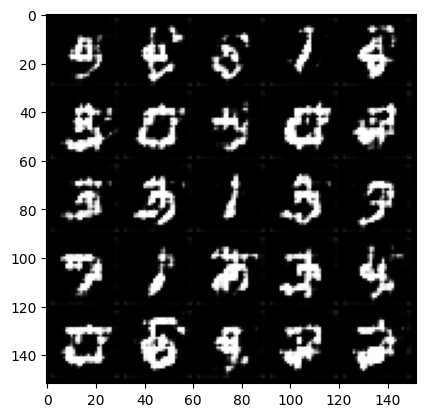

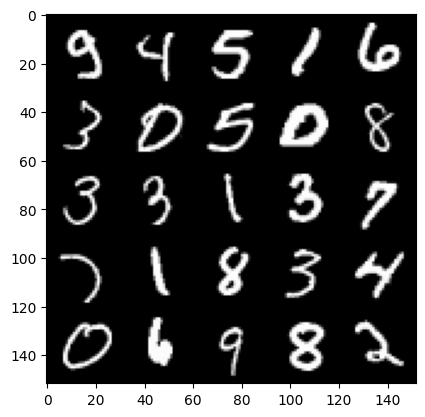

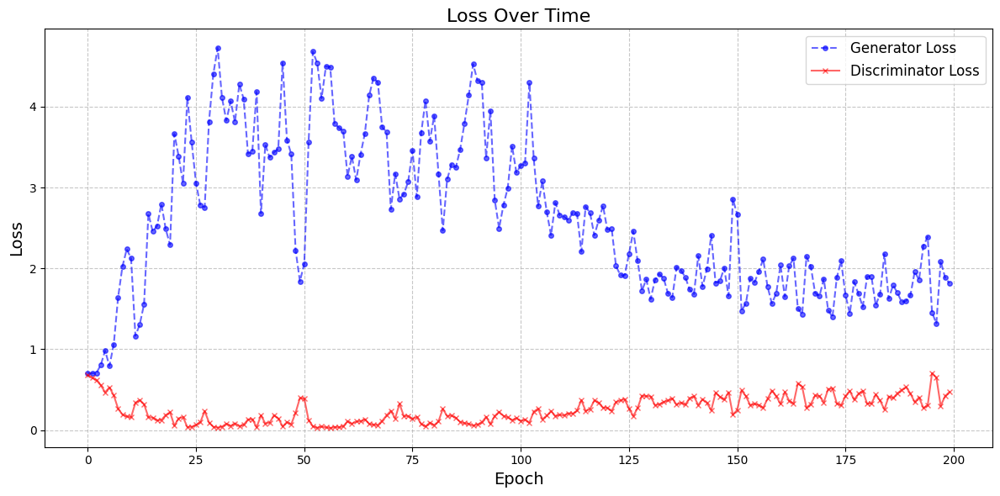

**********************
Epoch number: 9
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 4500: Generator loss: 1.7303379344940186, discriminator loss: 0.41801817673444747


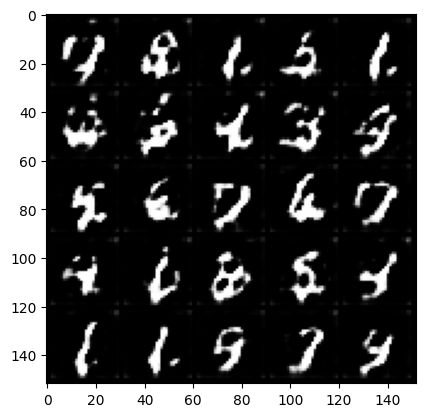

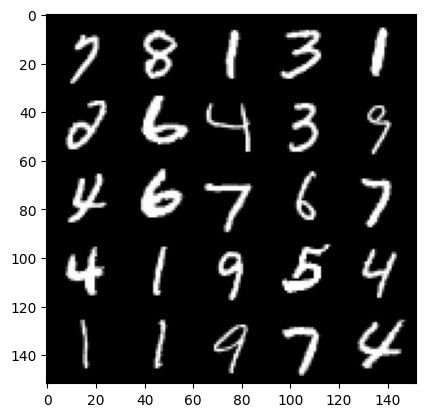

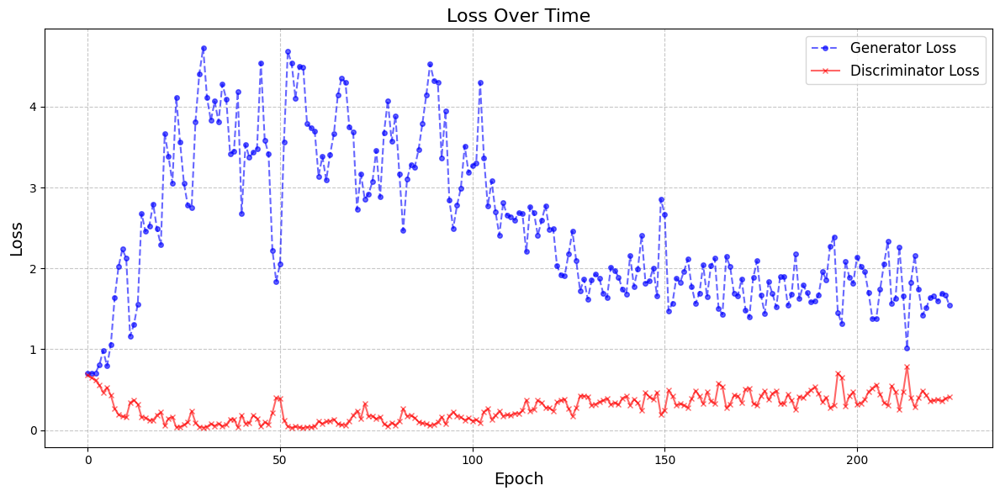

Saved best generator model with loss: 1.7504111685752868
**********************
Epoch number: 10
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 5000: Generator loss: 1.7201818192005158, discriminator loss: 0.4206775066256523


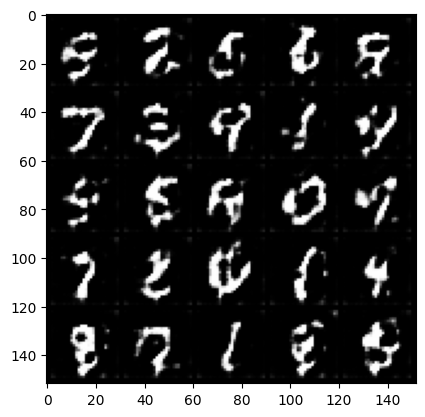

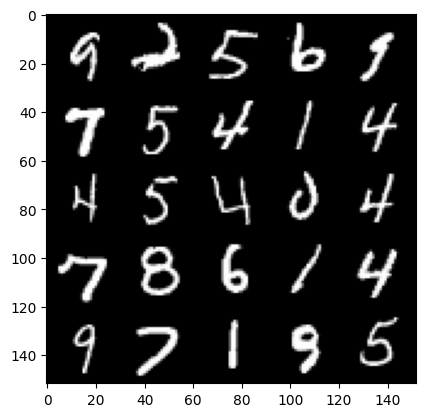

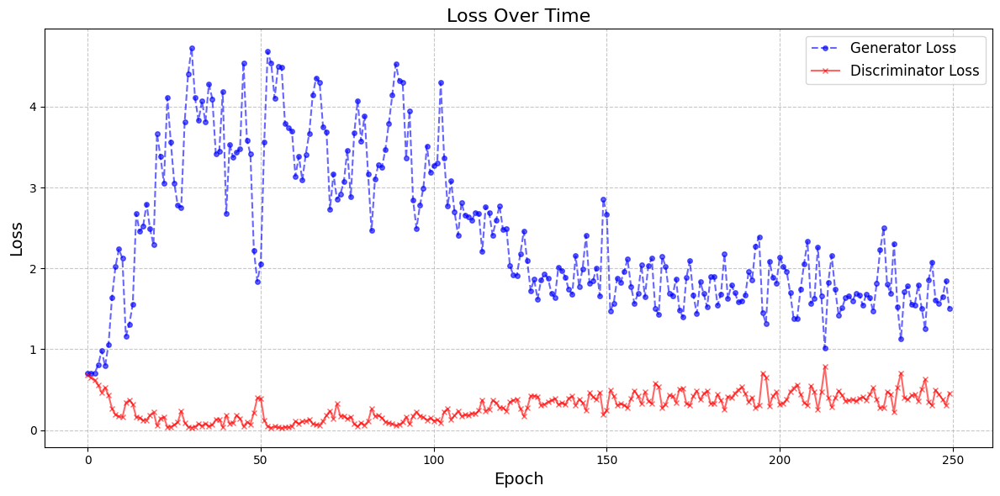

Saved best generator model with loss: 1.6685528576374054
**********************
Epoch number: 11
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 5500: Generator loss: 1.7289962606430054, discriminator loss: 0.4203658685982227


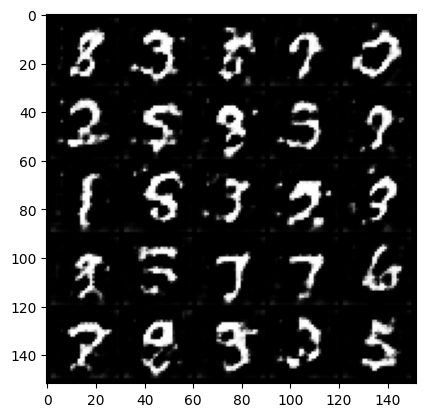

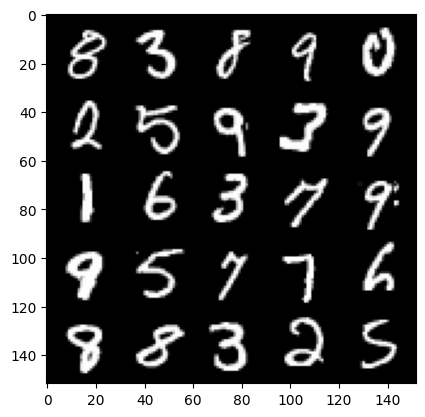

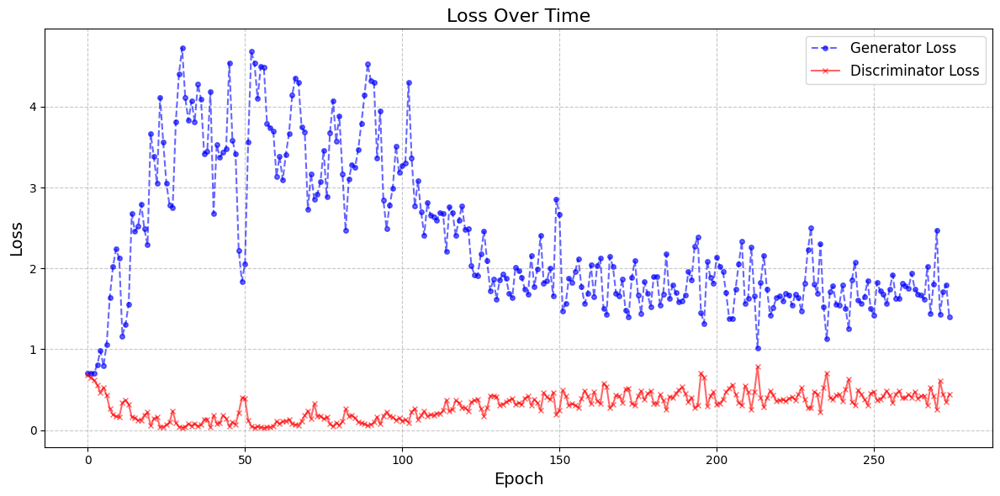

**********************
Epoch number: 12
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 6000: Generator loss: 1.5386717351675034, discriminator loss: 0.43611845713853836


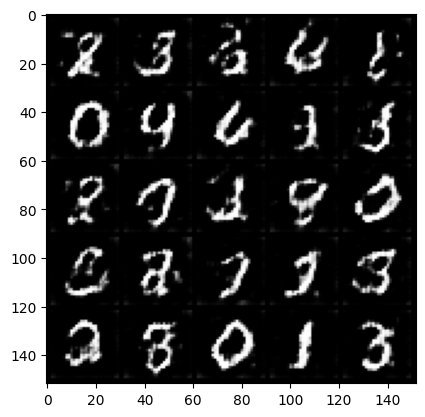

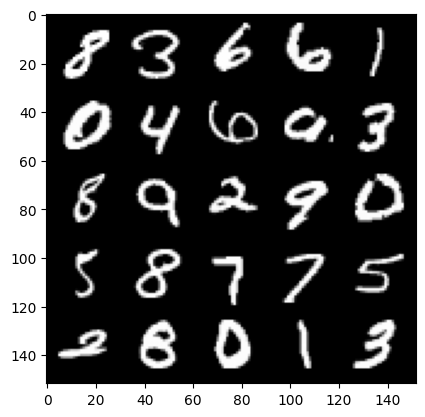

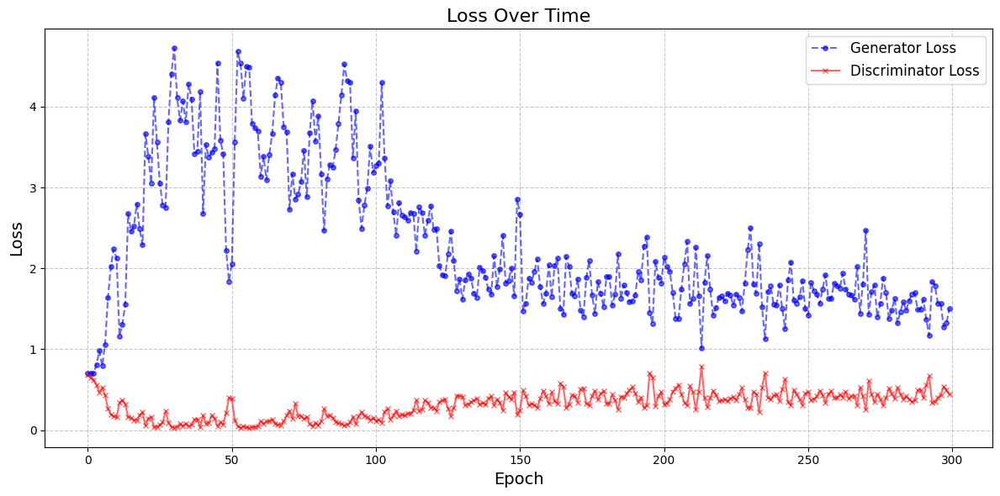

Saved best generator model with loss: 1.5299201480150222
**********************
Epoch number: 13
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 6500: Generator loss: 1.4769881162643432, discriminator loss: 0.4626916034221649


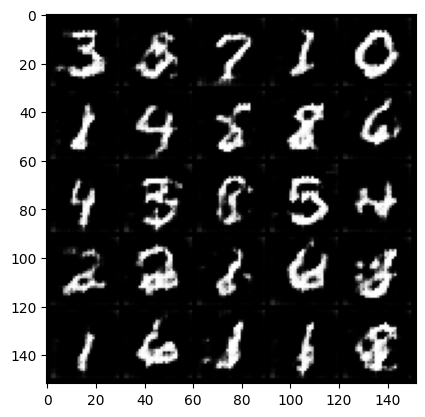

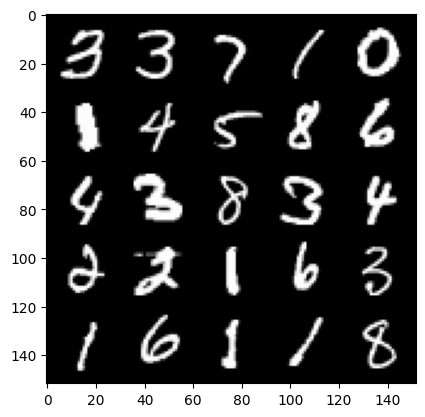

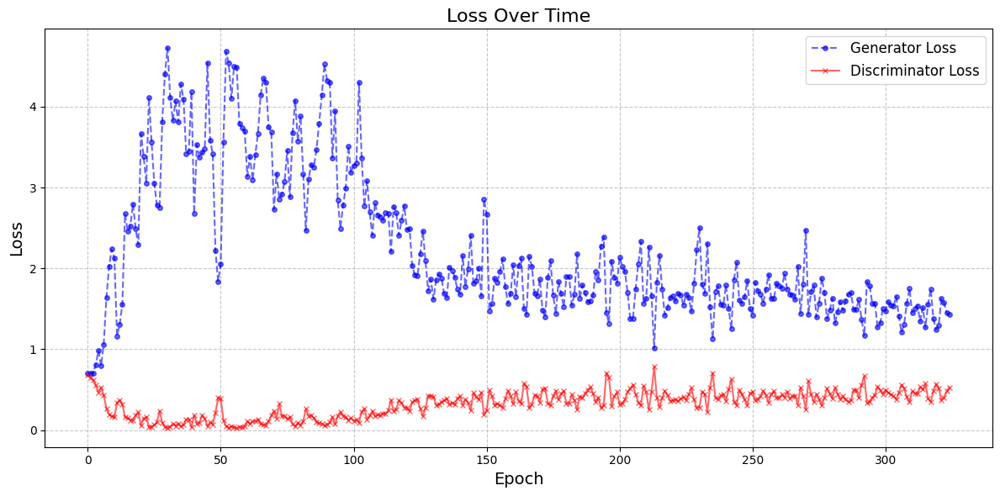

Saved best generator model with loss: 1.481502128124237
**********************
Epoch number: 14
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 7000: Generator loss: 1.4220528175830842, discriminator loss: 0.4640222571492195


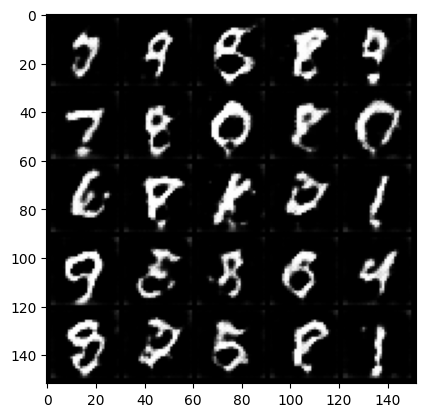

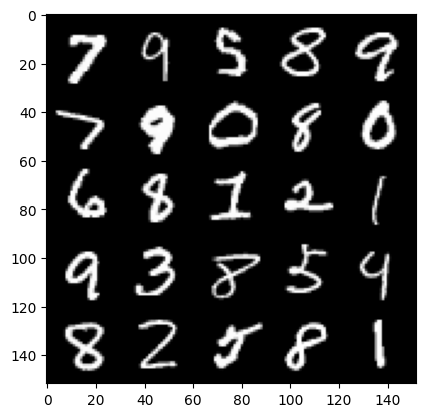

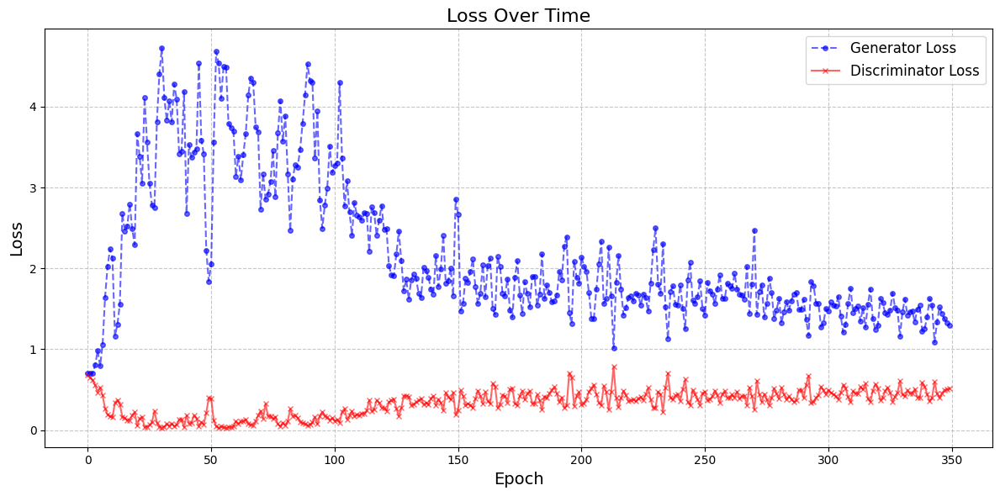

Saved best generator model with loss: 1.3987889454364777
**********************
Epoch number: 15
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 7500: Generator loss: 1.4305038282871245, discriminator loss: 0.477789135158062


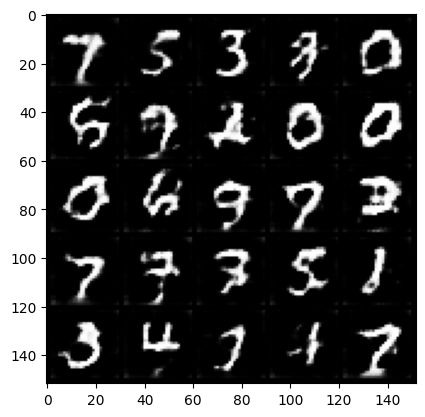

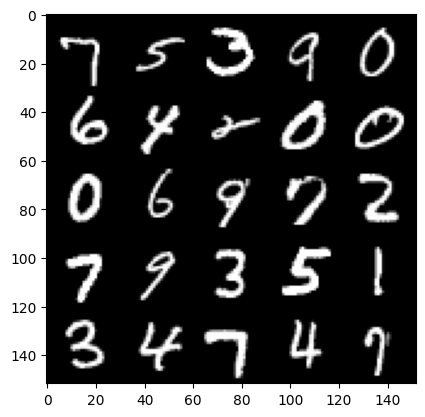

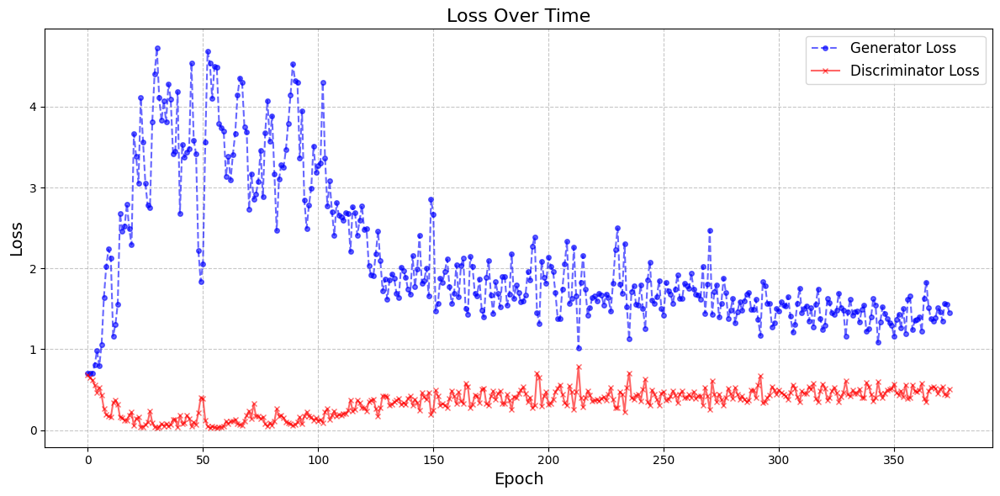

**********************
Epoch number: 16
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Saved best generator model with loss: 1.3617327779531478
**********************
Epoch number: 17
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 8000: Generator loss: 1.355166228413582, discriminator loss: 0.4959498621821404


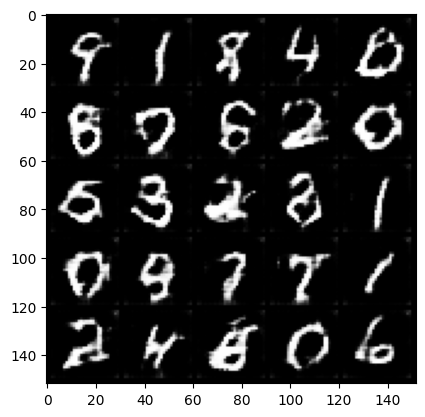

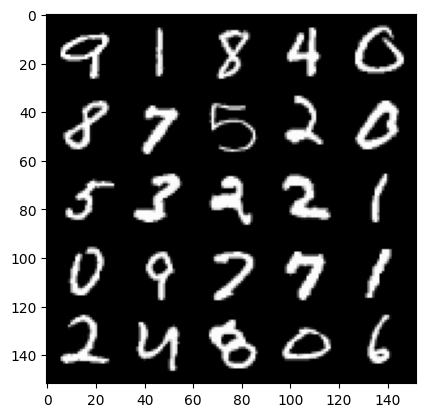

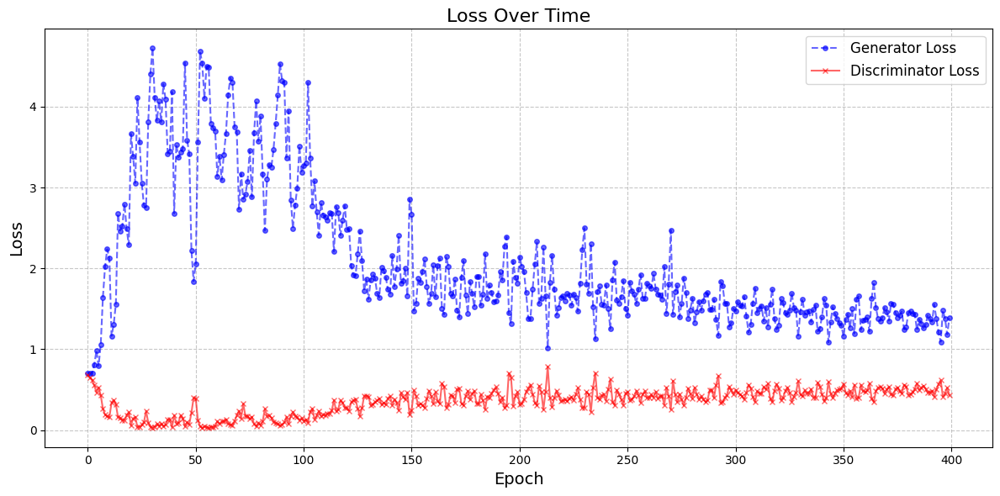

Saved best generator model with loss: 1.31979776096344
**********************
Epoch number: 18
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 8500: Generator loss: 1.320321485042572, discriminator loss: 0.5074286521673202


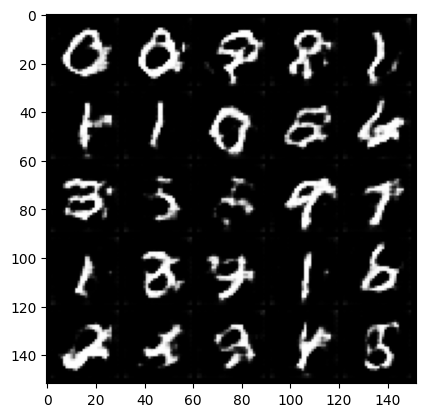

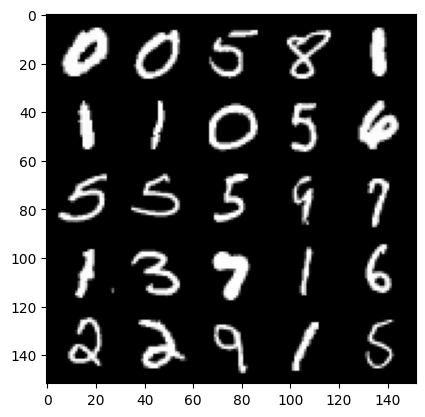

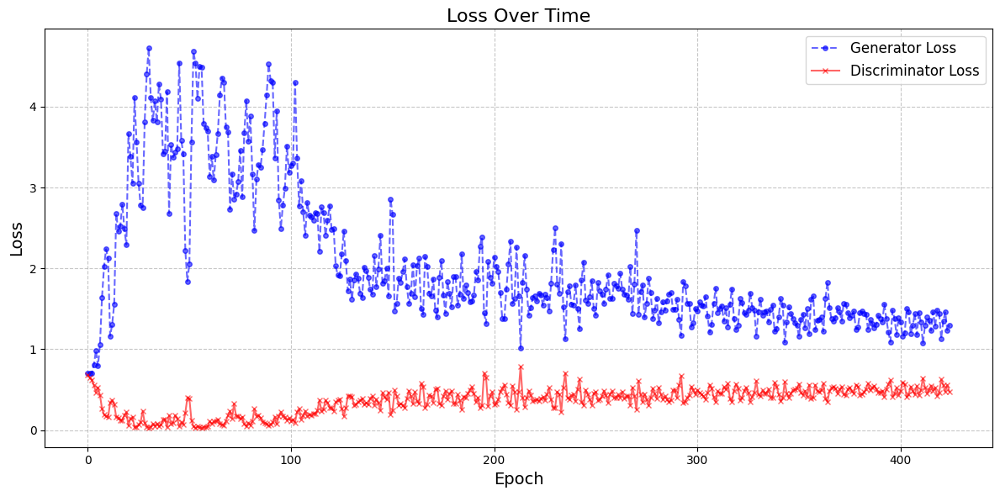

Saved best generator model with loss: 1.2999291081428528
**********************
Epoch number: 19
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 9000: Generator loss: 1.3056642155647278, discriminator loss: 0.5185713990926742


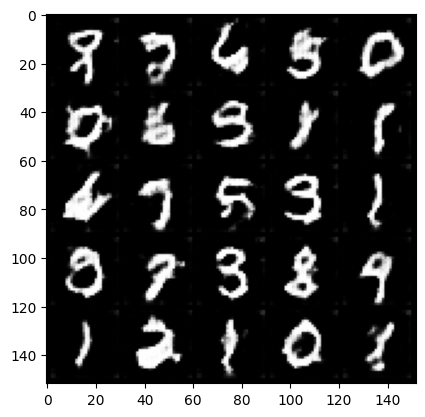

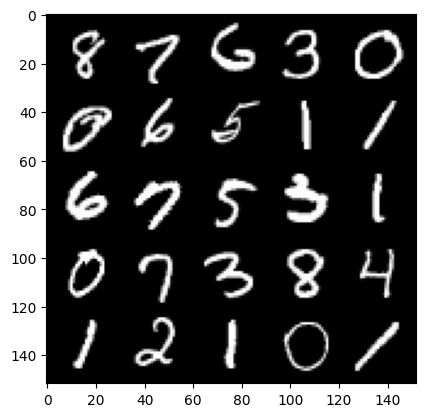

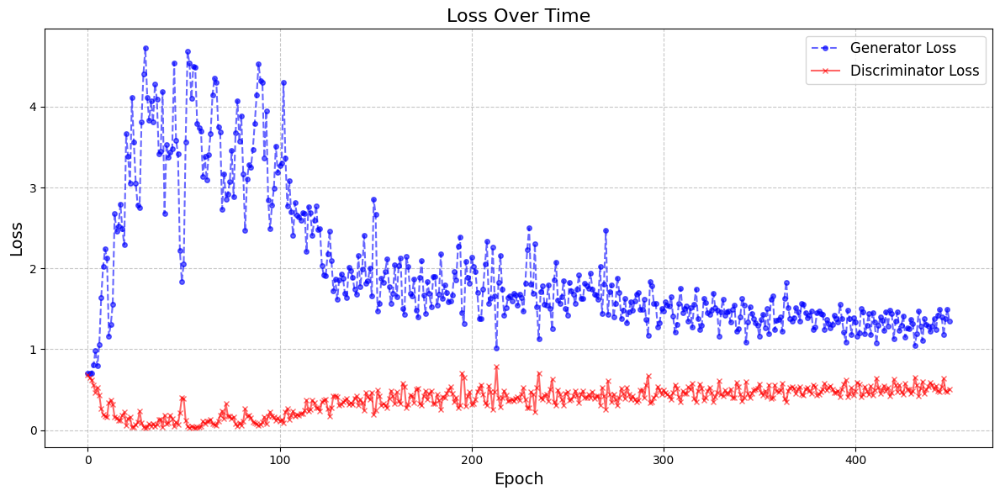

Saved best generator model with loss: 1.2711333593130112
**********************
Epoch number: 20
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 9500: Generator loss: 1.2319514430761338, discriminator loss: 0.5302563055753707


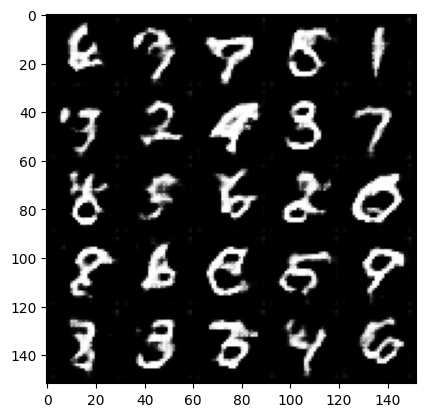

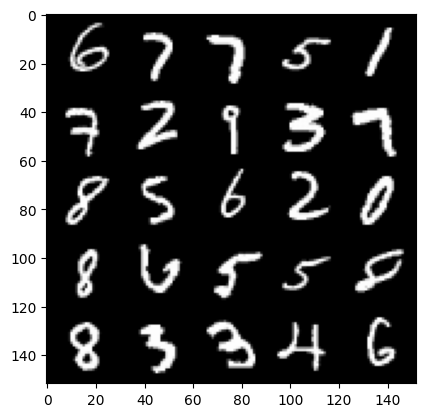

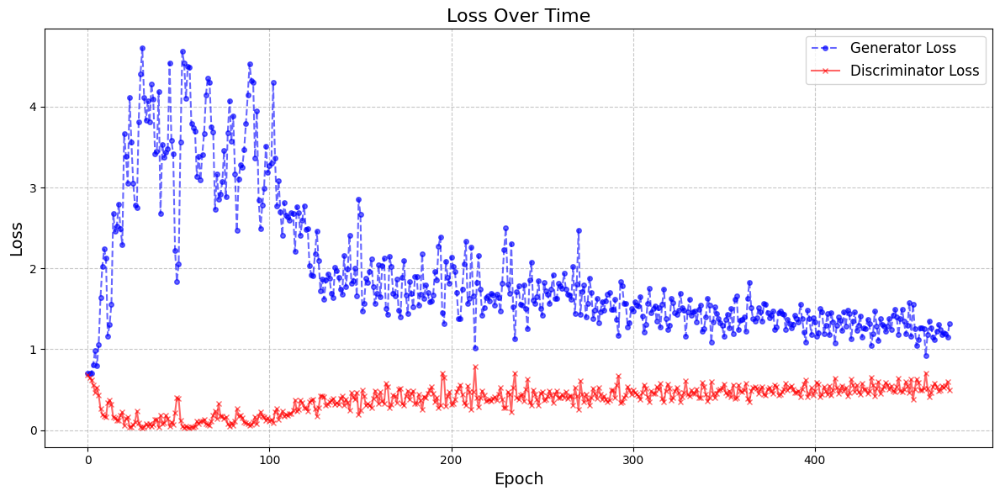

Saved best generator model with loss: 1.1885422189235688
**********************
Epoch number: 21
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 10000: Generator loss: 1.1761359741687776, discriminator loss: 0.5408699053525925


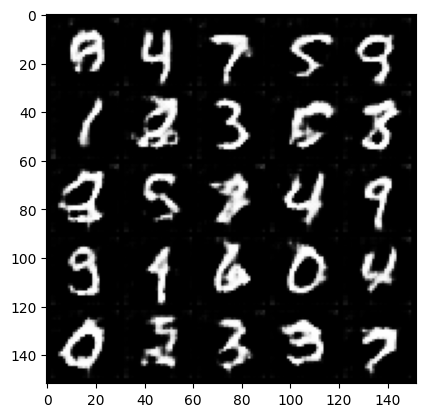

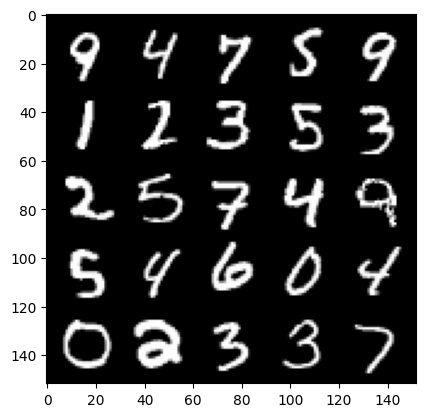

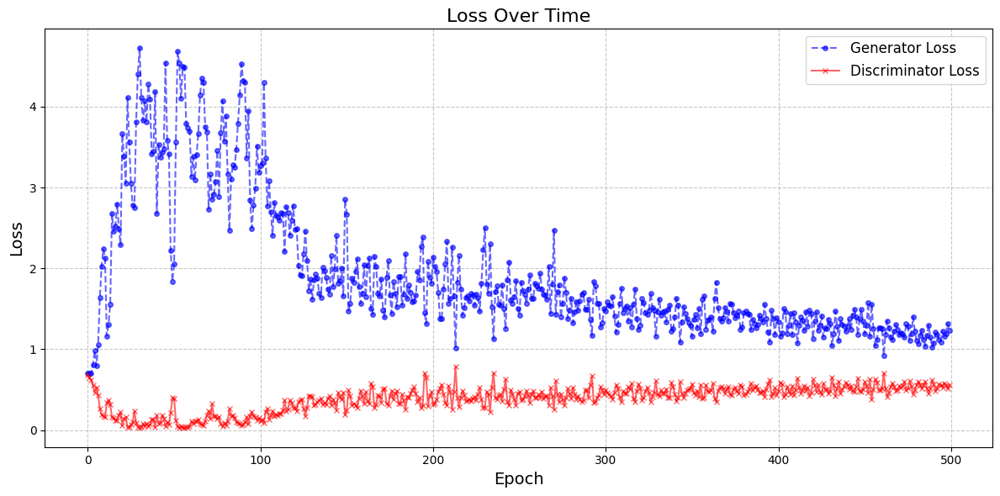

**********************
Epoch number: 22
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 10500: Generator loss: 1.1910867284536362, discriminator loss: 0.5588731829524041


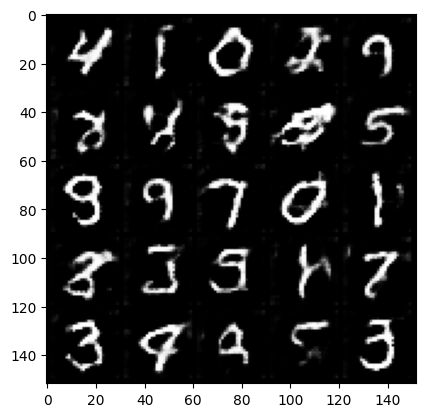

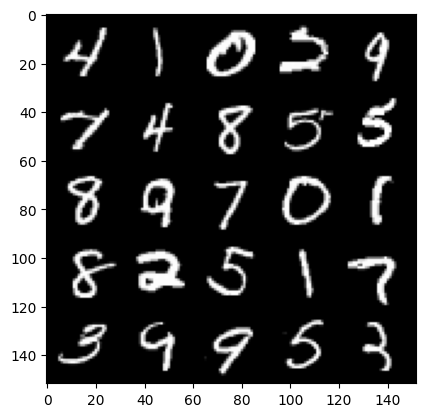

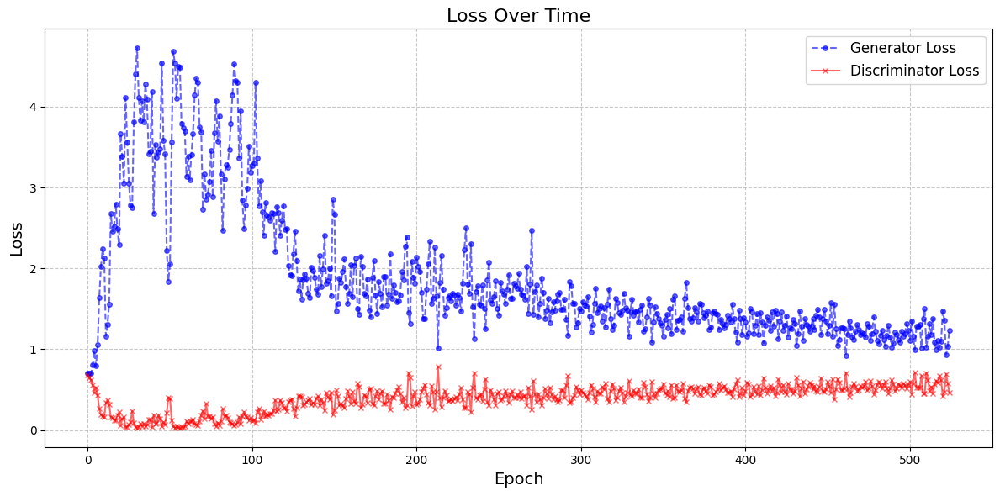

Saved best generator model with loss: 1.1188730635643005
**********************
Epoch number: 23
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 11000: Generator loss: 1.1281033663749696, discriminator loss: 0.5618685239553451


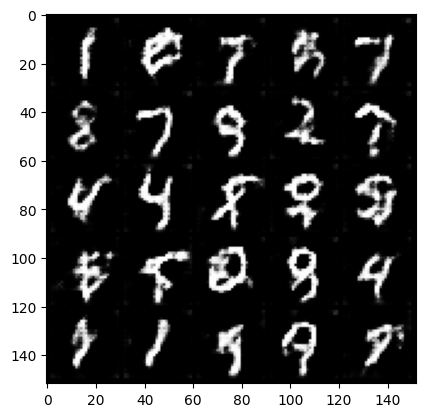

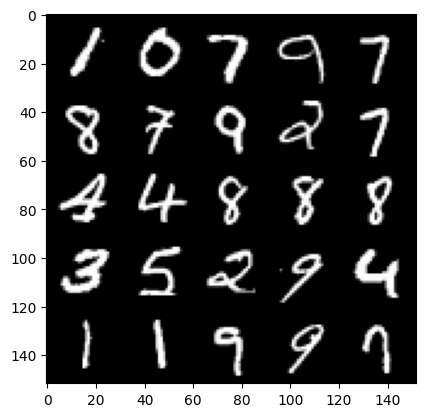

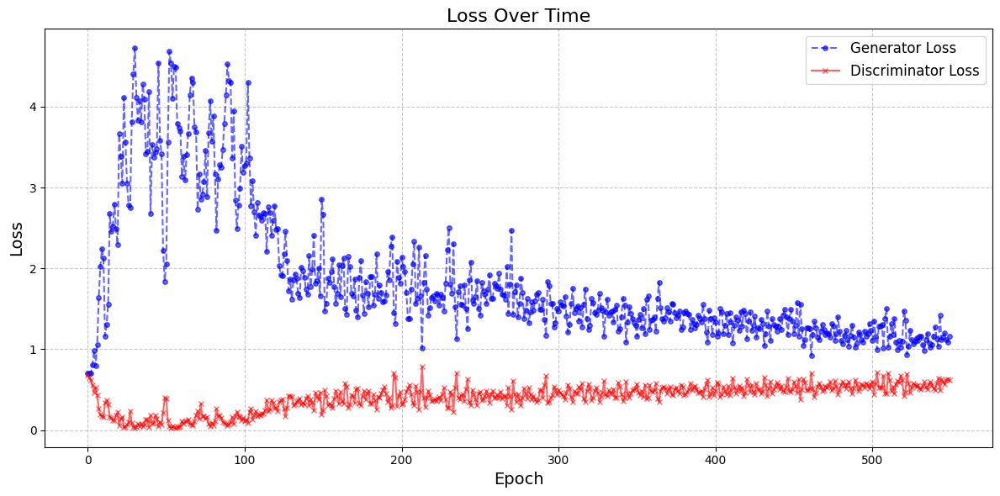

**********************
Epoch number: 24
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 11500: Generator loss: 1.1771932009458541, discriminator loss: 0.55514224421978


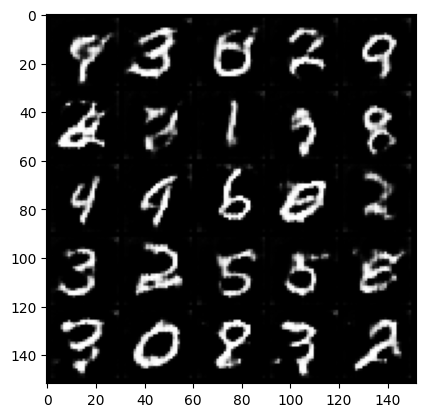

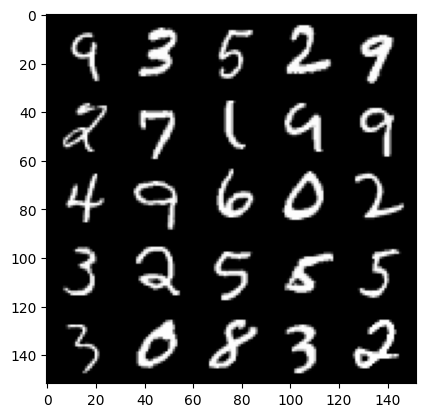

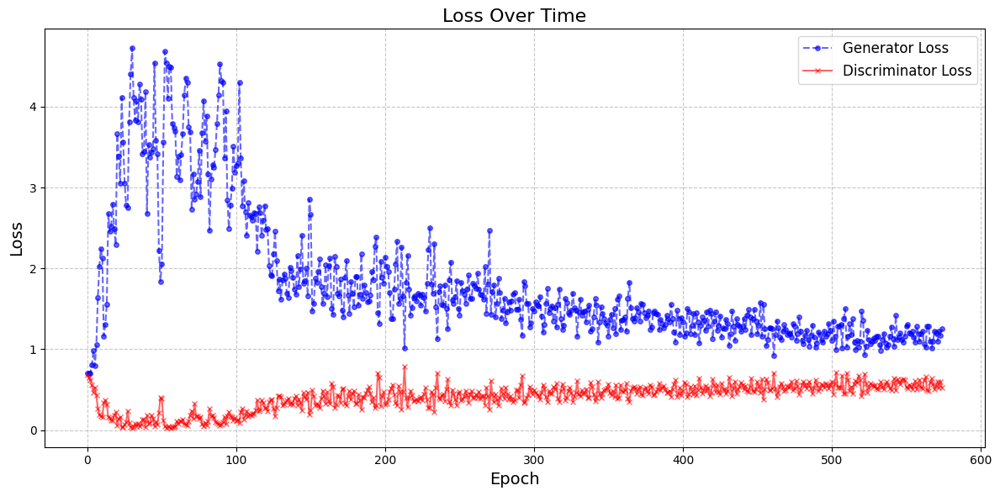

**********************
Epoch number: 25
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 12000: Generator loss: 1.1469253404140471, discriminator loss: 0.5565484856367111


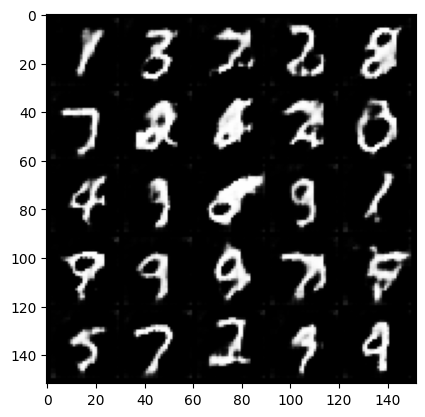

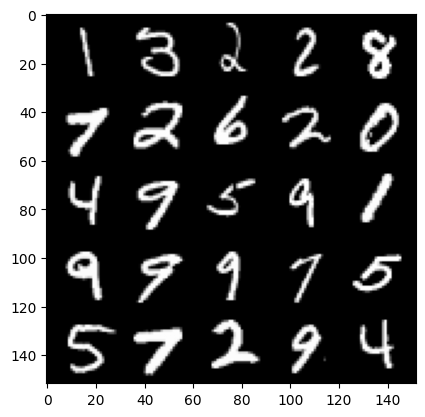

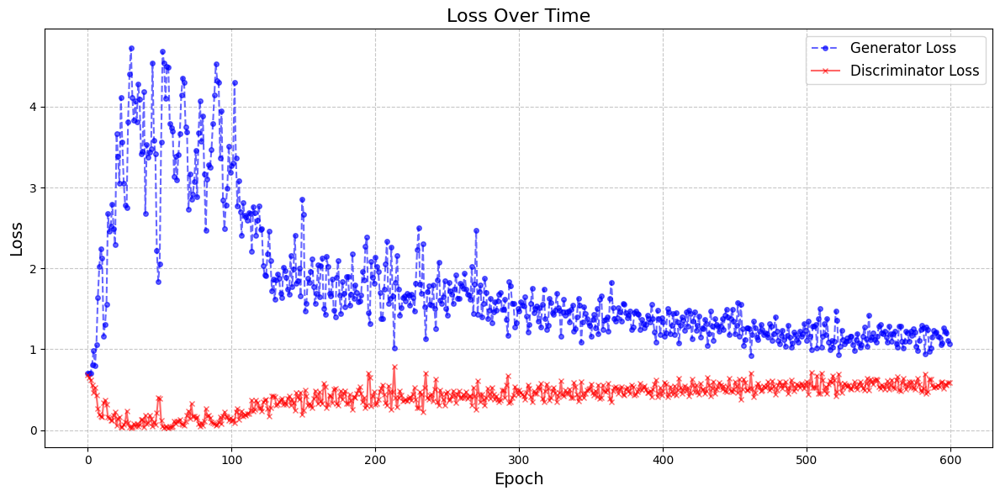

**********************
Epoch number: 26
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 12500: Generator loss: 1.1247296825647355, discriminator loss: 0.5611885797977447


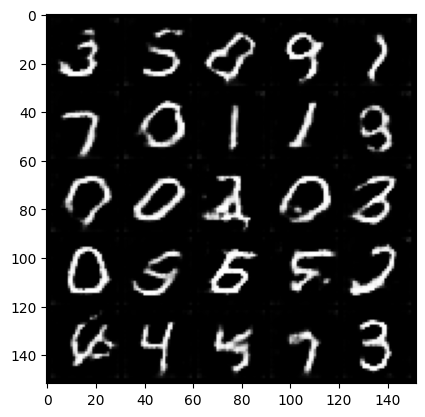

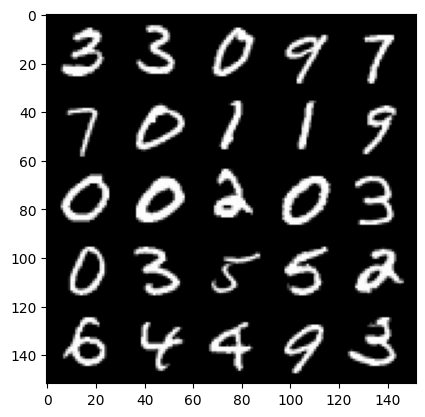

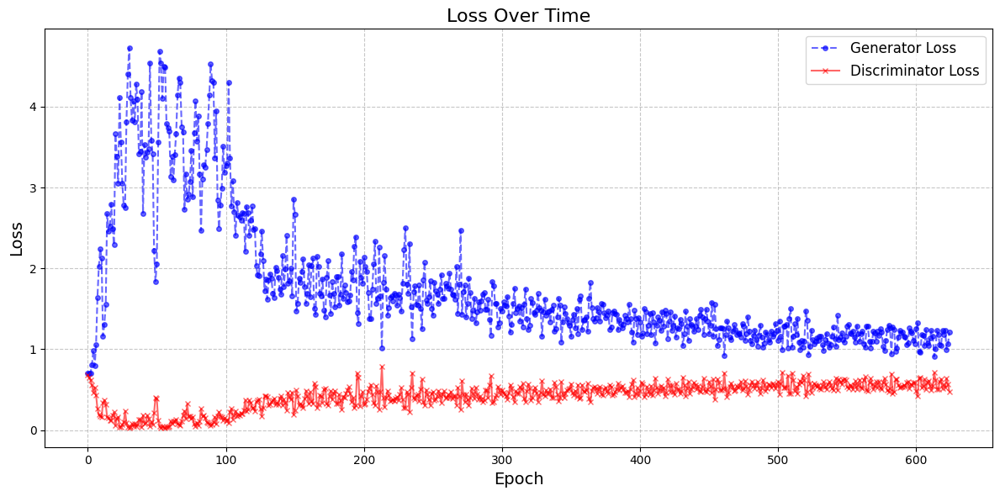

Saved best generator model with loss: 1.113642998456955
**********************
Epoch number: 27
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 13000: Generator loss: 1.0939286110401154, discriminator loss: 0.5727512437105179


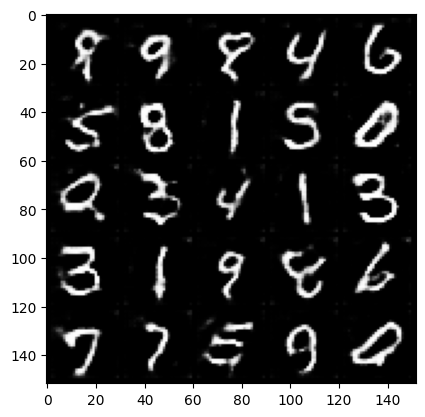

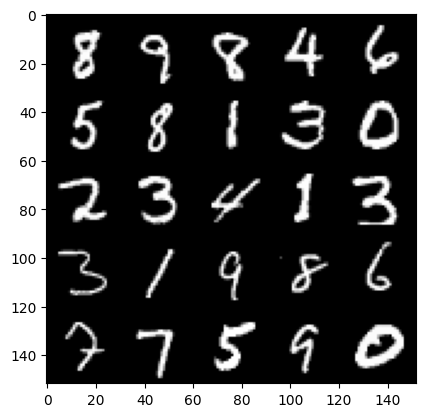

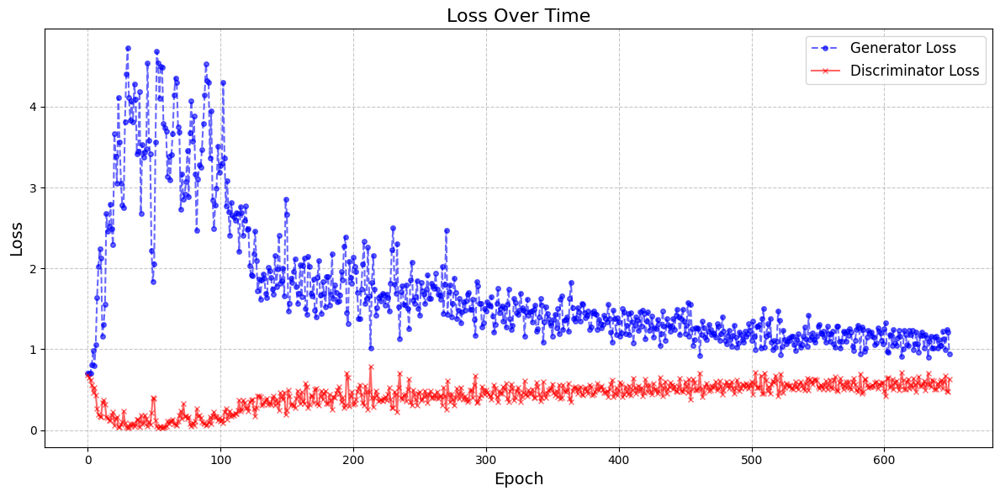

Saved best generator model with loss: 1.0913907721042633
**********************
Epoch number: 28
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 13500: Generator loss: 1.1009441220760345, discriminator loss: 0.5763443151712417


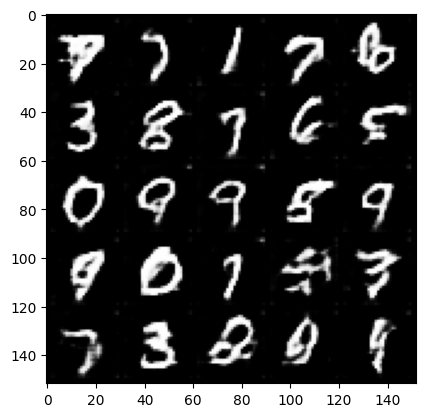

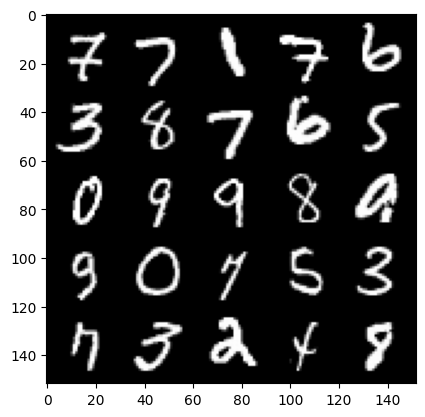

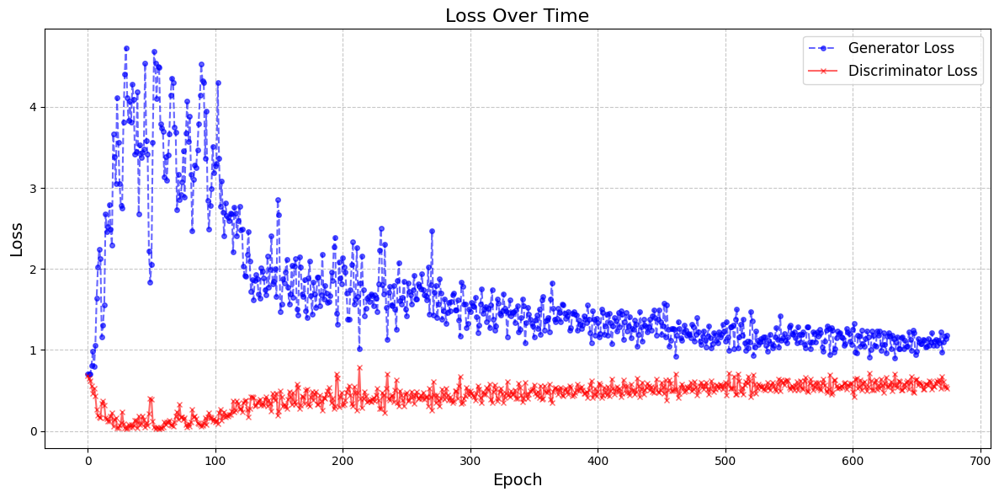

**********************
Epoch number: 29
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 14000: Generator loss: 1.0892973608970642, discriminator loss: 0.5798680940270424


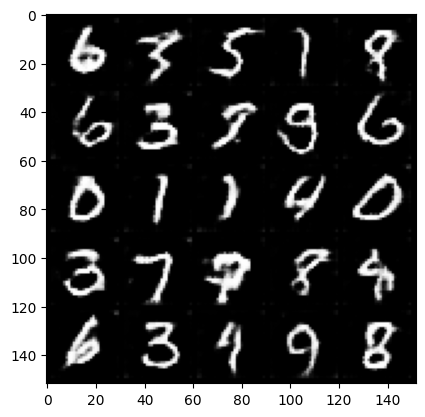

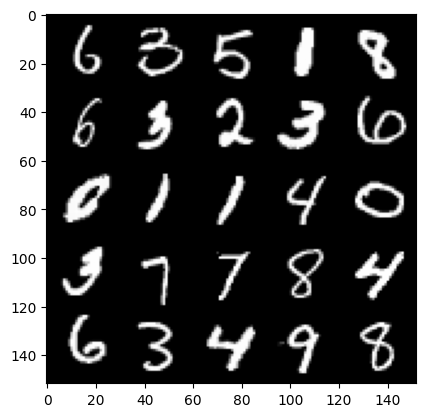

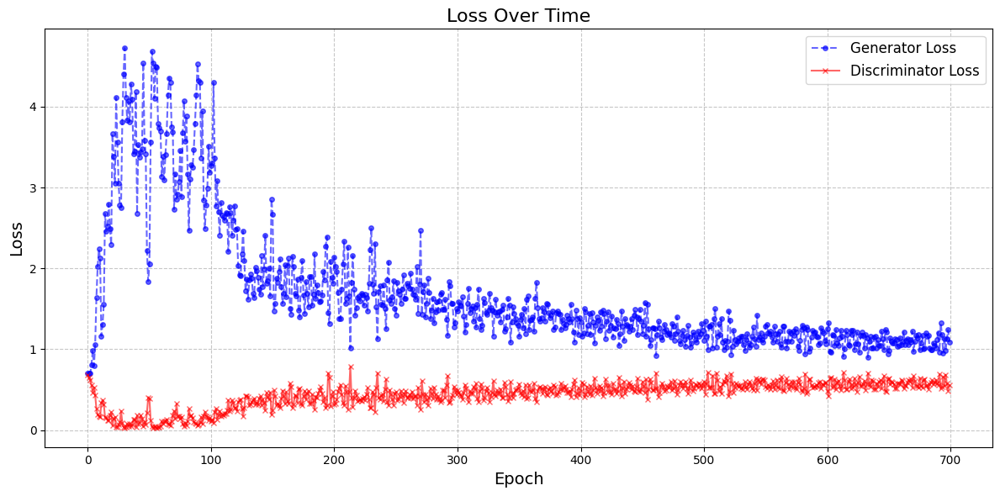

Saved best generator model with loss: 1.0815475960969925
**********************
Epoch number: 30
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 14500: Generator loss: 1.0487785602808, discriminator loss: 0.581152528166771


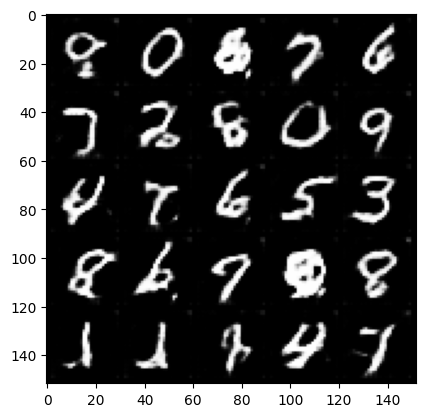

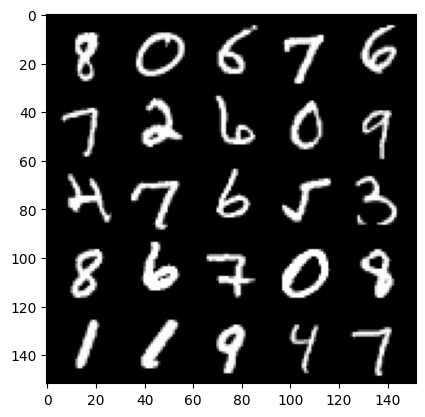

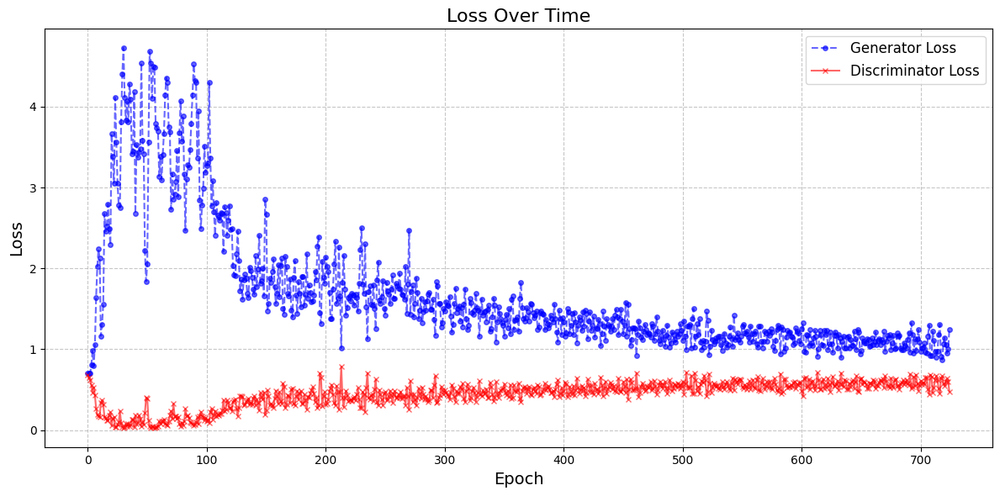

Saved best generator model with loss: 1.0518767862319947
**********************
Epoch number: 31
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 15000: Generator loss: 1.0943699079751967, discriminator loss: 0.5881057609319686


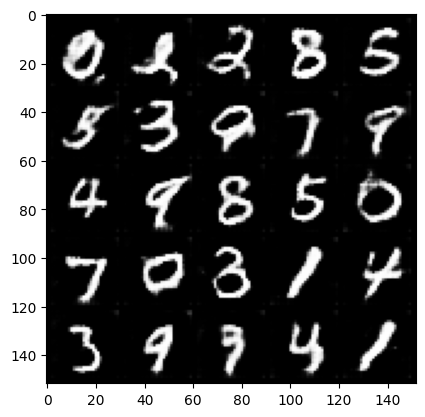

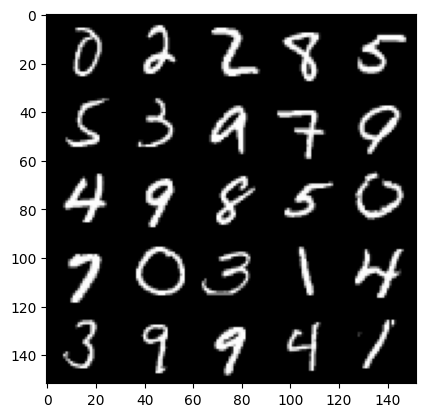

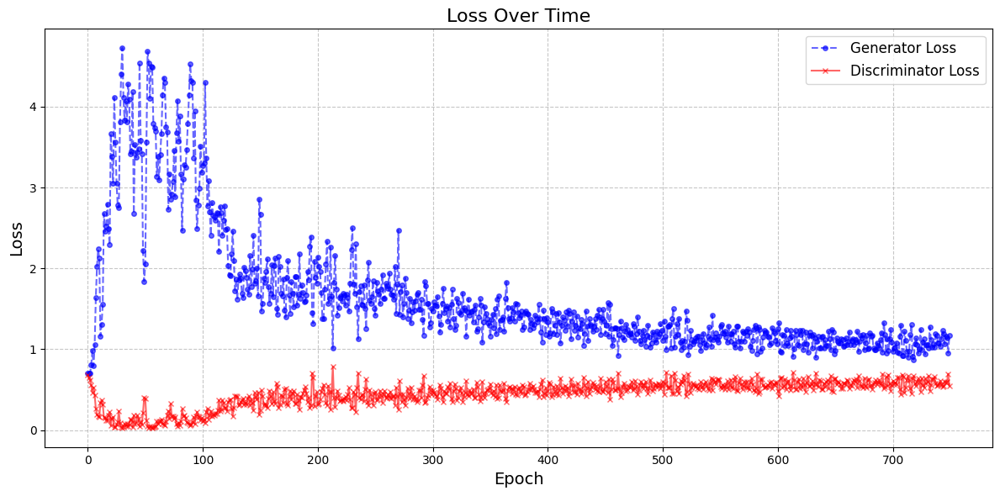

**********************
Epoch number: 32
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

**********************
Epoch number: 33
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 15500: Generator loss: 1.0787540148496628, discriminator loss: 0.5807376171946526


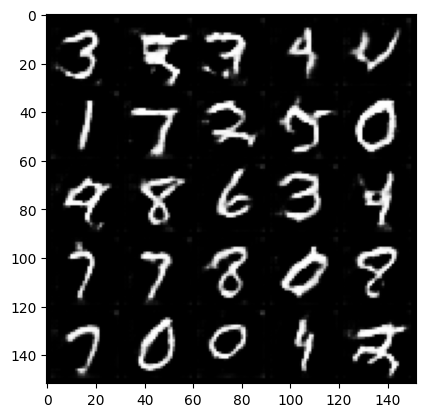

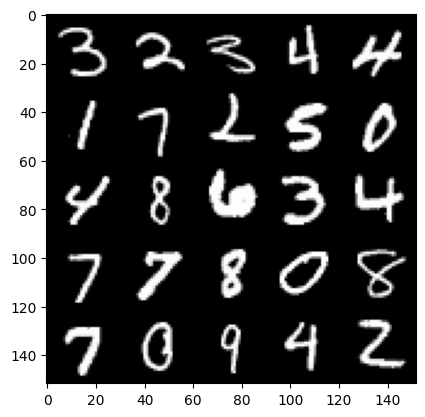

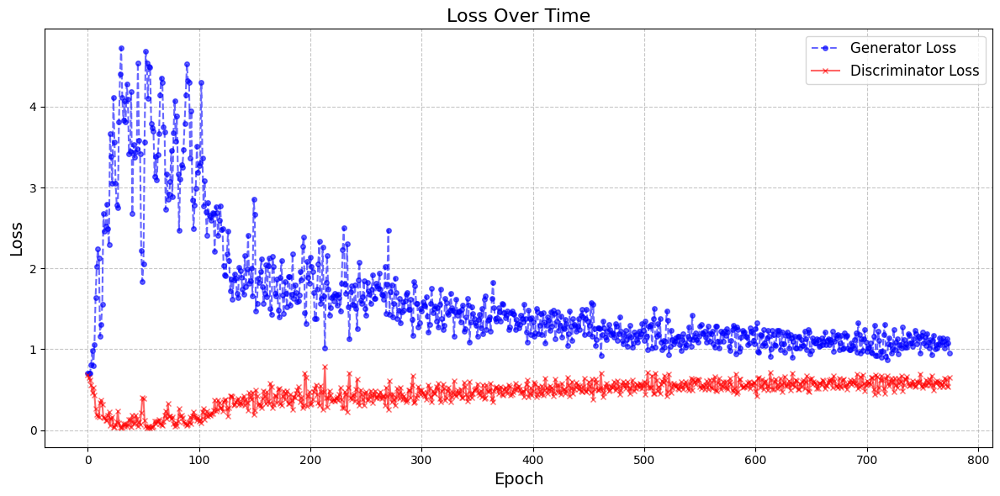

**********************
Epoch number: 34
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 16000: Generator loss: 1.0537102098464965, discriminator loss: 0.5905797618031502


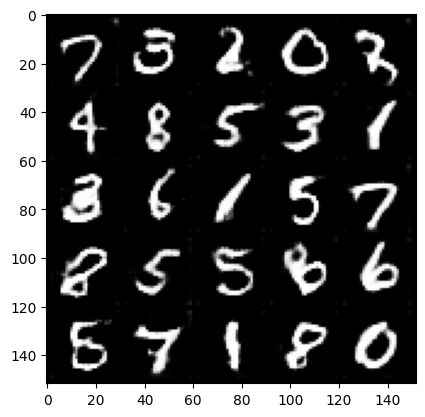

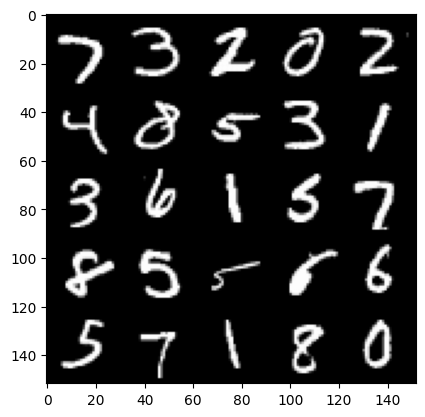

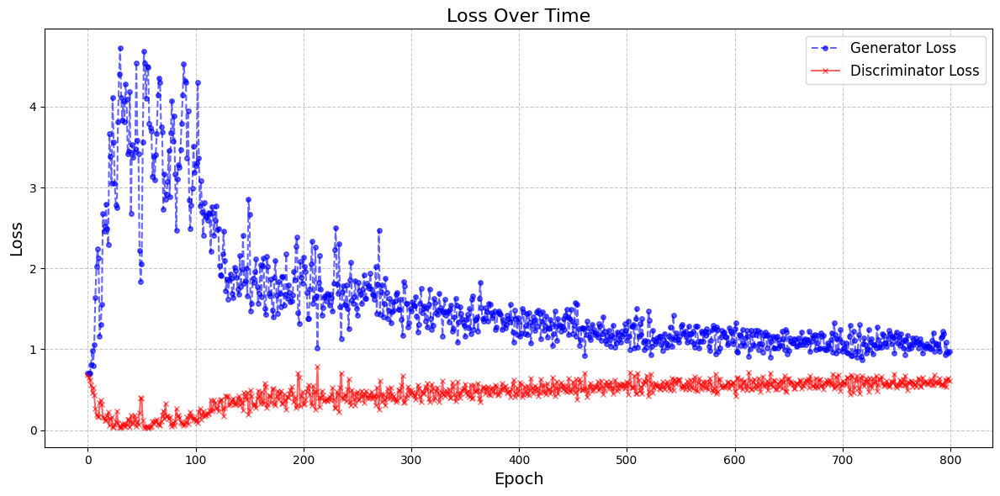

Saved best generator model with loss: 1.0044576318264007
**********************
Epoch number: 35
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 16500: Generator loss: 1.015503727197647, discriminator loss: 0.5847165189385414


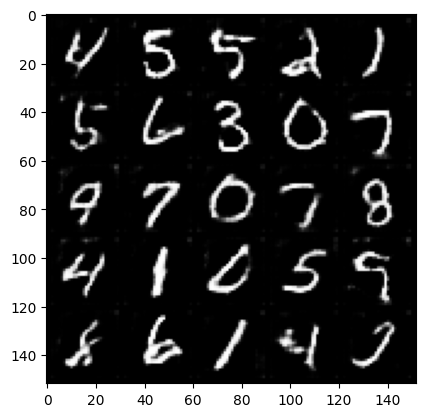

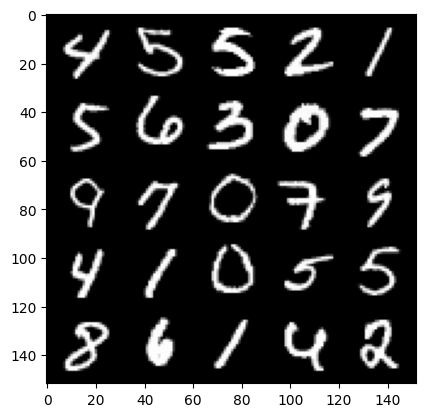

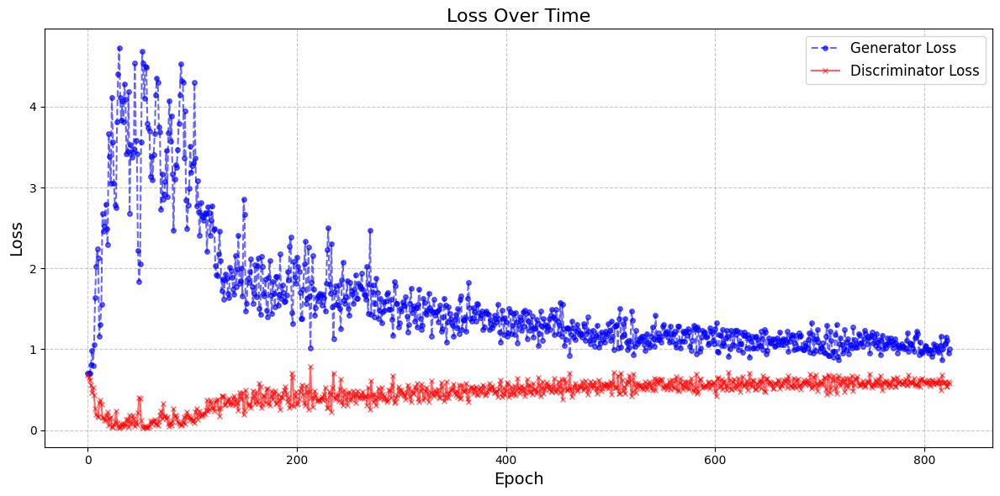

**********************
Epoch number: 36
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 17000: Generator loss: 1.0382079204320909, discriminator loss: 0.5944735498428345


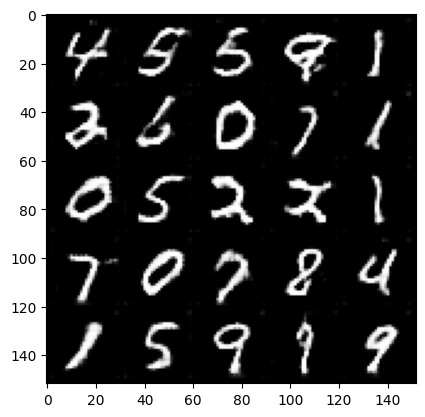

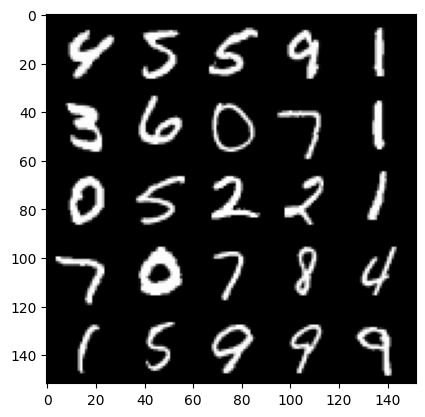

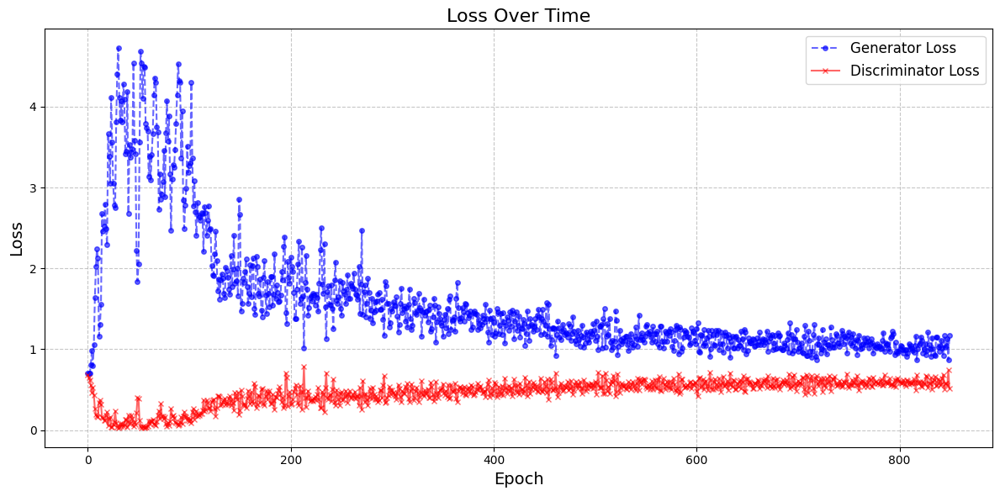

**********************
Epoch number: 37
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 17500: Generator loss: 1.0400104957818985, discriminator loss: 0.591106085240841


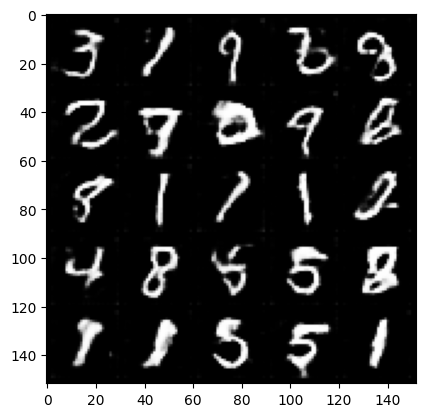

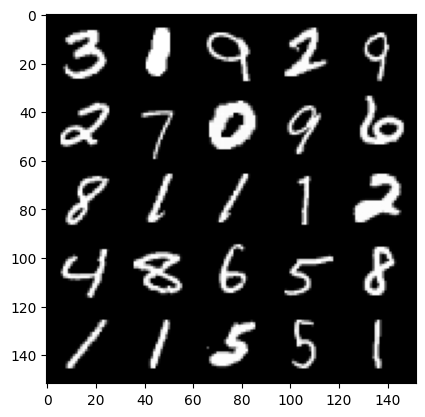

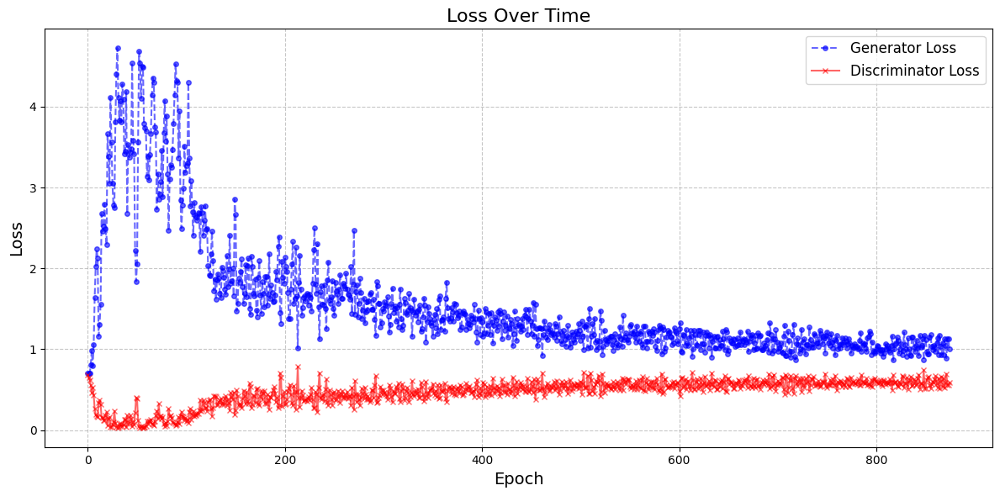

**********************
Epoch number: 38
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 18000: Generator loss: 1.0285586656332015, discriminator loss: 0.5901022412776947


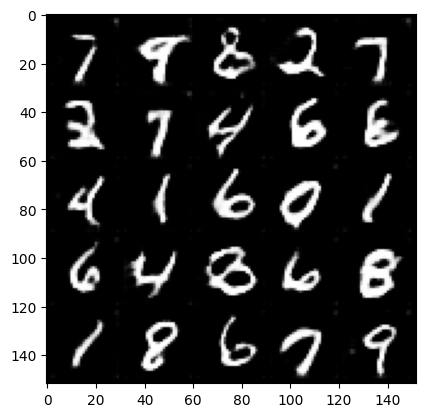

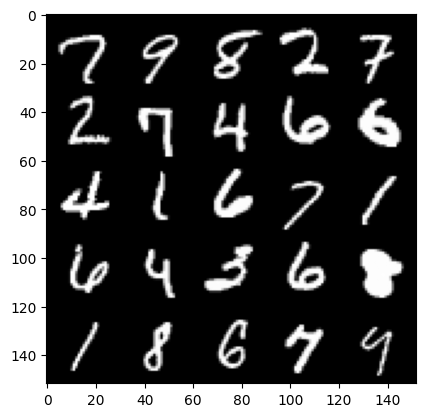

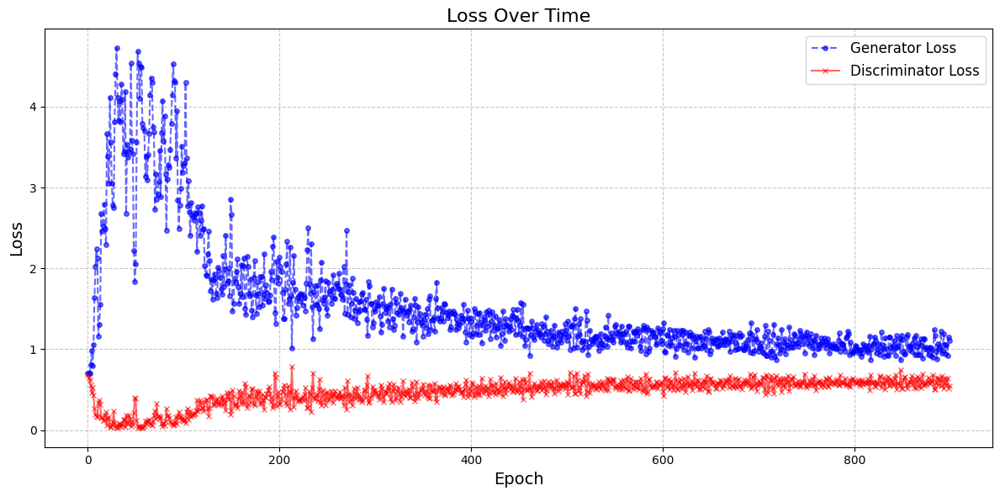

**********************
Epoch number: 39
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 18500: Generator loss: 1.0048031799793244, discriminator loss: 0.5971072880625725


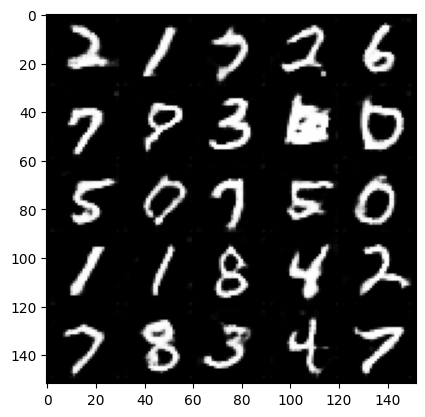

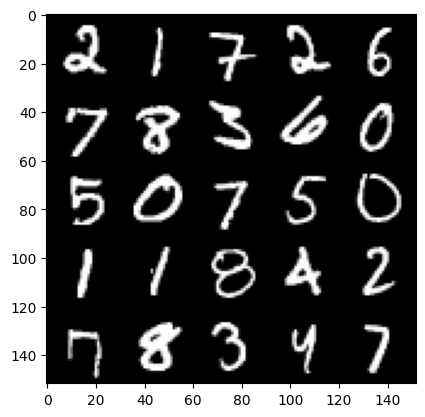

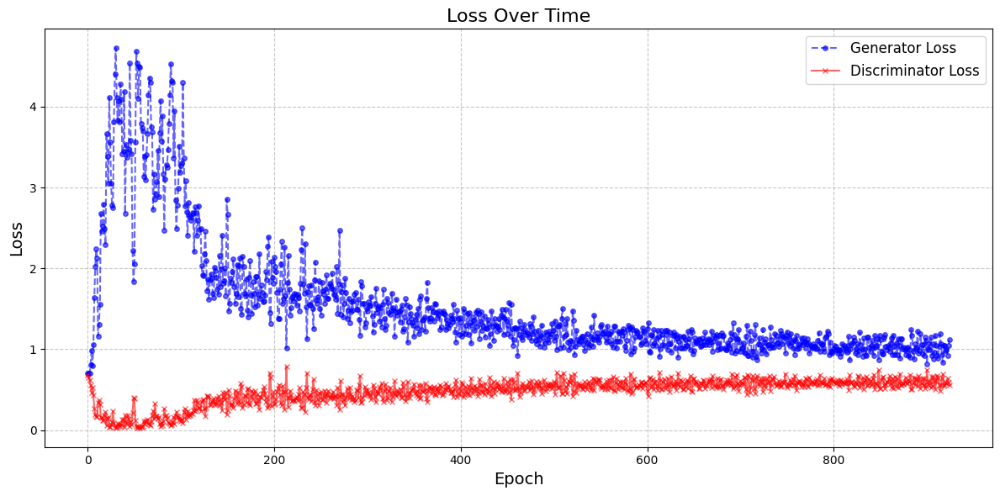

Saved best generator model with loss: 1.0031119419336318
**********************
Epoch number: 40
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 19000: Generator loss: 0.994200777053833, discriminator loss: 0.5938434753417968


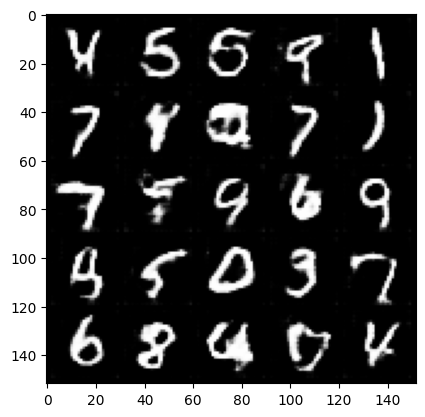

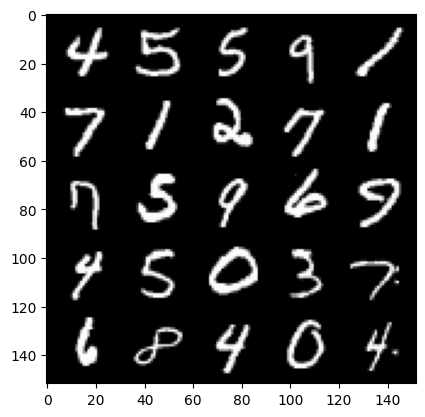

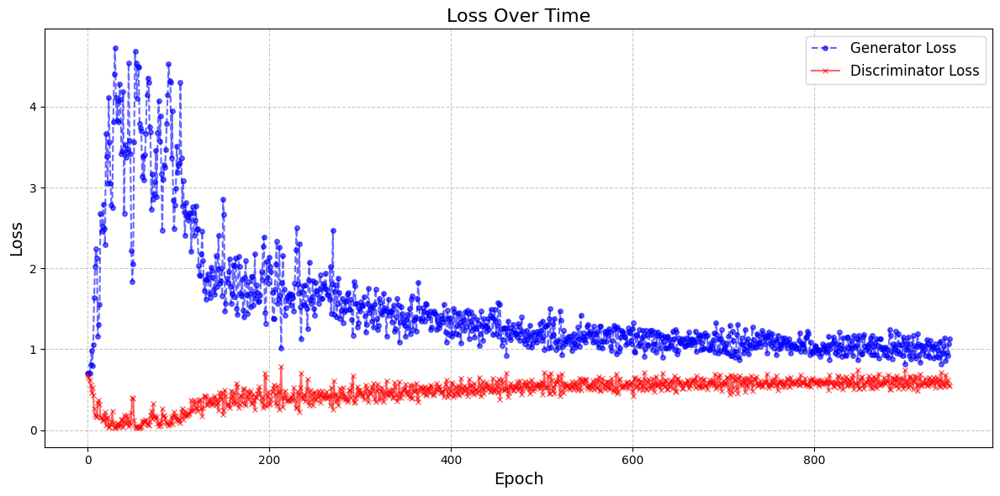

Saved best generator model with loss: 1.0007215051651002
**********************
Epoch number: 41
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 19500: Generator loss: 1.0120470093488694, discriminator loss: 0.600490631222725


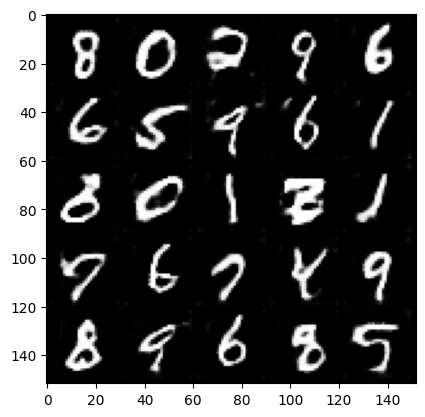

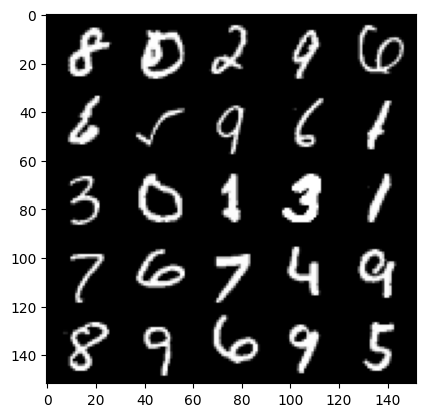

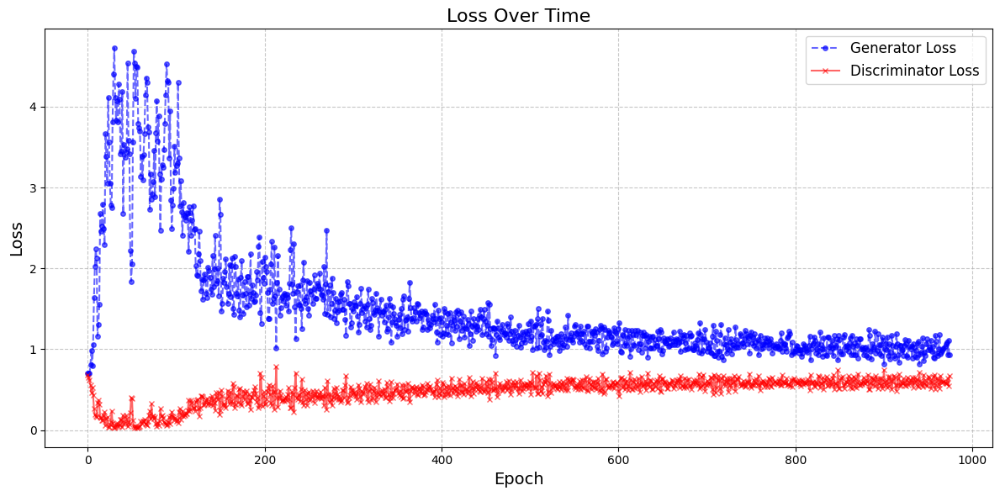

**********************
Epoch number: 42
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 20000: Generator loss: 1.0020088064670563, discriminator loss: 0.604472429215908


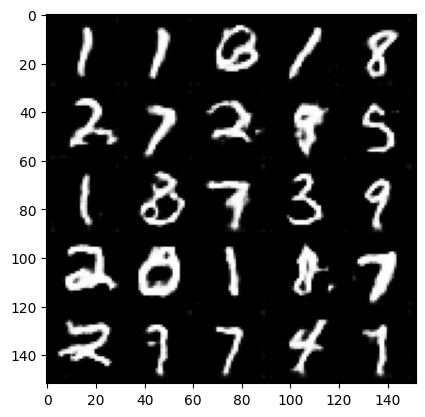

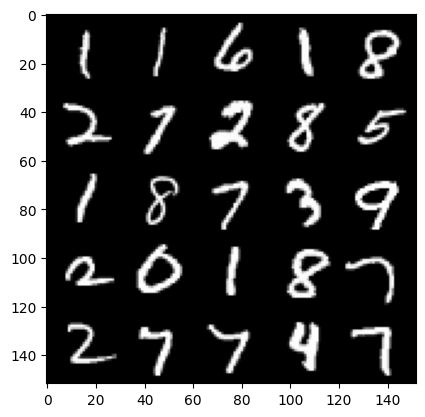

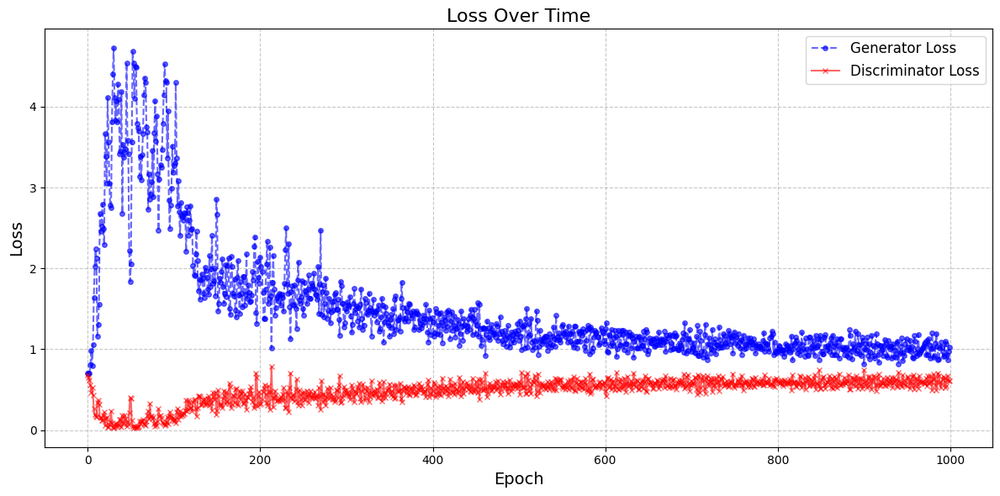

**********************
Epoch number: 43
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 20500: Generator loss: 1.0222908364534378, discriminator loss: 0.5980763059854507


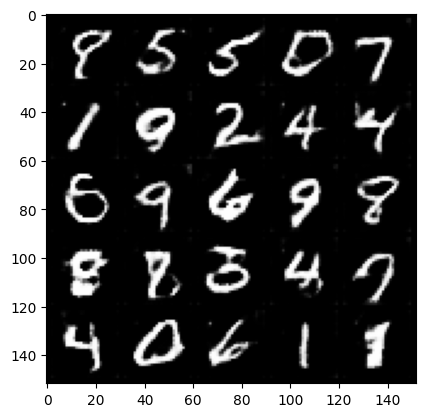

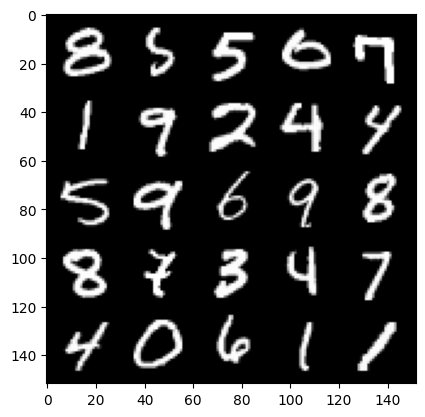

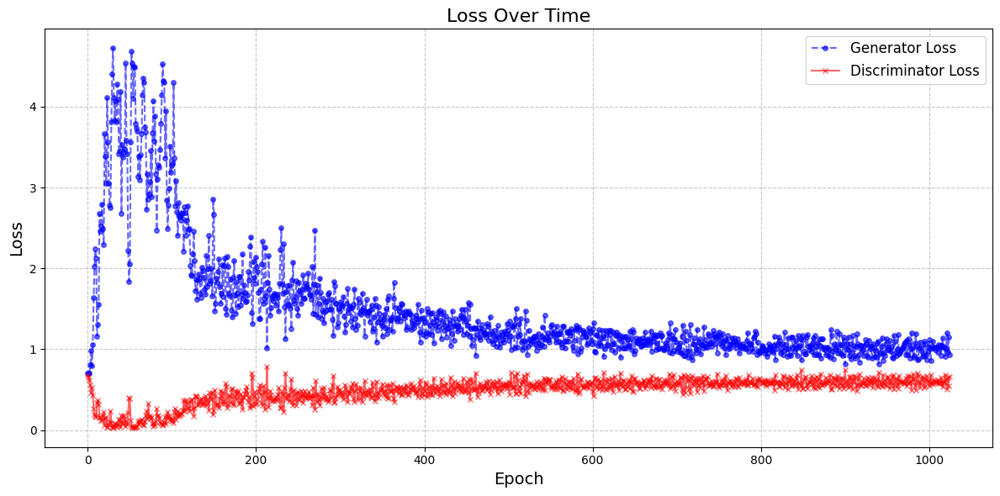

**********************
Epoch number: 44
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 21000: Generator loss: 0.9924214487075805, discriminator loss: 0.5978654204010964


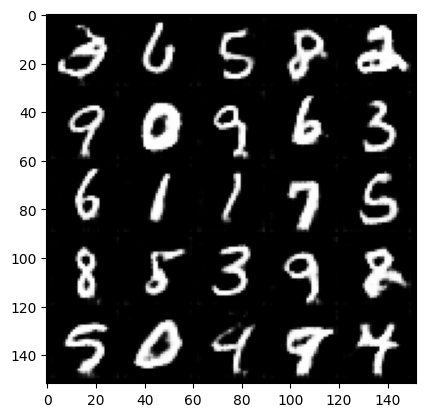

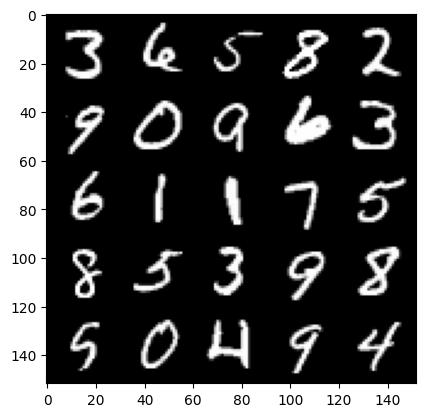

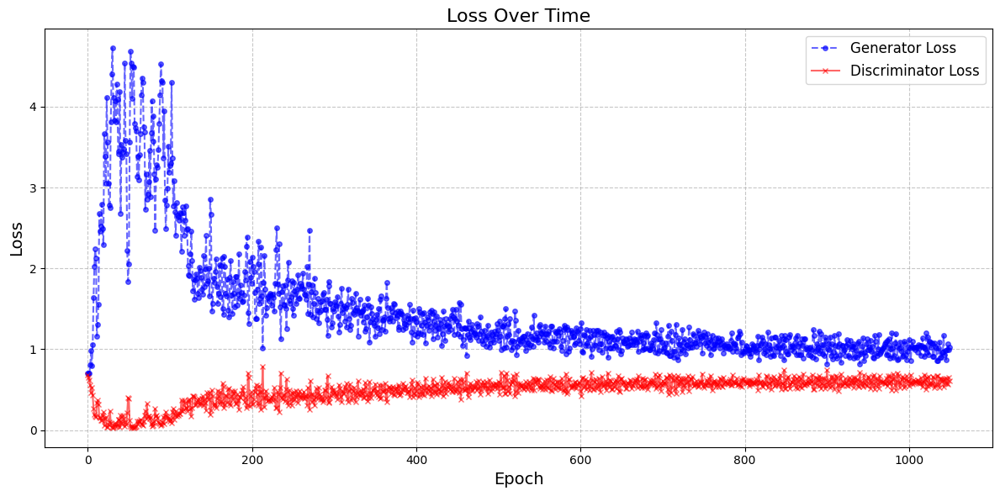

Saved best generator model with loss: 0.9848776561021805
**********************
Epoch number: 45
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 21500: Generator loss: 0.9893411170244217, discriminator loss: 0.6037663635015488


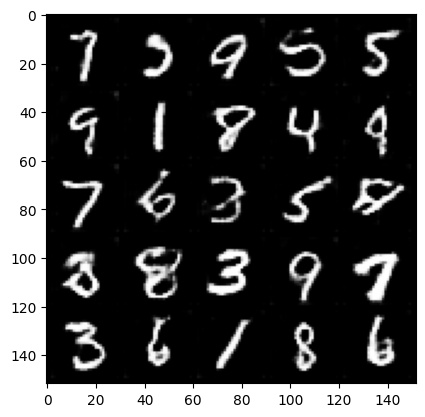

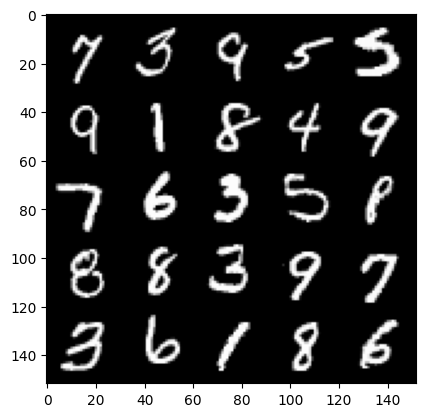

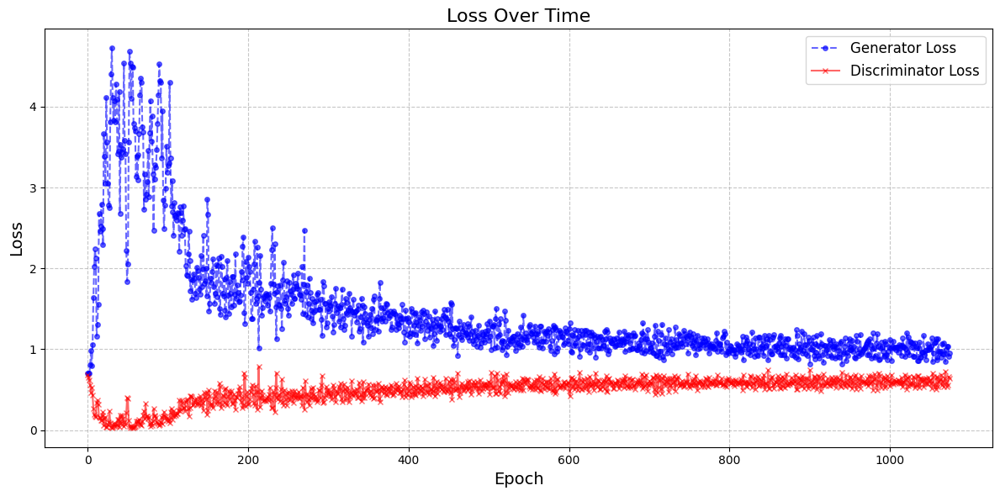

**********************
Epoch number: 46
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 22000: Generator loss: 0.9856097505092621, discriminator loss: 0.6036640954613686


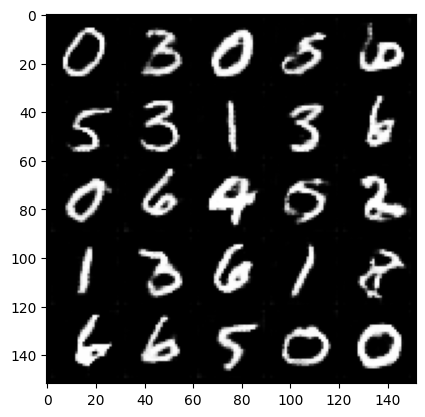

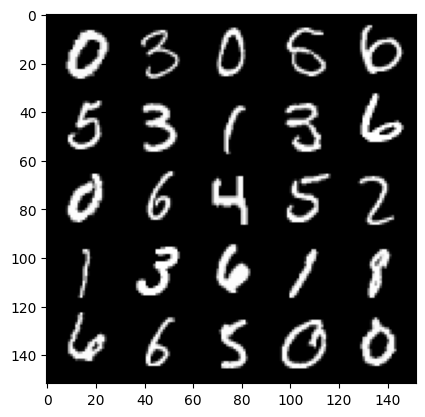

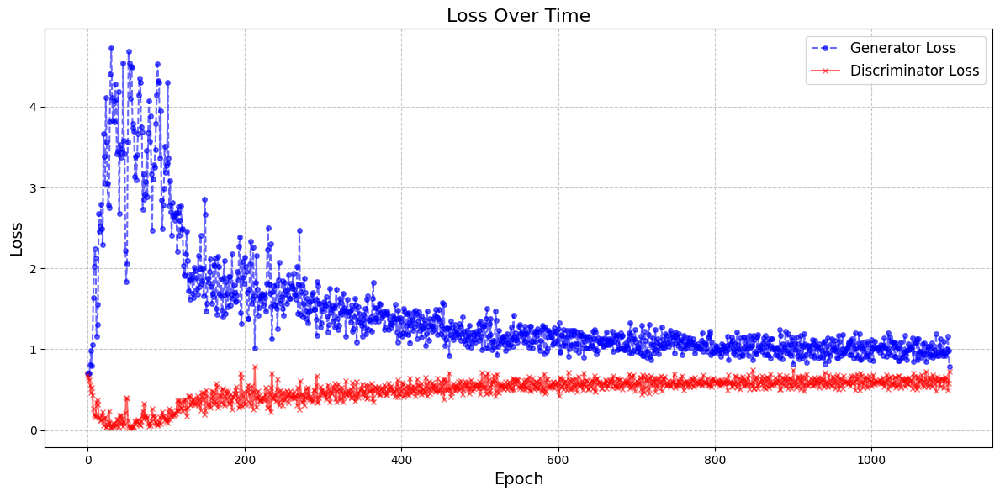

**********************
Epoch number: 47
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 22500: Generator loss: 0.9753310154676438, discriminator loss: 0.6052177243828774


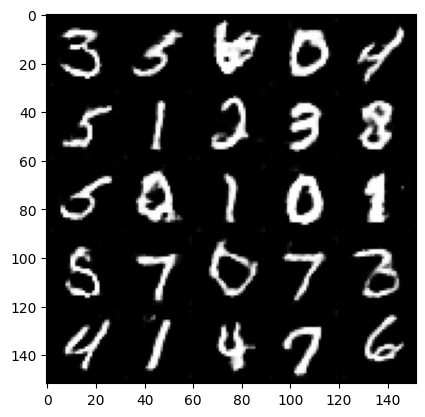

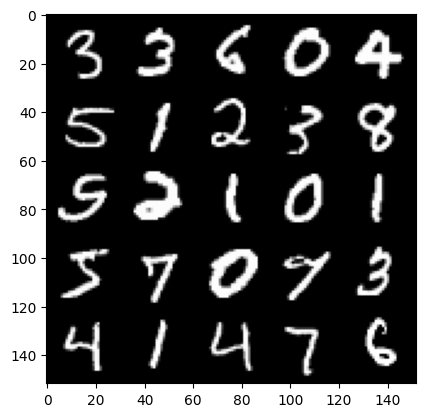

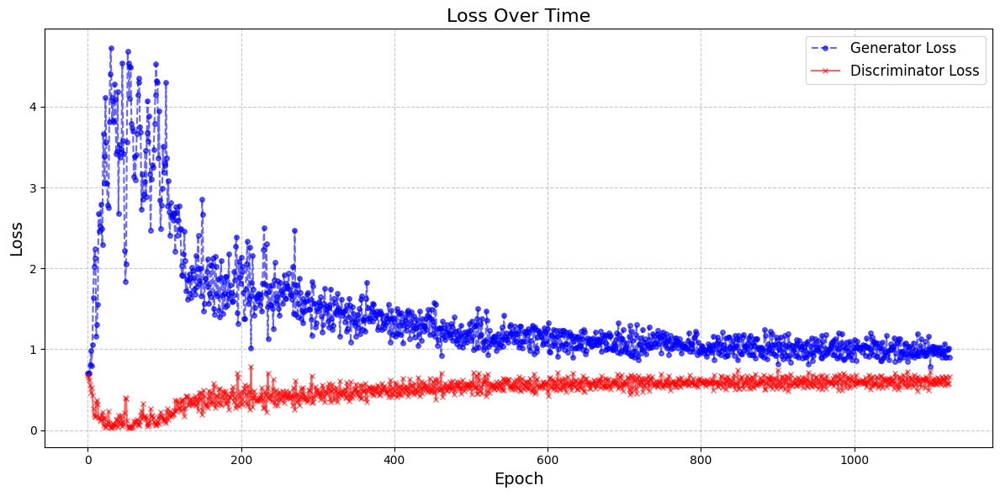

Saved best generator model with loss: 0.9724832383394242
**********************
Epoch number: 48
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Saved best generator model with loss: 0.954574700832367
**********************
Epoch number: 49
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 23000: Generator loss: 0.9587516976594925, discriminator loss: 0.605156093776226


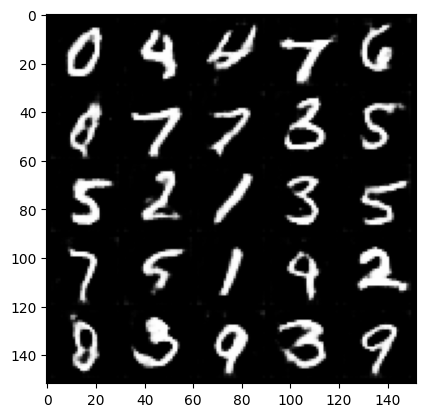

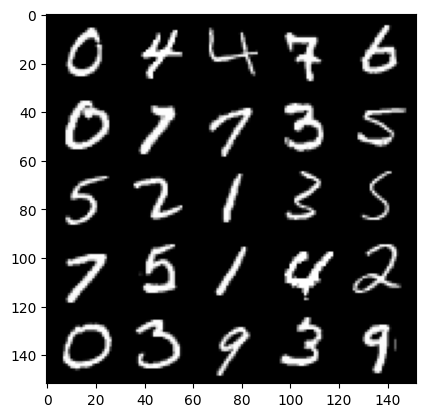

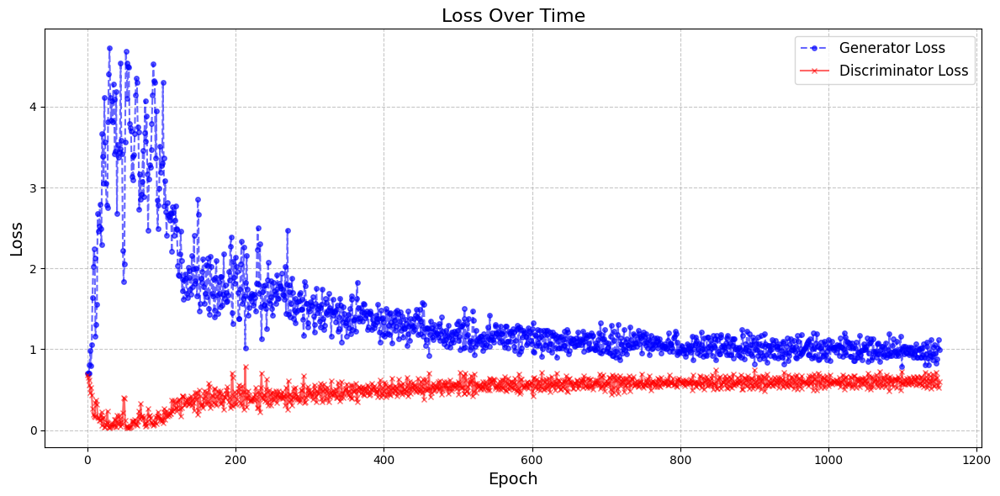

**********************
Epoch number: 50
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 23500: Generator loss: 0.9804098962545394, discriminator loss: 0.6057570508718491


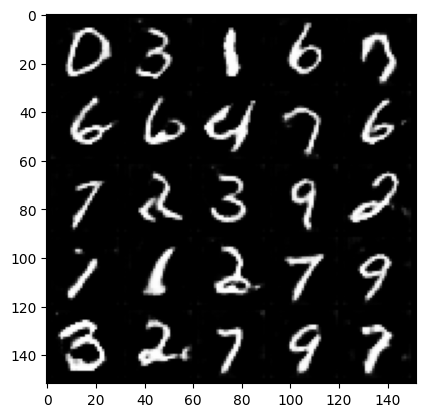

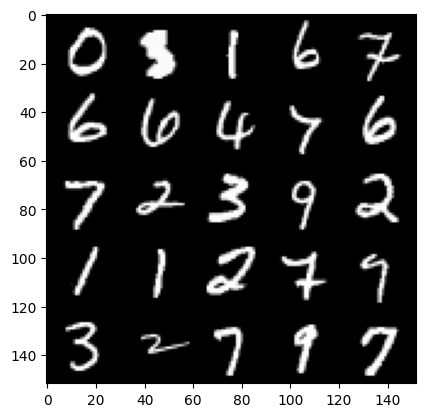

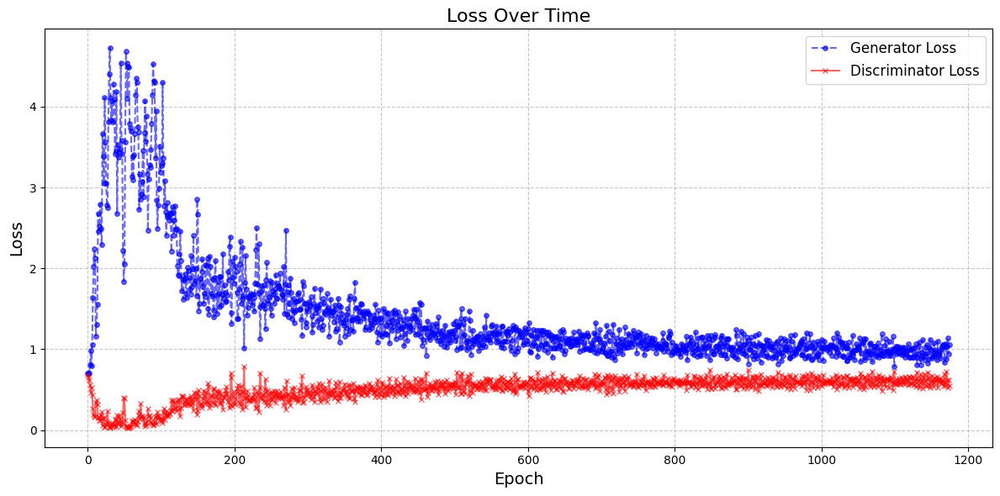

**********************
Epoch number: 51
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 24000: Generator loss: 0.9843892277479172, discriminator loss: 0.6093247549533845


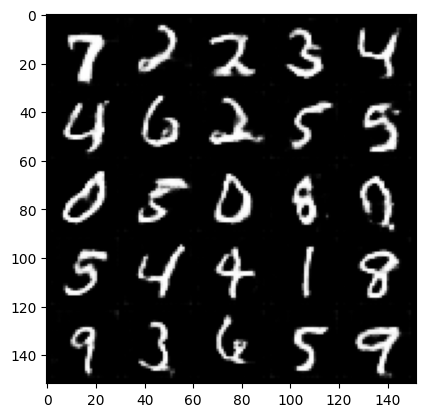

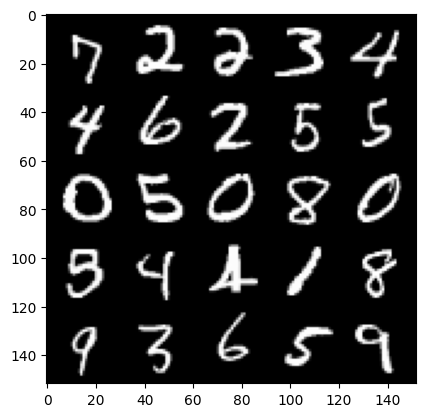

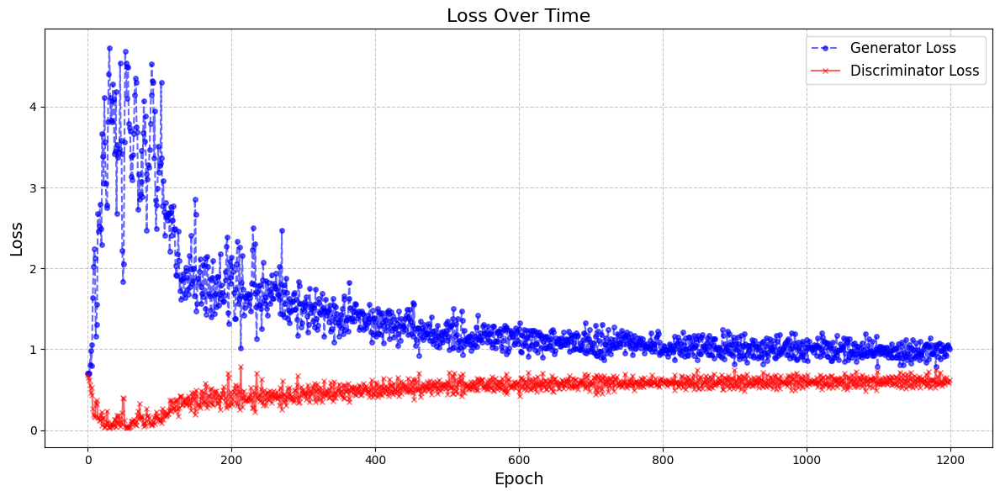

**********************
Epoch number: 52
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 24500: Generator loss: 0.9619898792505265, discriminator loss: 0.6120504537820816


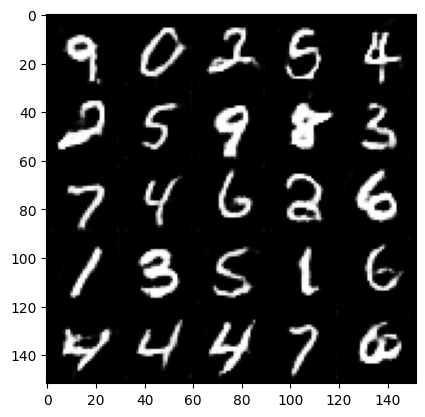

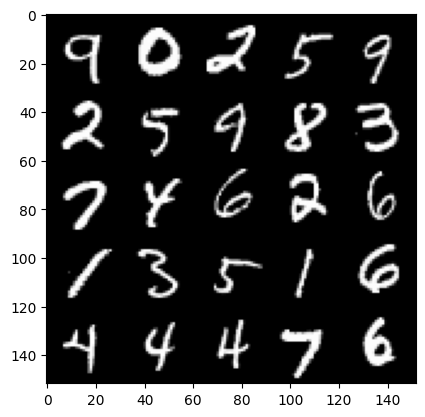

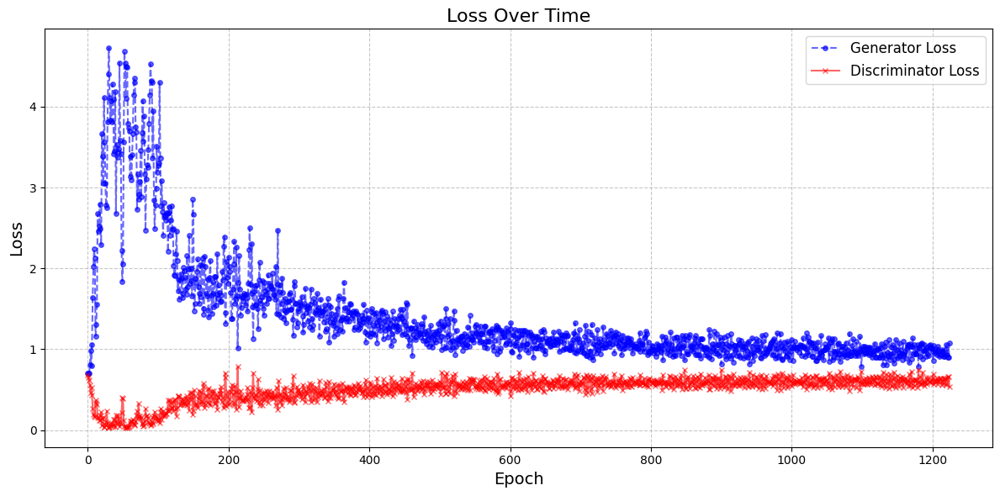

**********************
Epoch number: 53
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 25000: Generator loss: 0.9727745851278305, discriminator loss: 0.6126729564666749


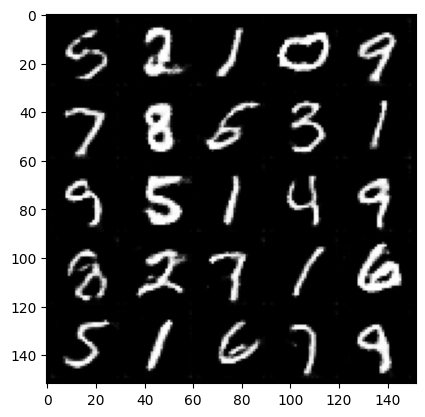

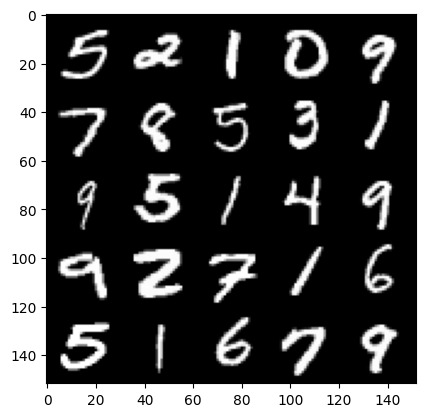

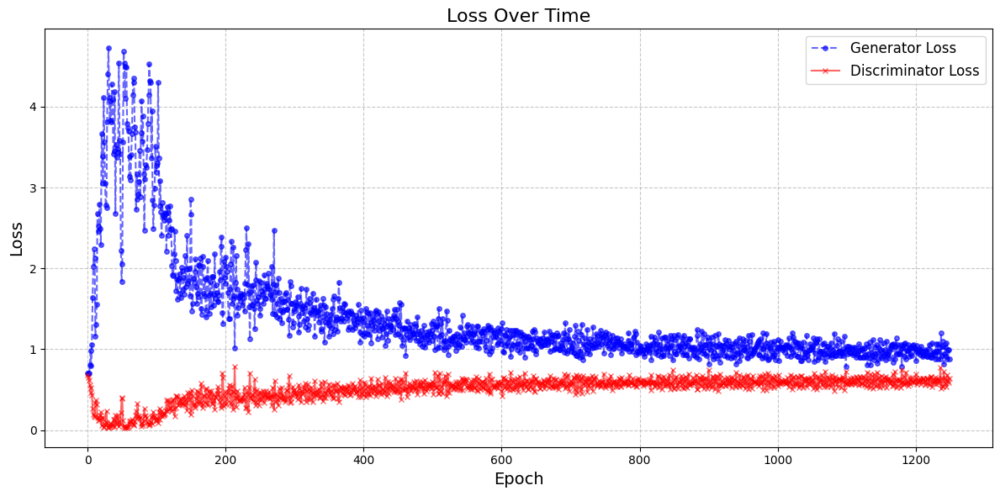

Saved best generator model with loss: 0.9469898289442062
**********************
Epoch number: 54
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 25500: Generator loss: 0.94544943857193, discriminator loss: 0.6126275065541268


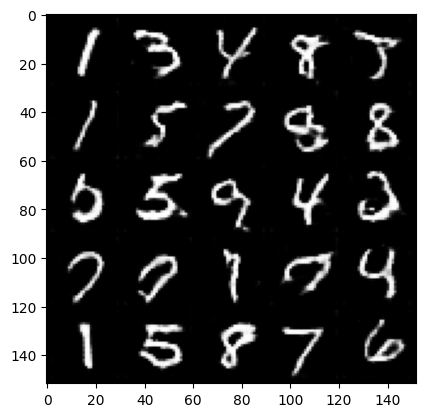

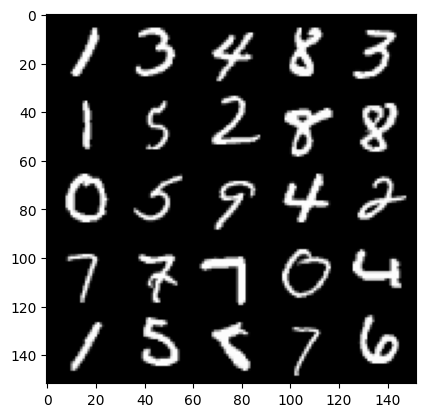

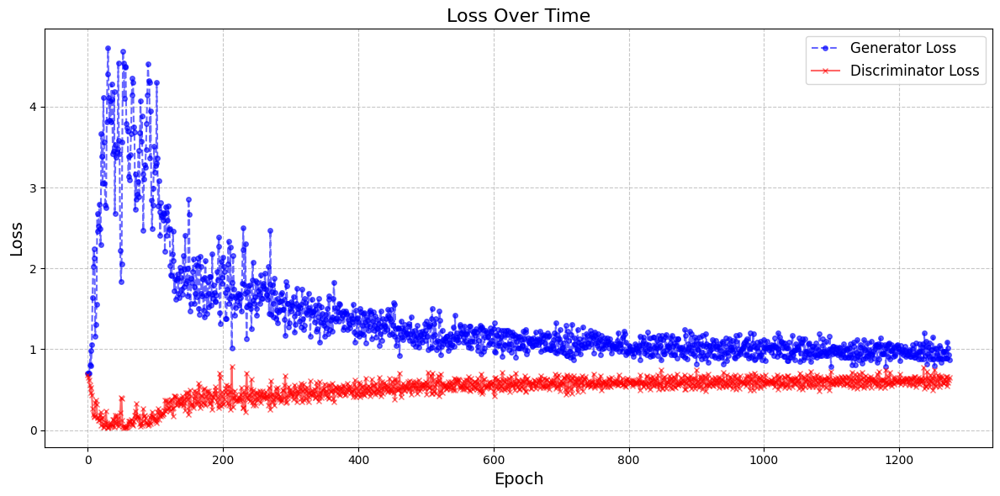

**********************
Epoch number: 55
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 26000: Generator loss: 0.9904966901540756, discriminator loss: 0.6035433612465858


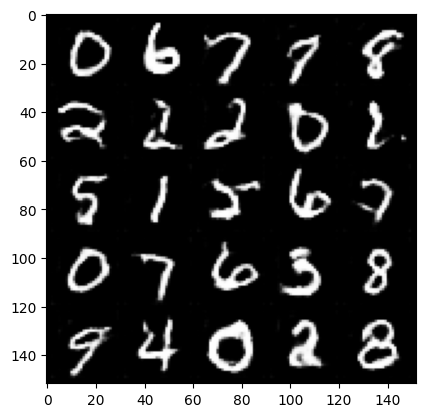

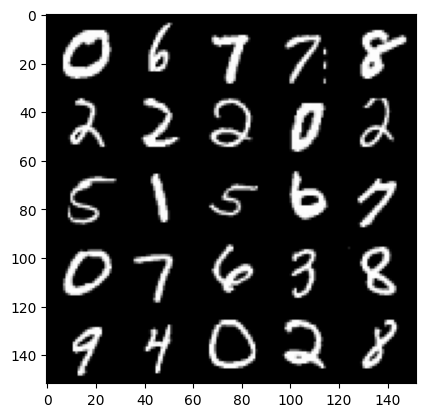

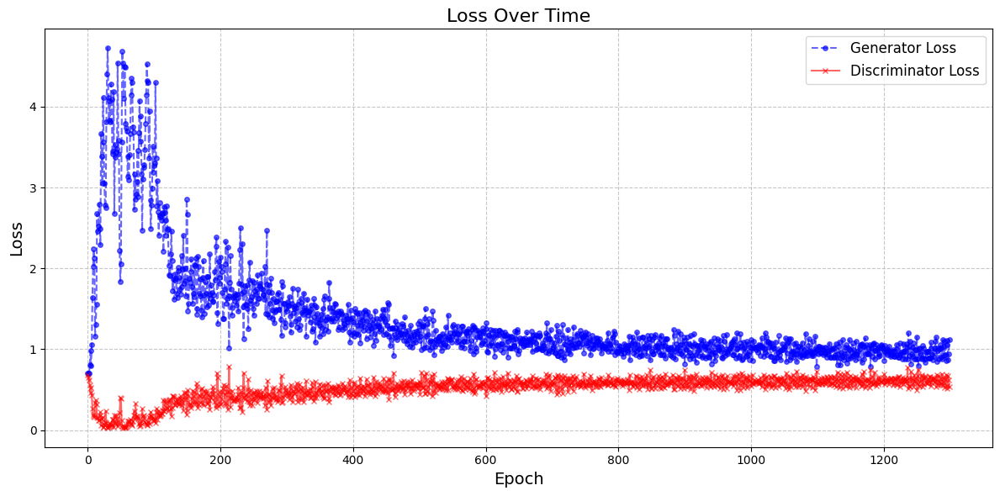

**********************
Epoch number: 56
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 26500: Generator loss: 0.9495184115171432, discriminator loss: 0.6081084347367287


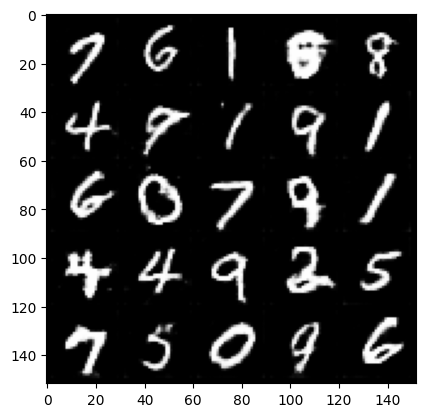

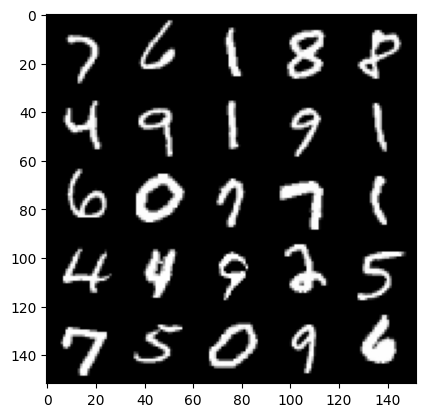

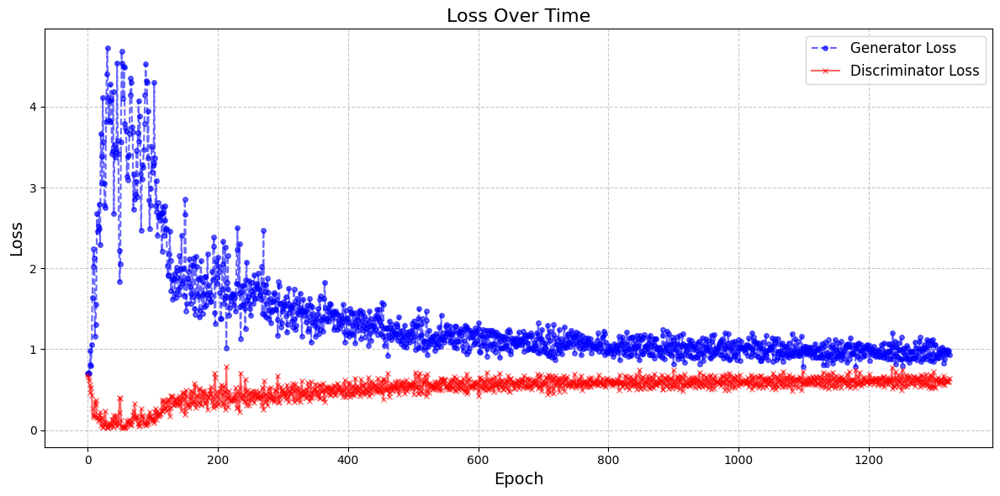

**********************
Epoch number: 57
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 27000: Generator loss: 0.9624717602729798, discriminator loss: 0.6105473062992096


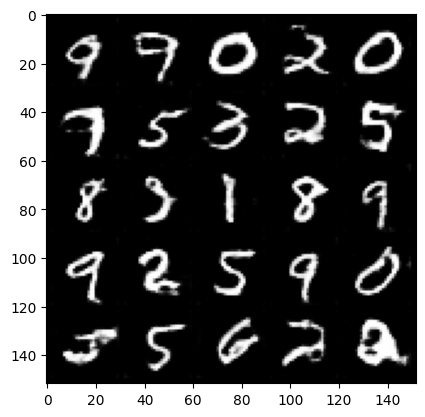

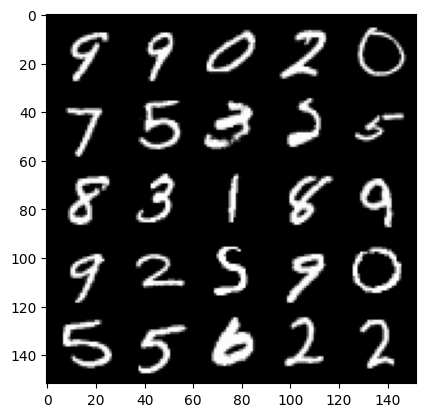

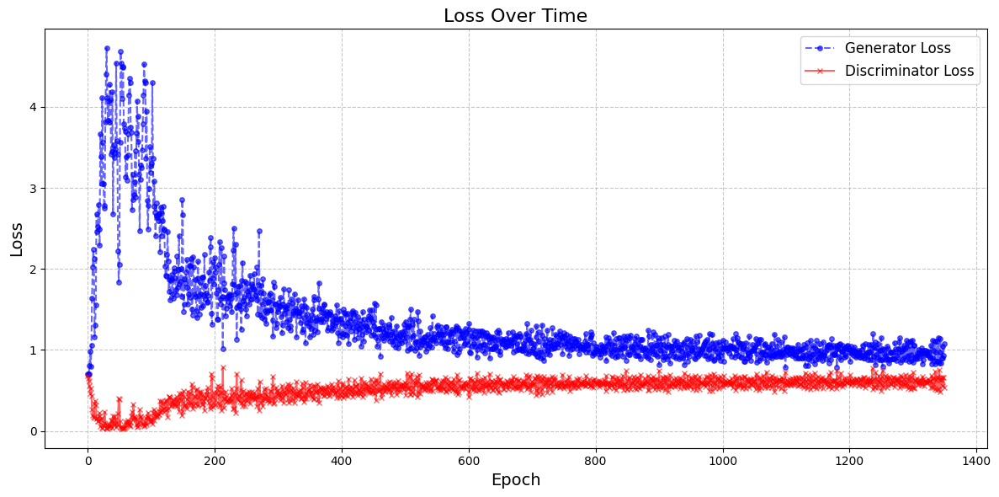

**********************
Epoch number: 58
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 27500: Generator loss: 0.9466735329627991, discriminator loss: 0.6118942863941192


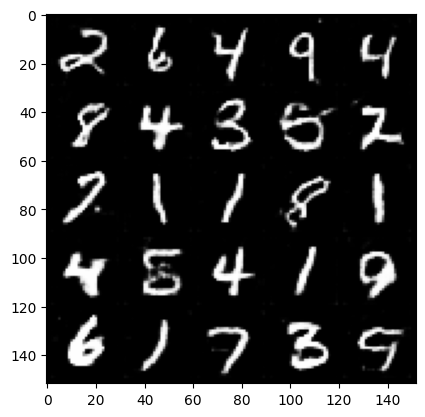

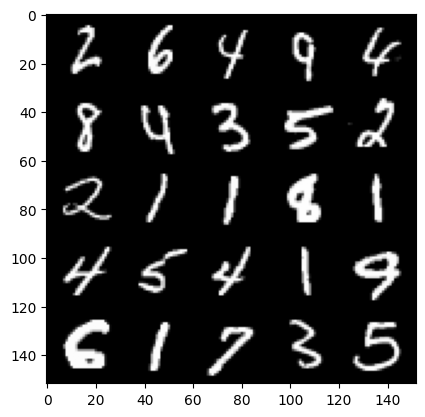

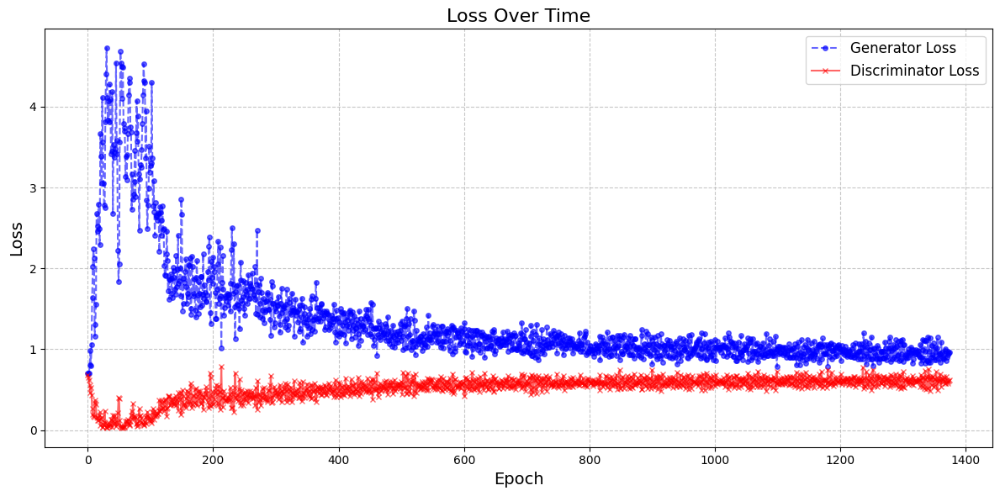

Saved best generator model with loss: 0.9358192163705826
**********************
Epoch number: 59
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 28000: Generator loss: 0.9451170004606247, discriminator loss: 0.6138832931518554


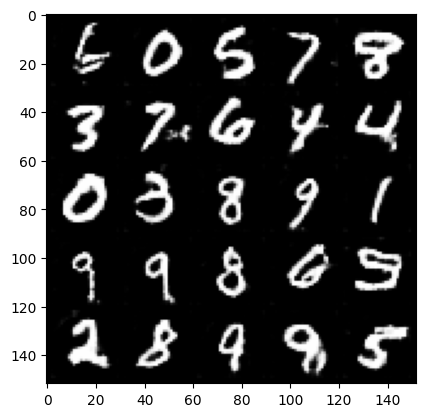

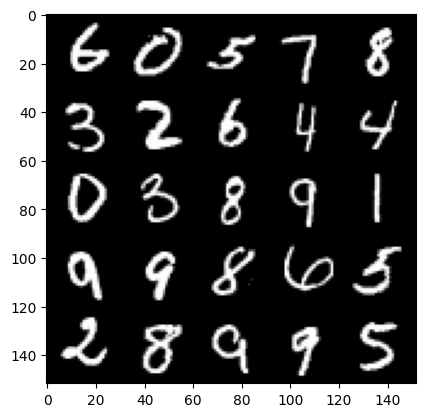

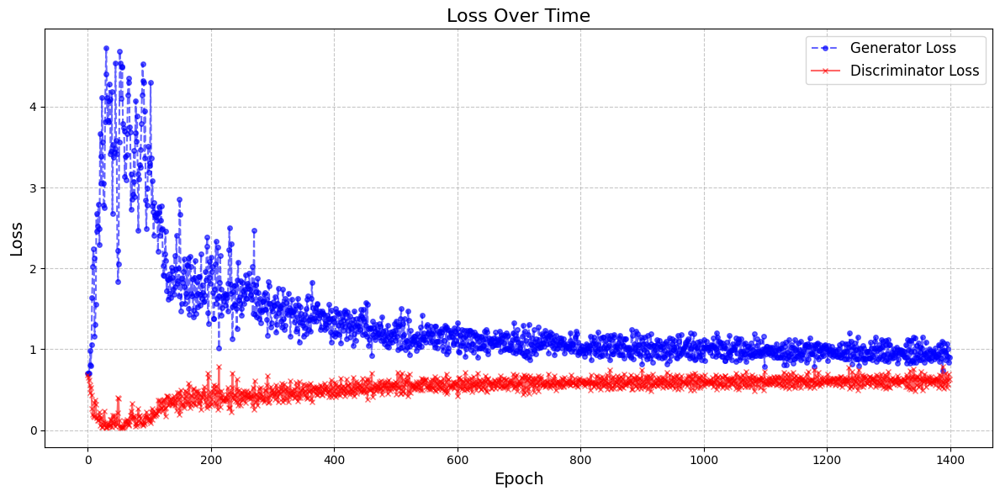

**********************
Epoch number: 60
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 28500: Generator loss: 0.9554066751003265, discriminator loss: 0.6125791145563125


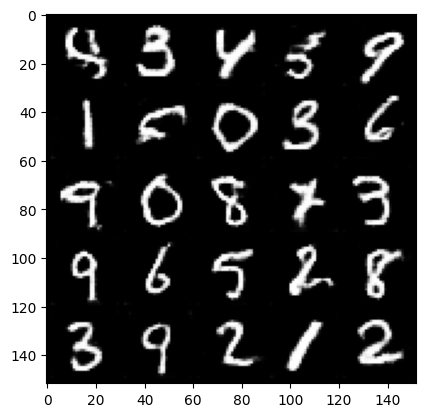

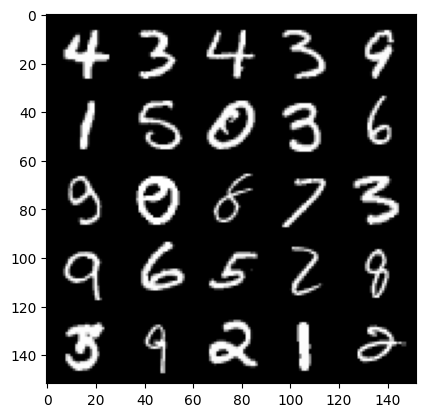

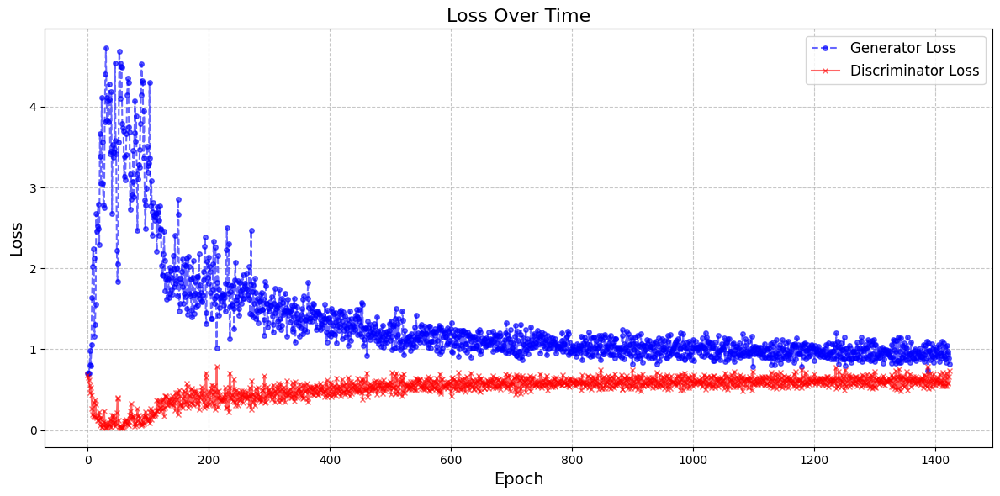

**********************
Epoch number: 61
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 29000: Generator loss: 0.9292397841215133, discriminator loss: 0.6086476674675941


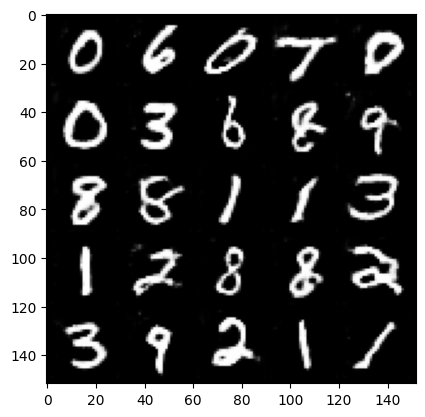

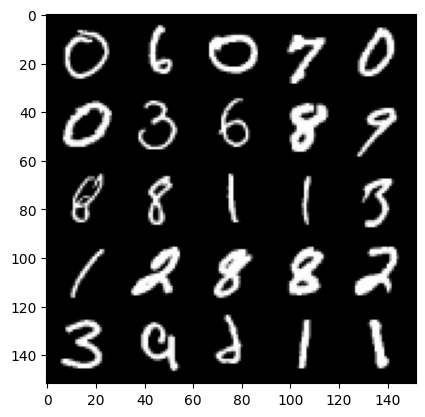

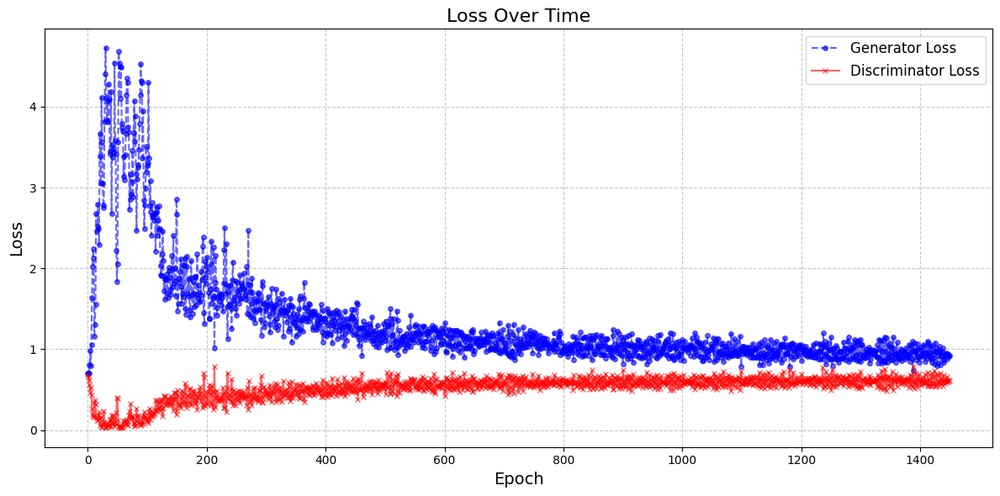

Saved best generator model with loss: 0.9196845723390579
**********************
Epoch number: 62
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 29500: Generator loss: 0.9412650636434555, discriminator loss: 0.6164614695310593


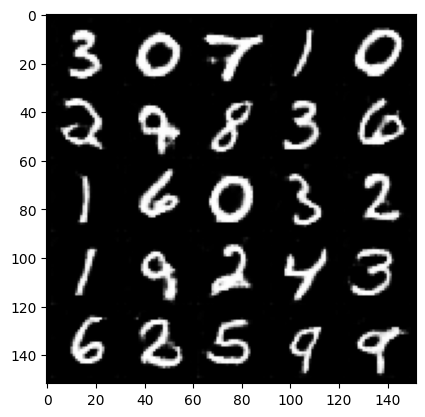

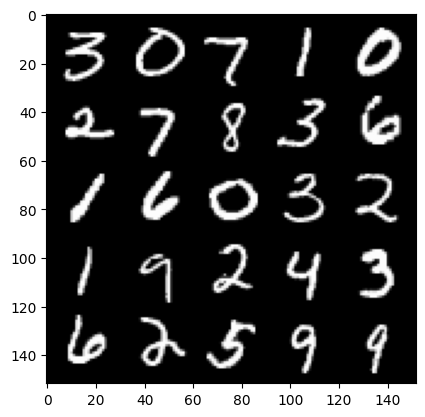

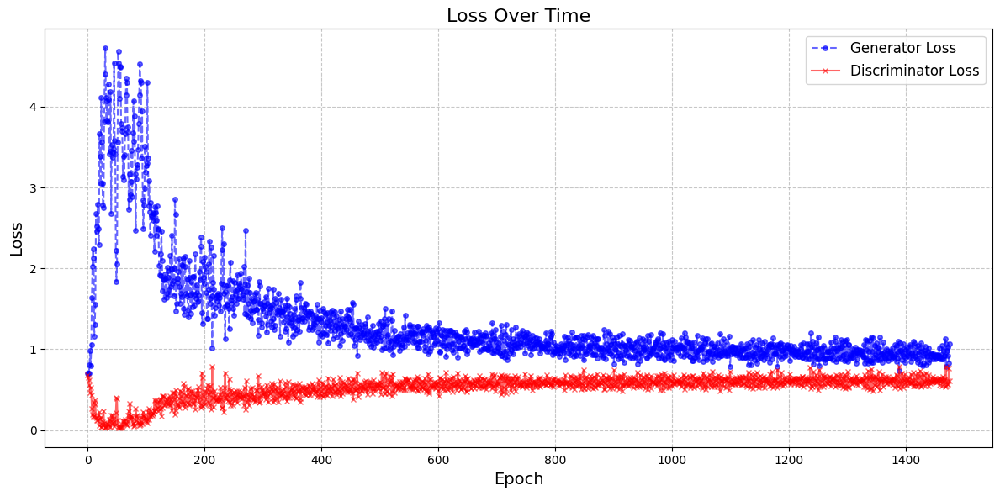

**********************
Epoch number: 63
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 30000: Generator loss: 0.9369208568334579, discriminator loss: 0.6172417224049568


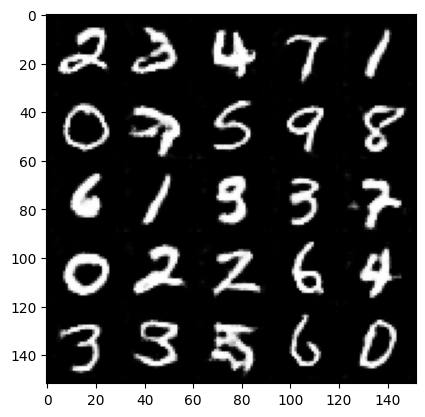

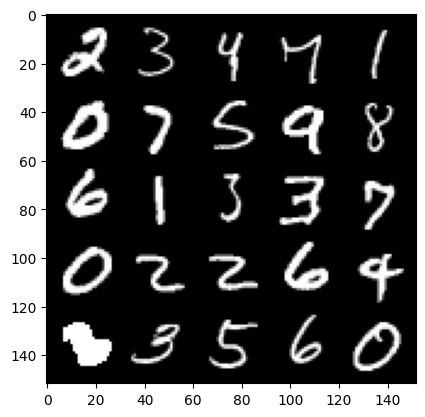

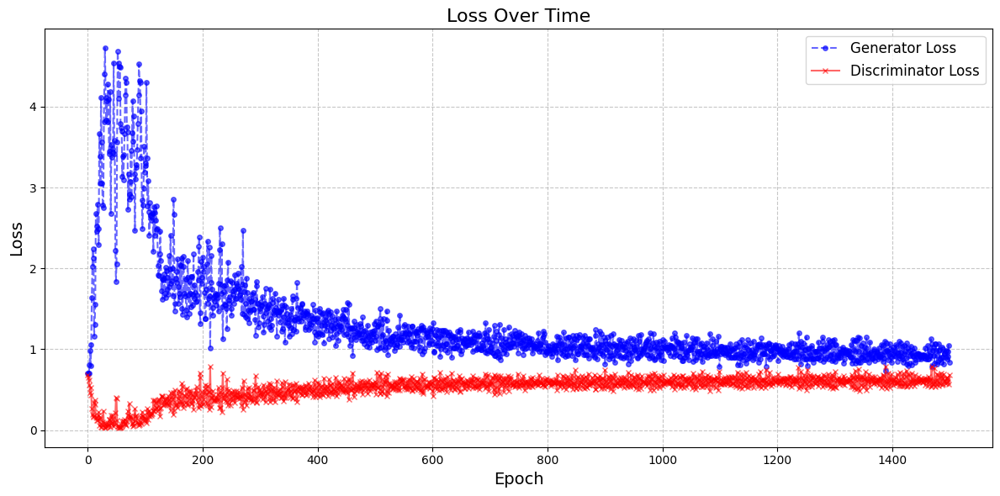

**********************
Epoch number: 64
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

**********************
Epoch number: 65
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 30500: Generator loss: 0.9388135094642639, discriminator loss: 0.6144478635787964


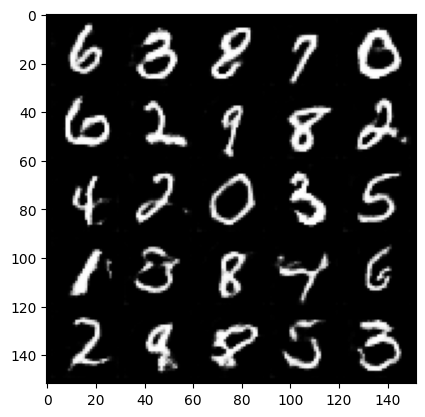

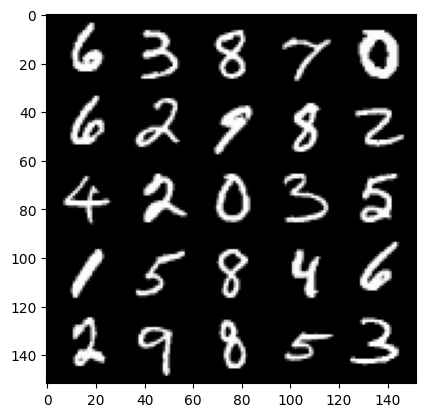

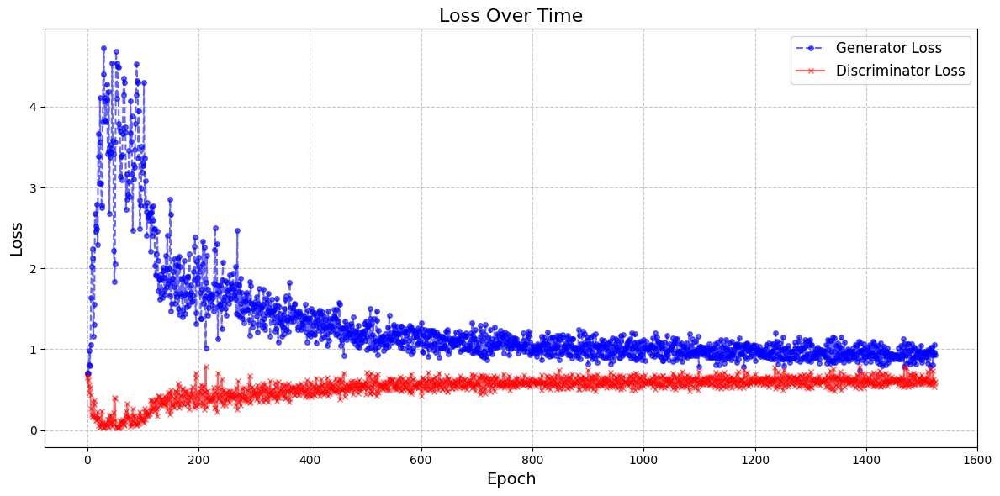

**********************
Epoch number: 66
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 31000: Generator loss: 0.9484632971286774, discriminator loss: 0.6152255824208259


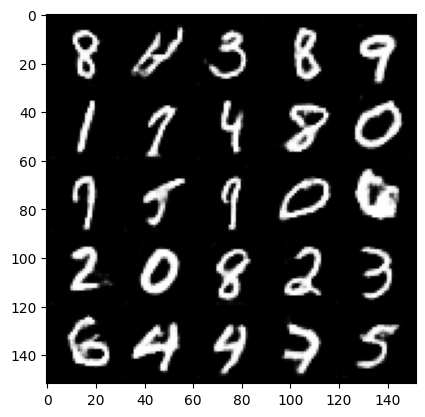

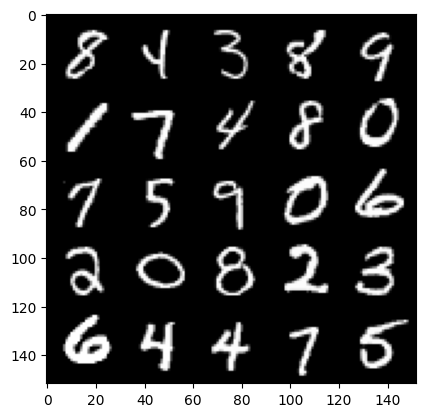

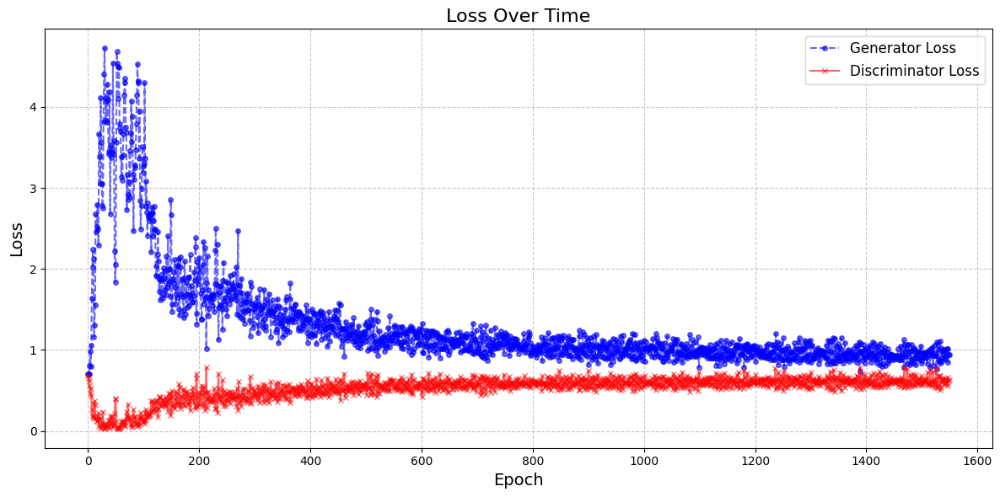

**********************
Epoch number: 67
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 31500: Generator loss: 0.967156771659851, discriminator loss: 0.6140926620364189


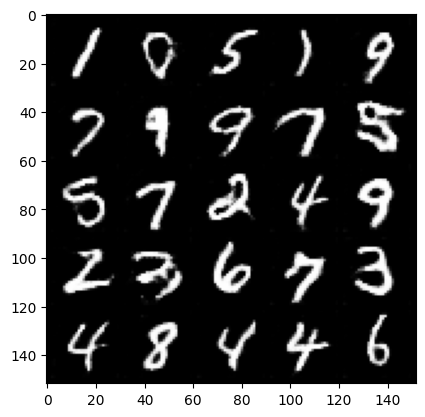

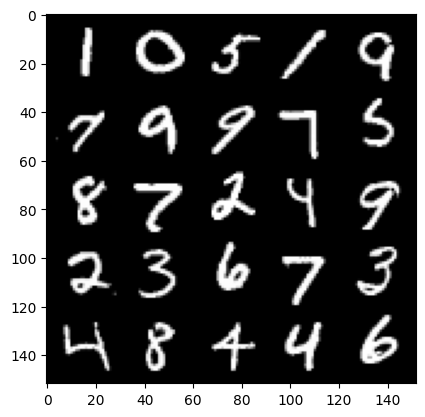

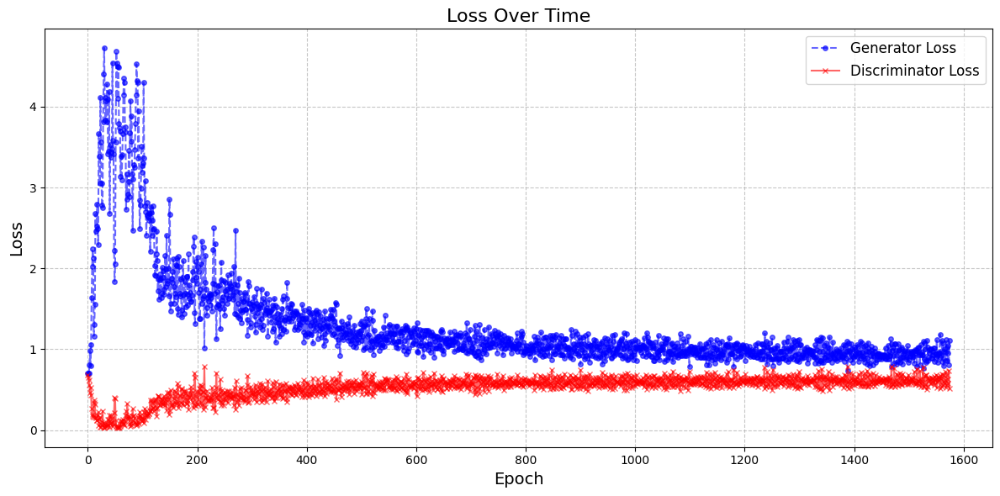

**********************
Epoch number: 68
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 32000: Generator loss: 0.9400783897638321, discriminator loss: 0.6111651329994202


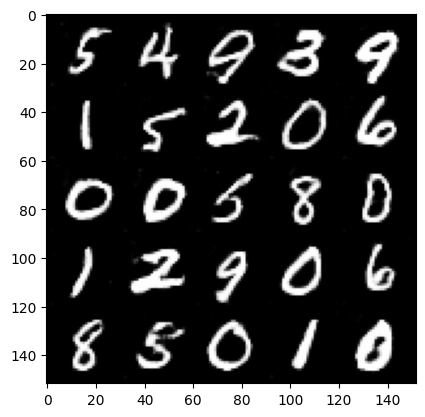

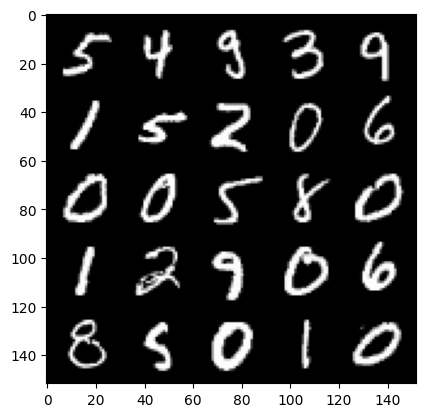

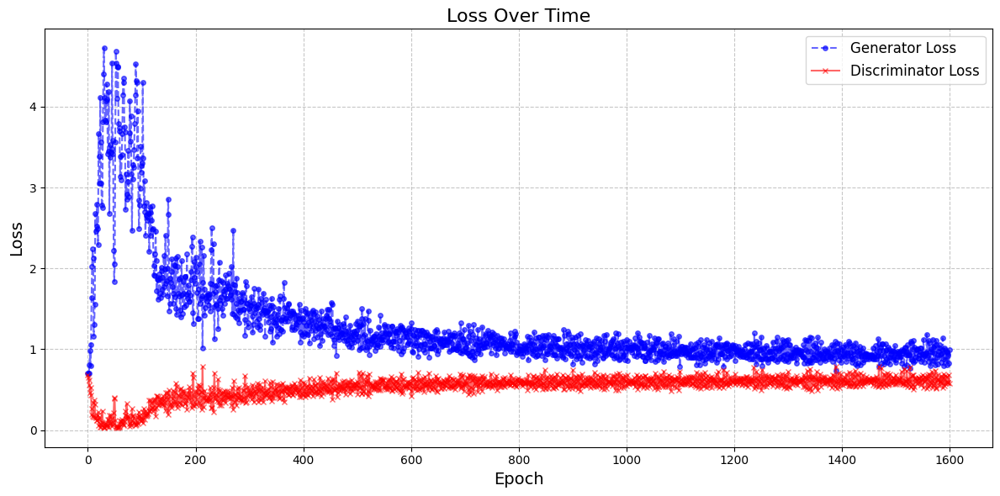

**********************
Epoch number: 69
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 32500: Generator loss: 0.9320500408411025, discriminator loss: 0.6153161038756371


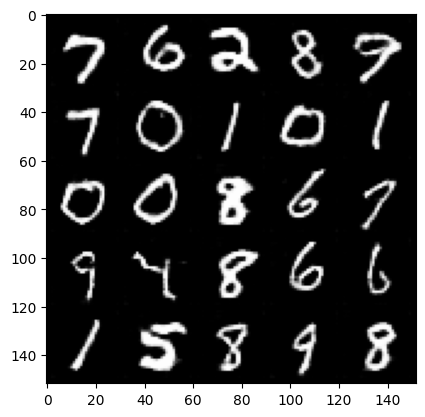

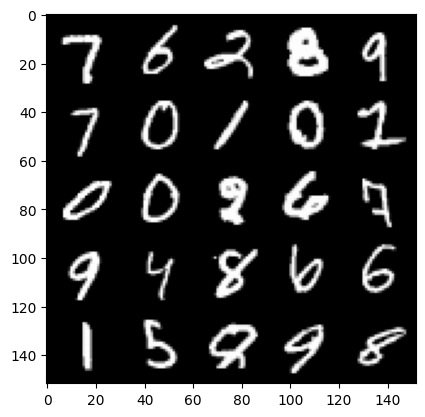

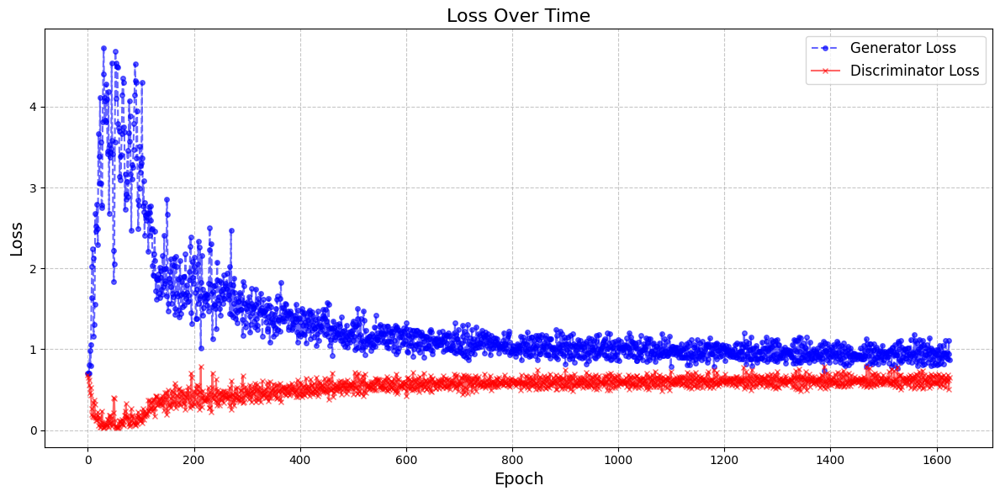

**********************
Epoch number: 70
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 33000: Generator loss: 0.9475671085119247, discriminator loss: 0.6174180483222008


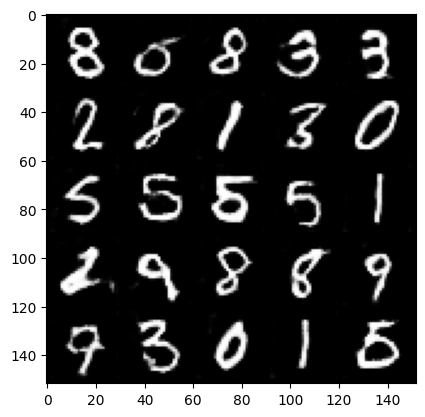

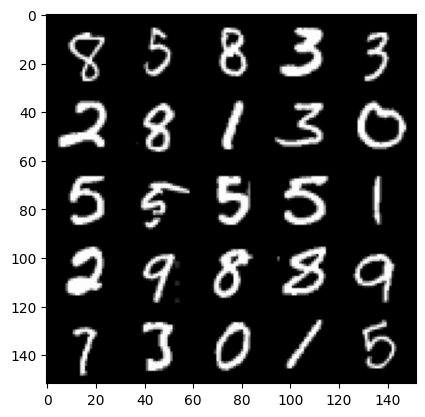

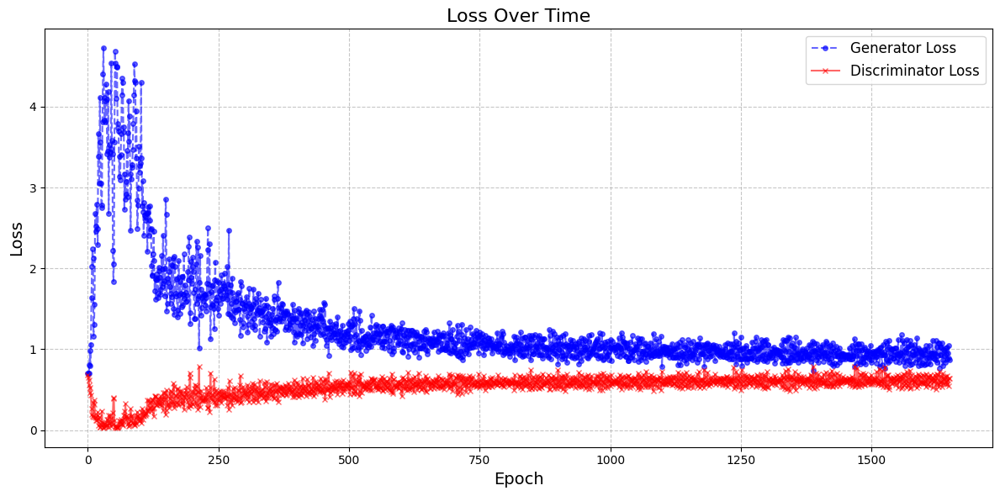

**********************
Epoch number: 71
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 33500: Generator loss: 0.9552334461212159, discriminator loss: 0.6147382872104645


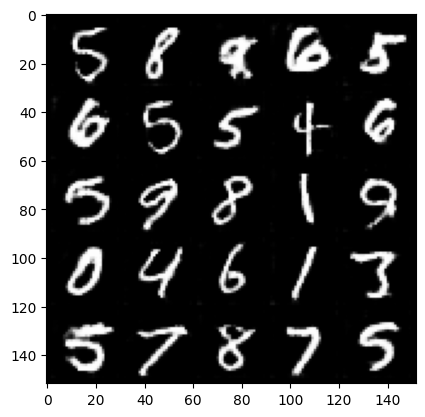

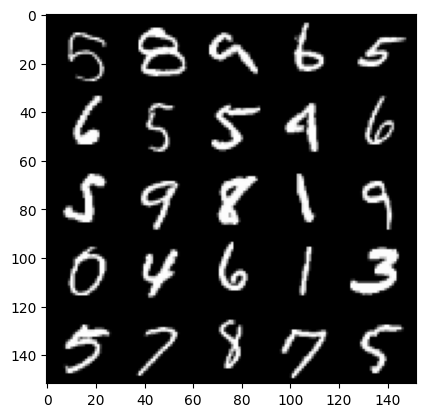

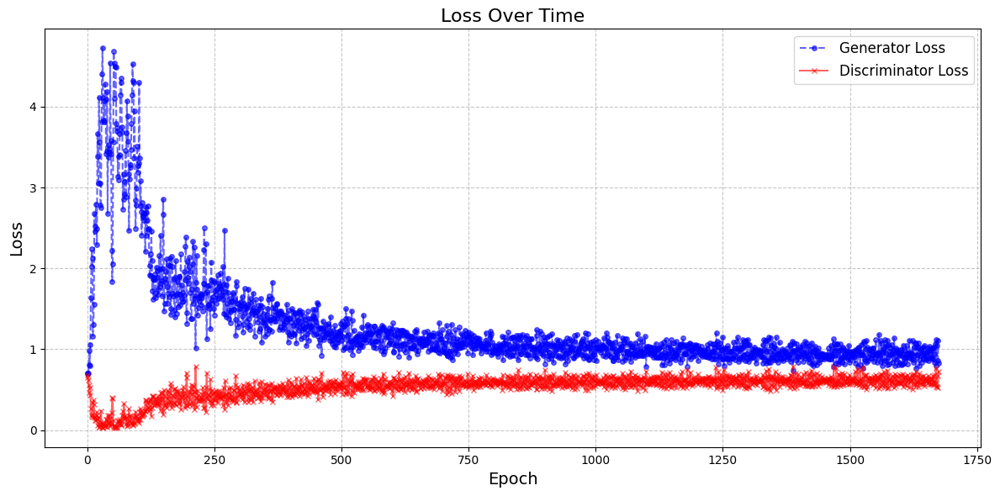

**********************
Epoch number: 72
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 34000: Generator loss: 0.9420278514623642, discriminator loss: 0.611550661444664


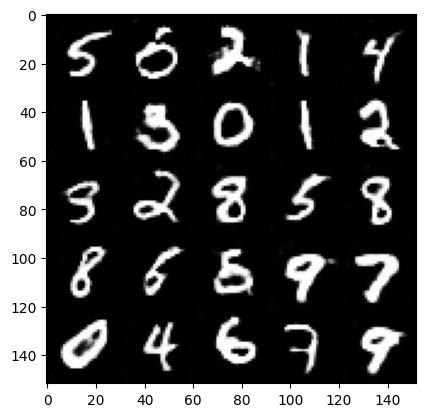

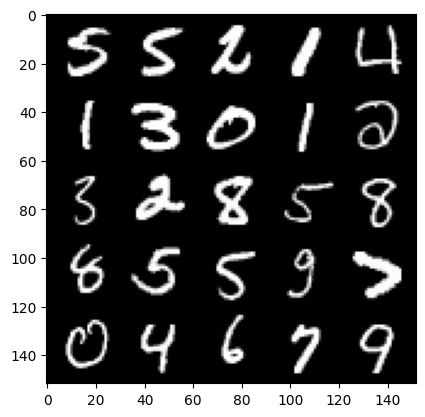

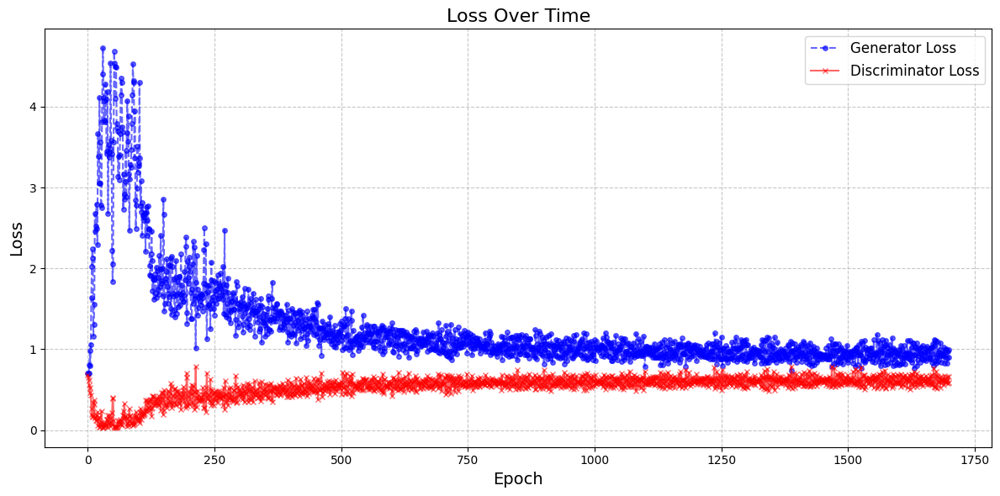

**********************
Epoch number: 73
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 34500: Generator loss: 0.9375426384210587, discriminator loss: 0.6087327503561973


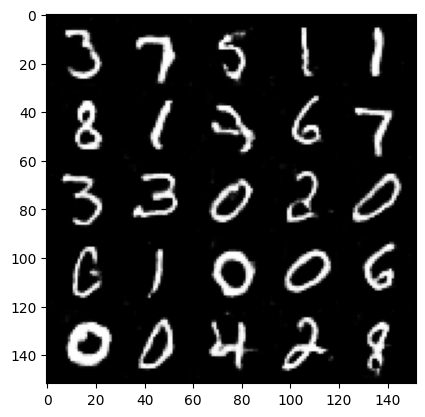

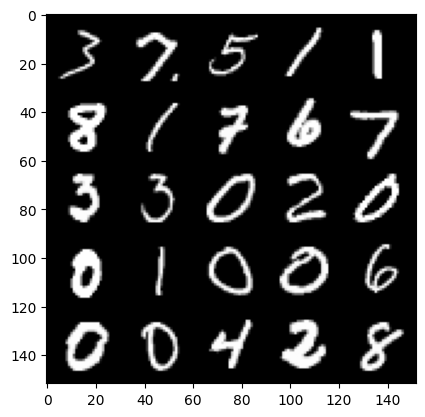

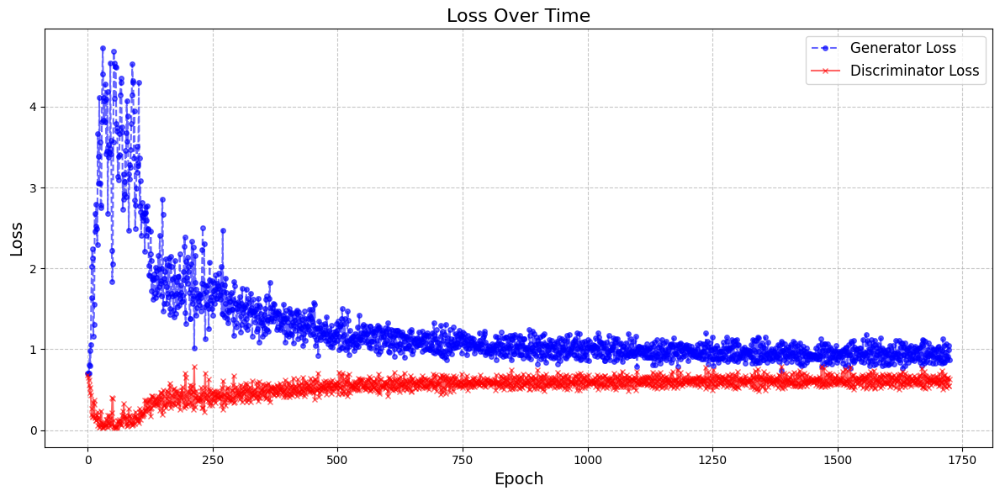

**********************
Epoch number: 74
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 35000: Generator loss: 0.937935450553894, discriminator loss: 0.6147916961908341


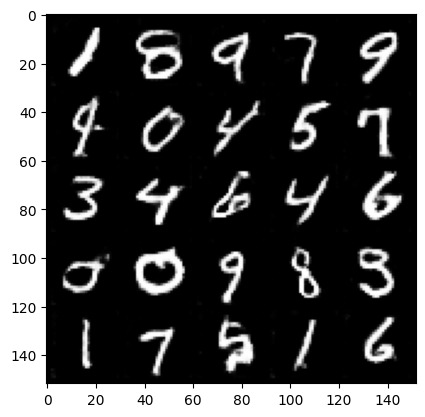

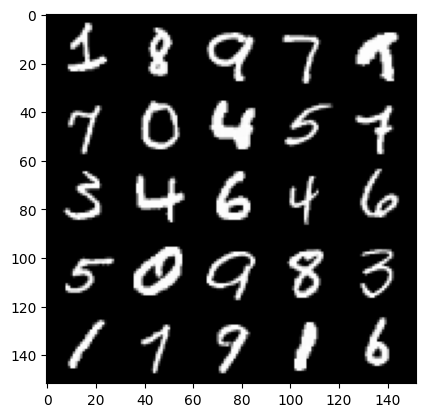

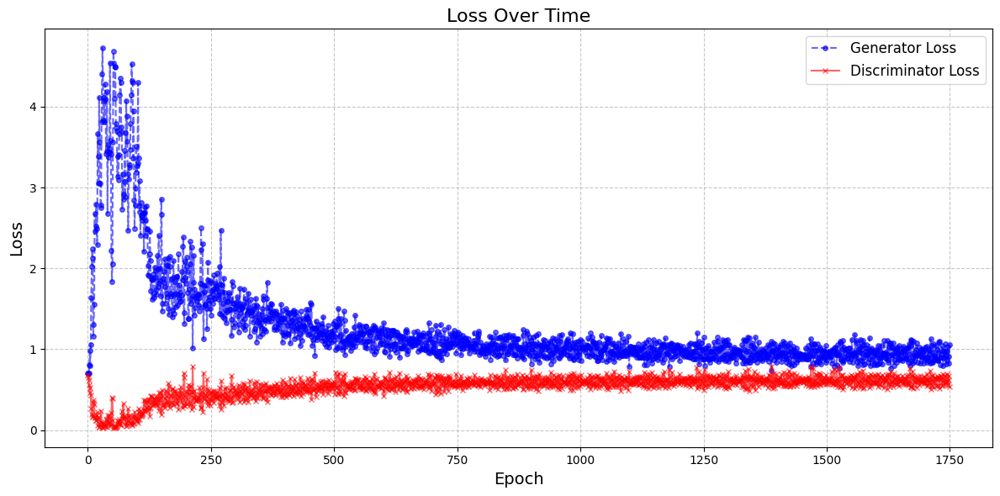

**********************
Epoch number: 75
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 35500: Generator loss: 0.9478854937553406, discriminator loss: 0.6174760724306106


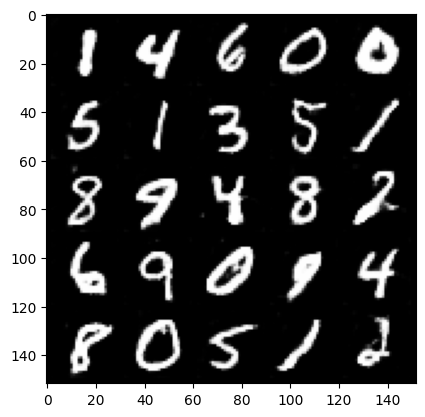

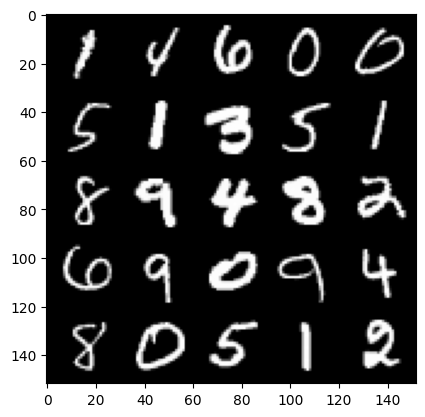

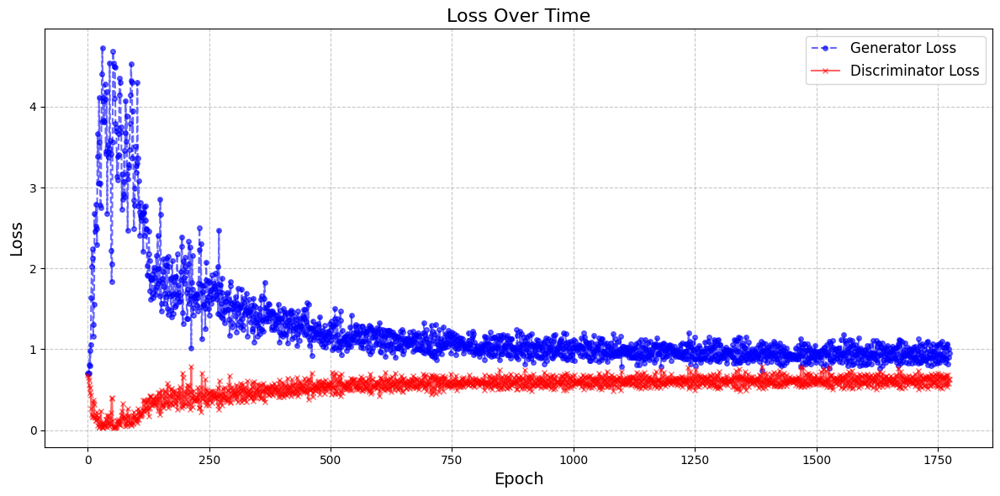

**********************
Epoch number: 76
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 36000: Generator loss: 0.9508758729696274, discriminator loss: 0.6113475850224495


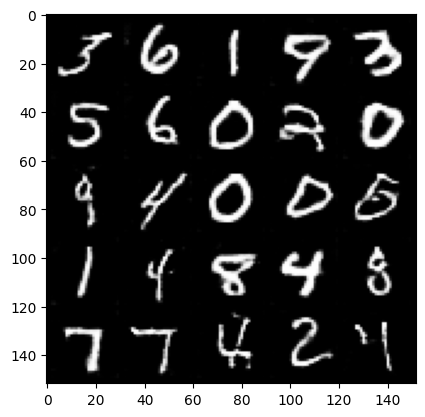

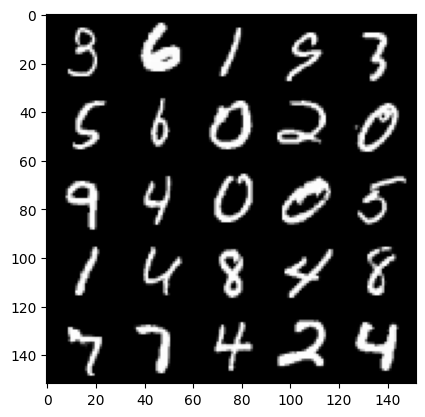

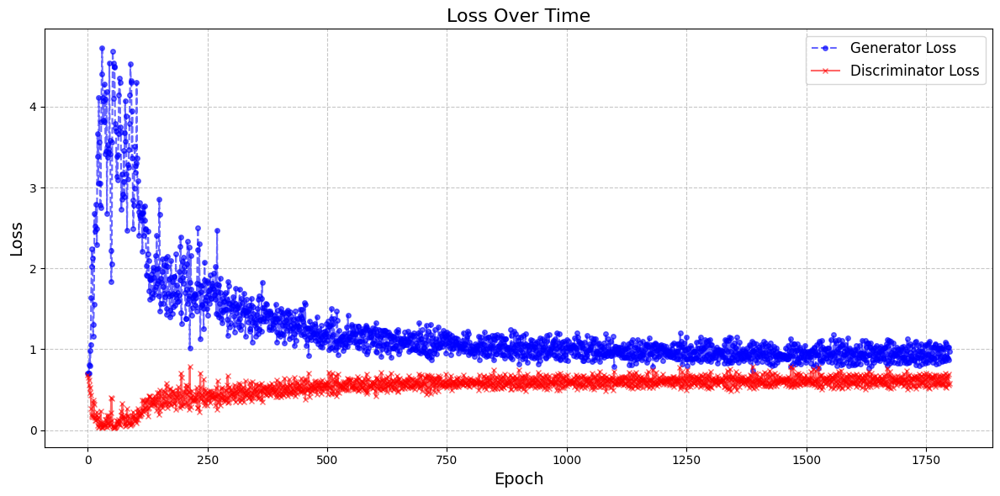

**********************
Epoch number: 77
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 36500: Generator loss: 0.942867338180542, discriminator loss: 0.613212870657444


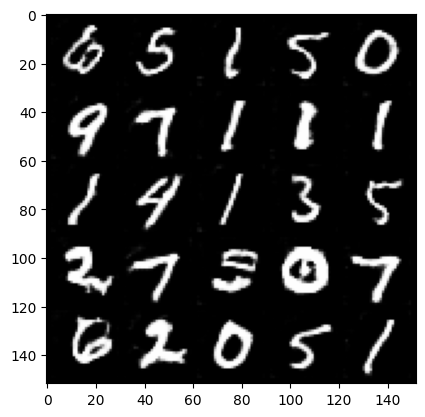

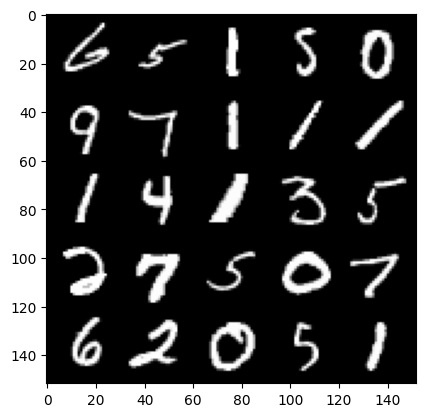

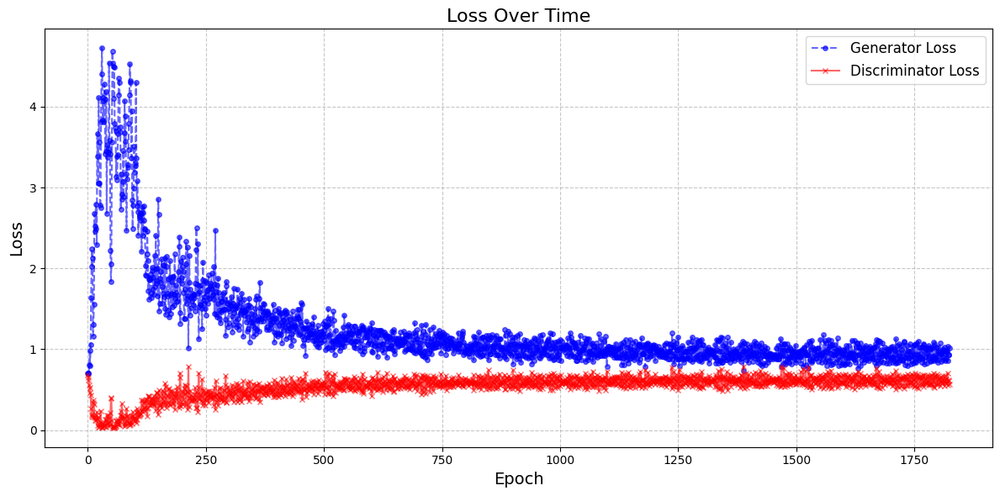

**********************
Epoch number: 78
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 37000: Generator loss: 0.9399499598741531, discriminator loss: 0.6159575213193893


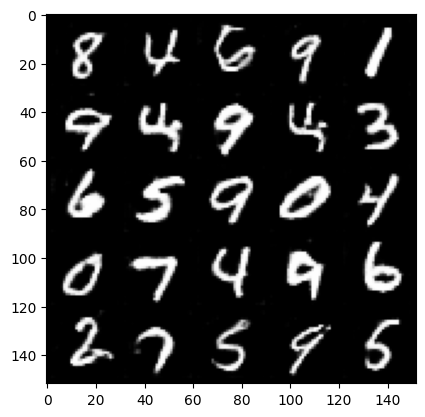

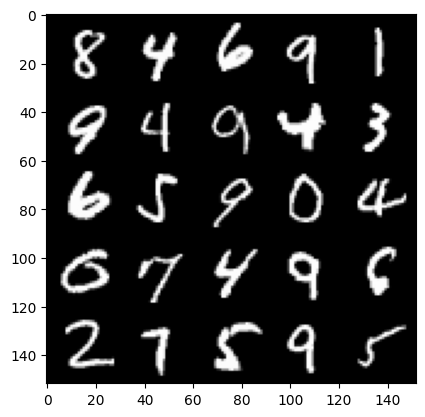

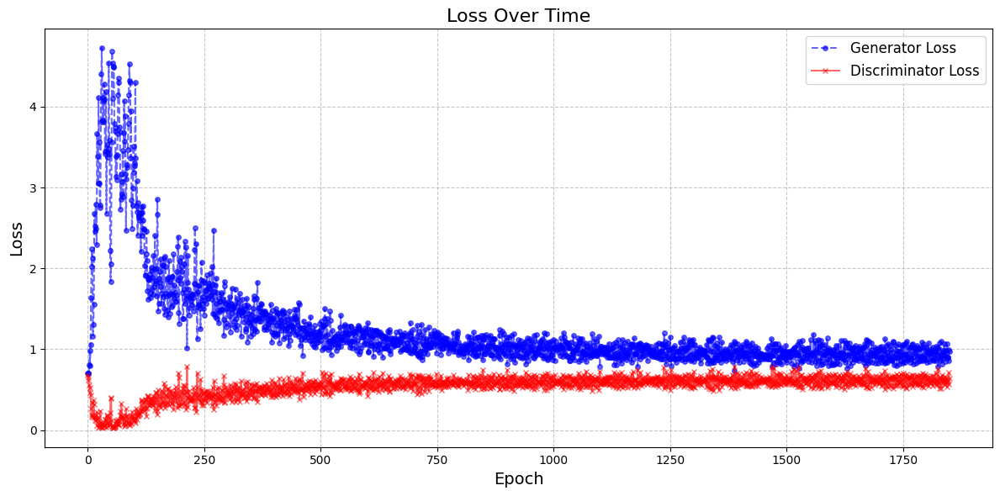

**********************
Epoch number: 79
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 37500: Generator loss: 0.945656499505043, discriminator loss: 0.6096561464071274


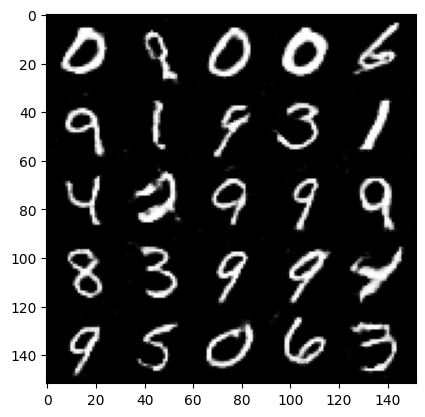

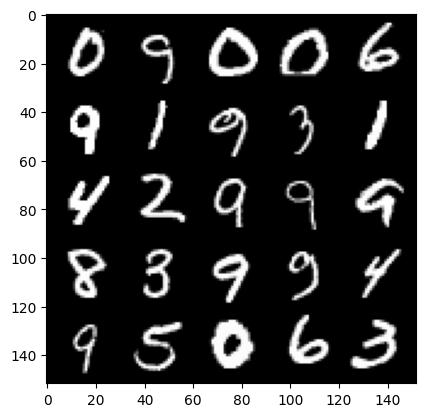

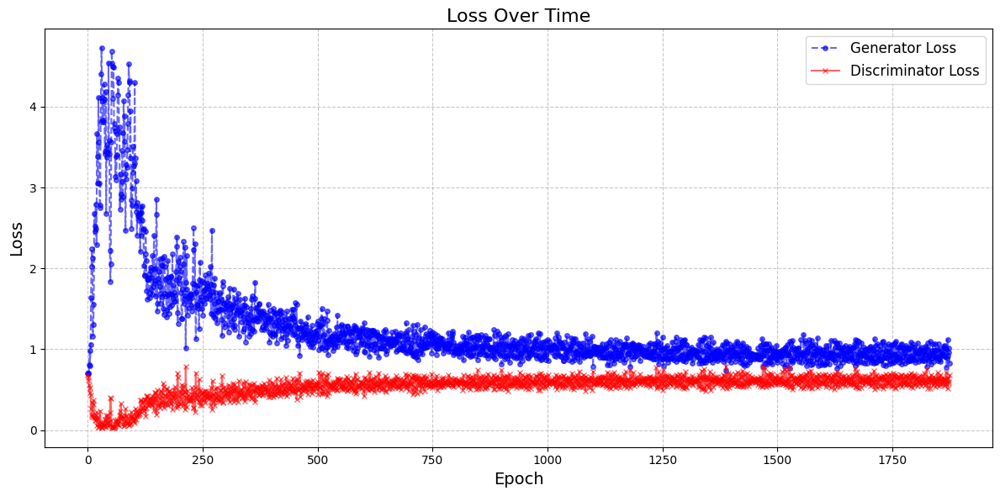

**********************
Epoch number: 80
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

**********************
Epoch number: 81
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 38000: Generator loss: 0.9418003160953522, discriminator loss: 0.6113717027902603


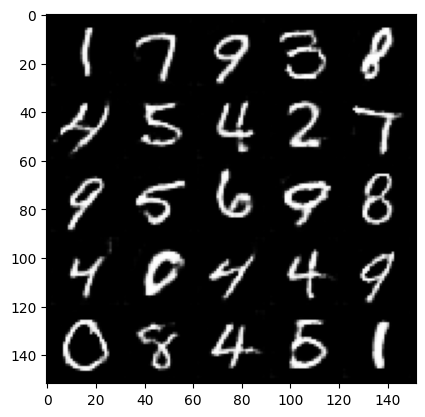

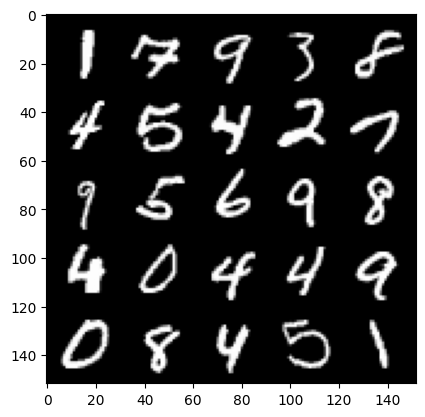

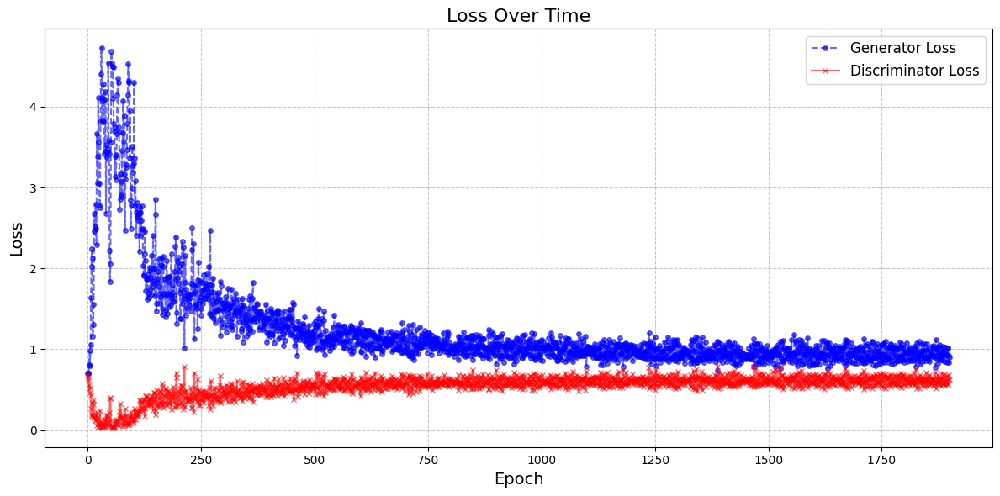

**********************
Epoch number: 82
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 38500: Generator loss: 0.9504768779277801, discriminator loss: 0.6111143481731415


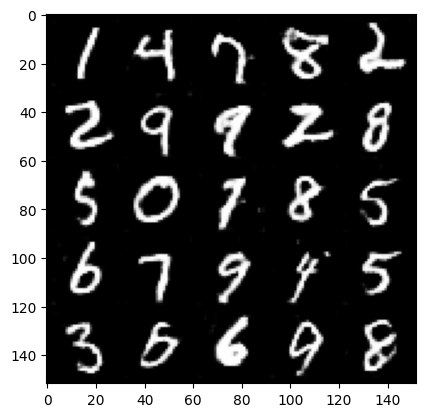

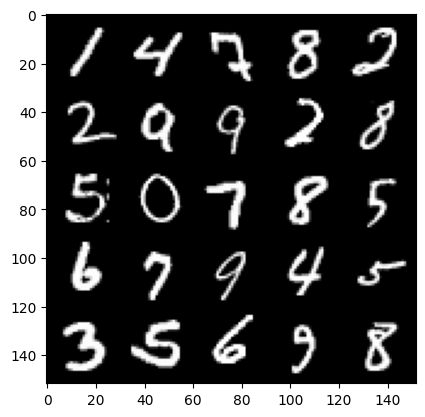

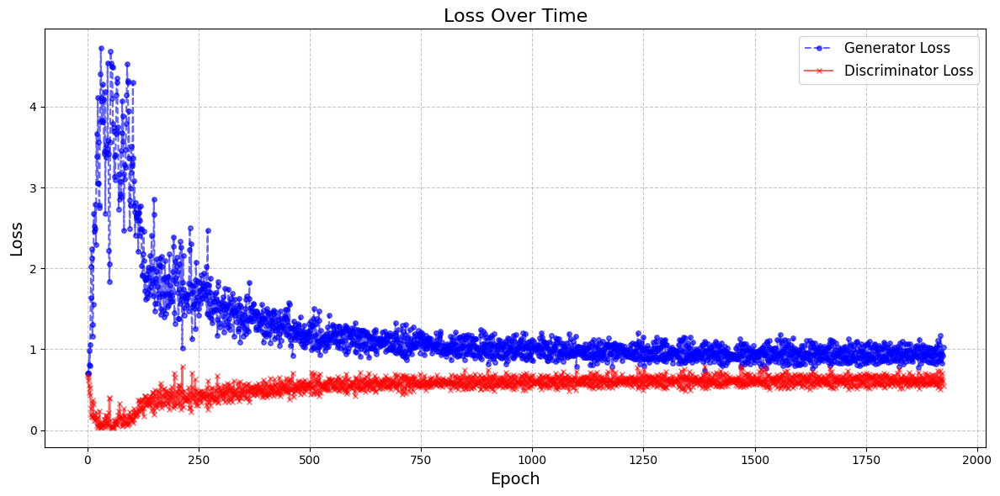

**********************
Epoch number: 83
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 39000: Generator loss: 0.9348901369571686, discriminator loss: 0.6139891222715378


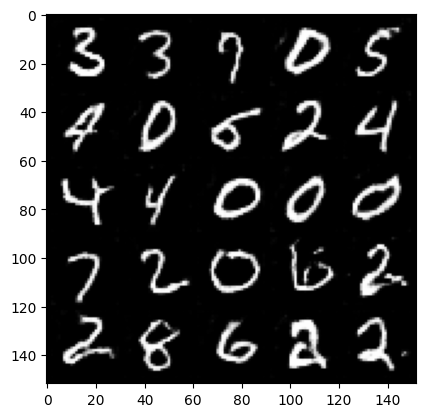

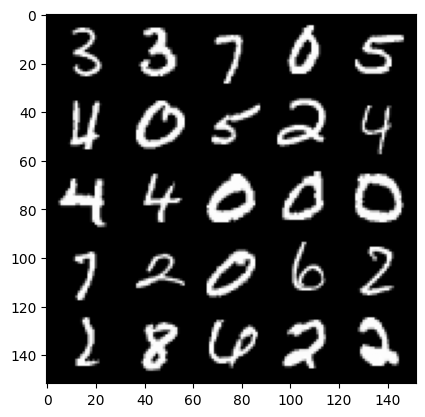

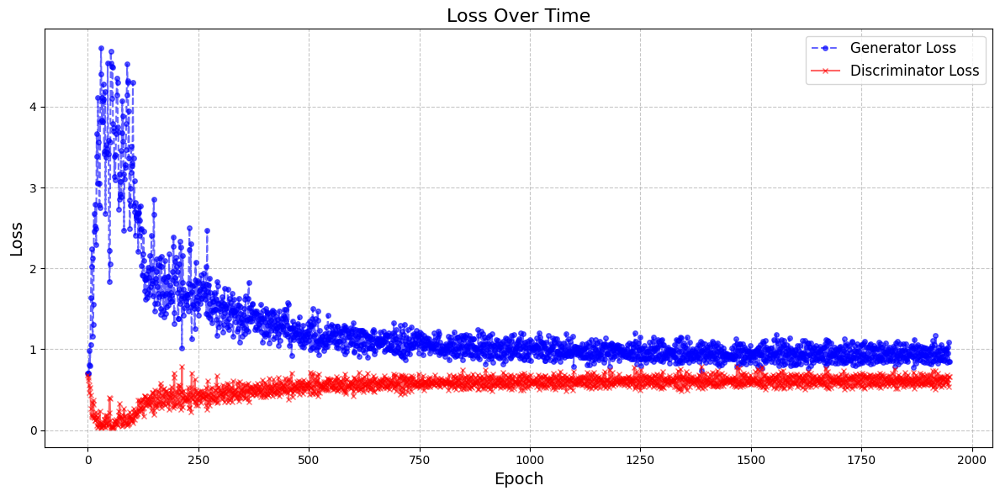

**********************
Epoch number: 84
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 39500: Generator loss: 0.9600845842361451, discriminator loss: 0.6106264734268189


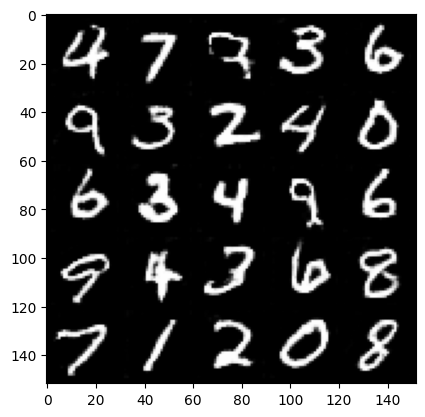

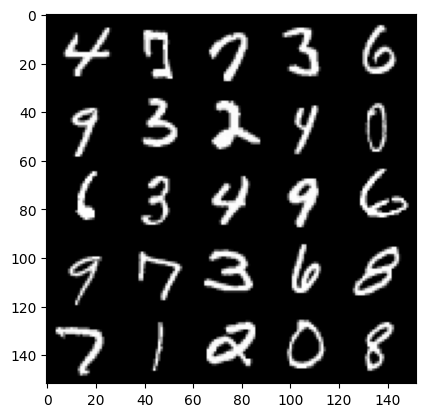

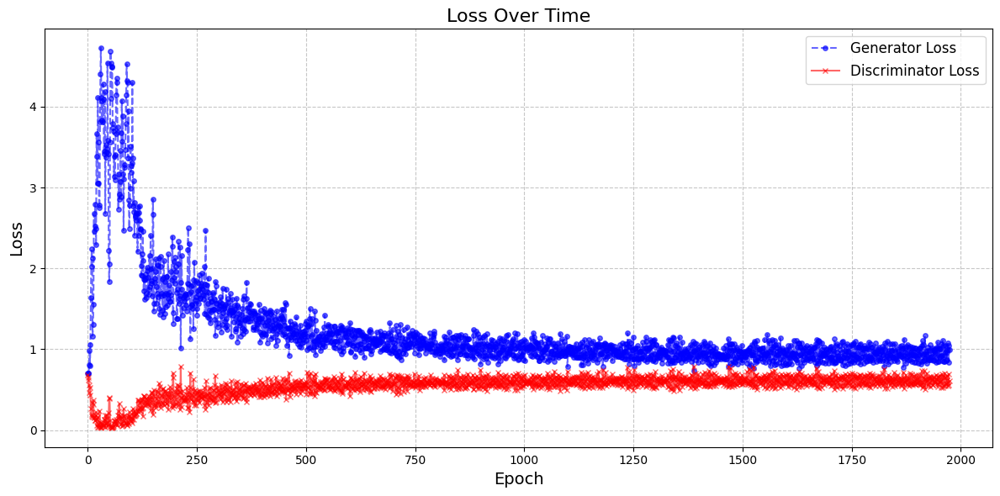

**********************
Epoch number: 85
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 40000: Generator loss: 0.9408887865543365, discriminator loss: 0.611193627178669


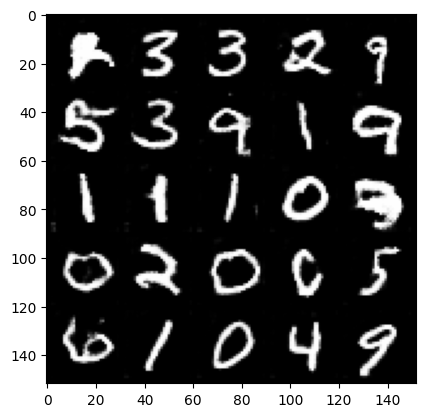

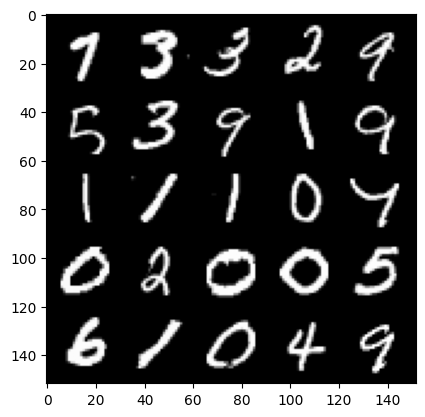

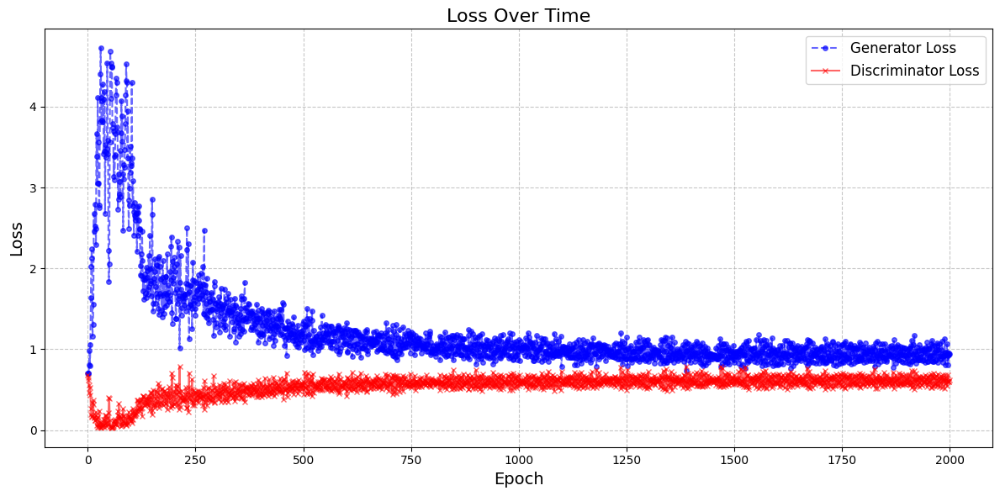

**********************
Epoch number: 86
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 40500: Generator loss: 0.9368133078813553, discriminator loss: 0.6096042289733886


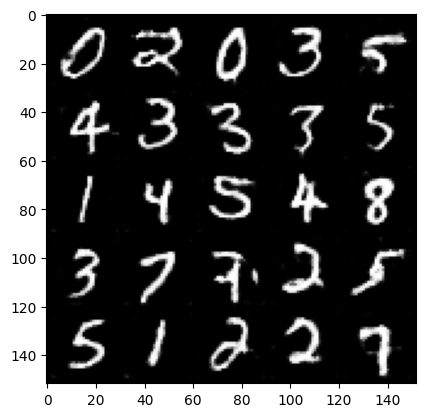

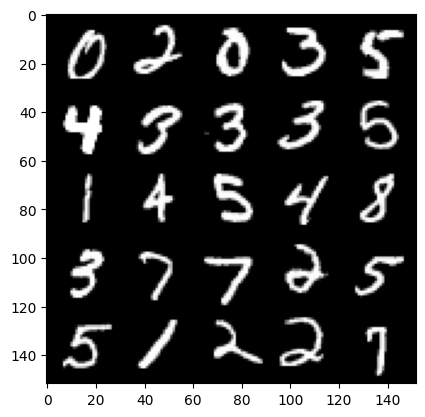

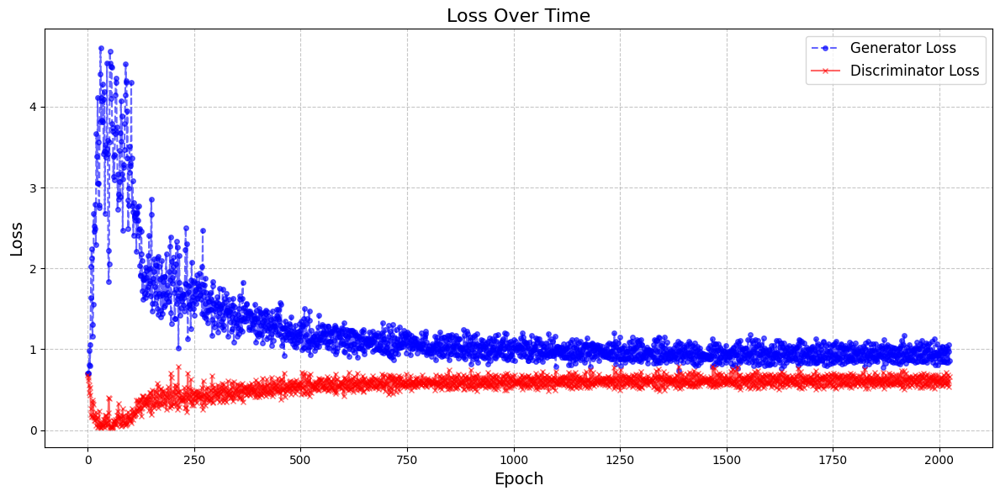

**********************
Epoch number: 87
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 41000: Generator loss: 0.9606092898845673, discriminator loss: 0.60618644541502


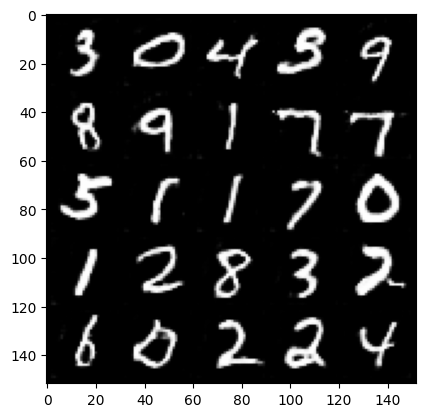

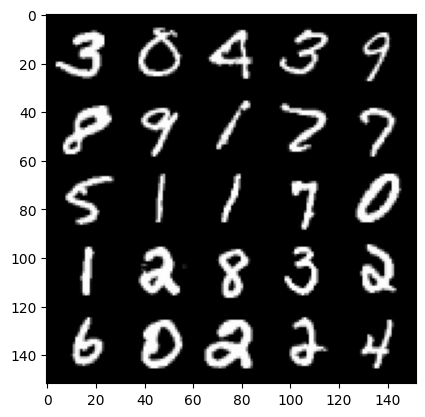

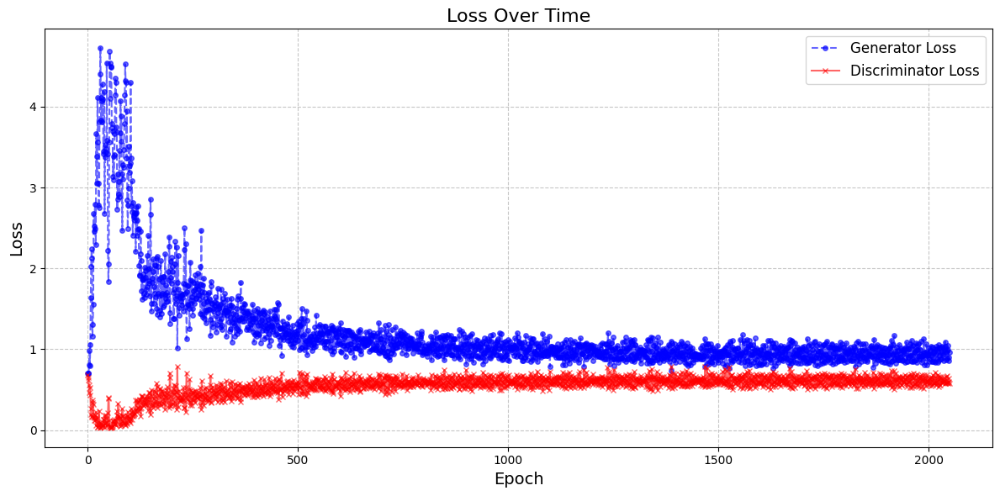

**********************
Epoch number: 88
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 41500: Generator loss: 0.939721491098404, discriminator loss: 0.6108657953739166


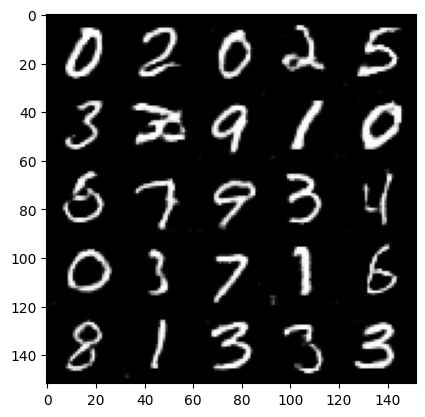

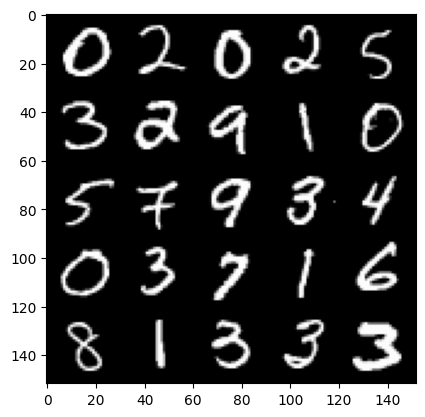

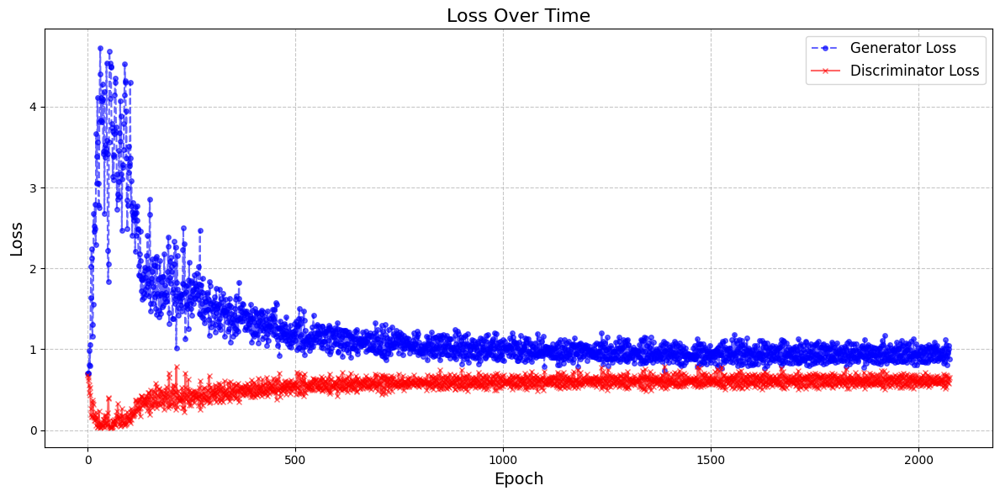

**********************
Epoch number: 89
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 42000: Generator loss: 0.9441716274023056, discriminator loss: 0.6065825478434562


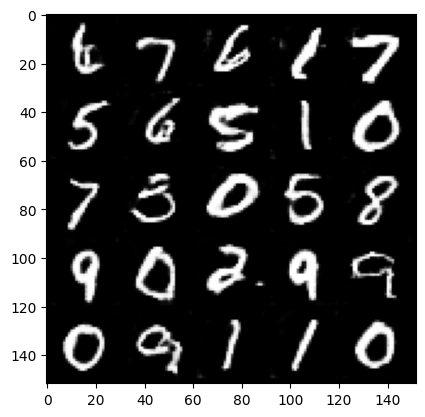

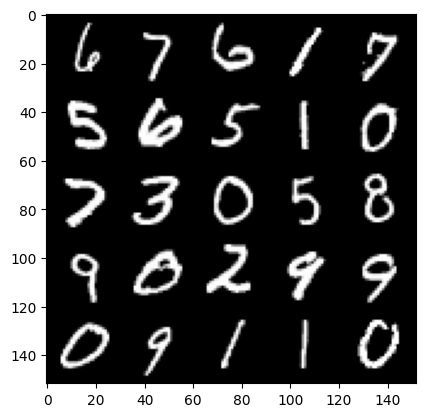

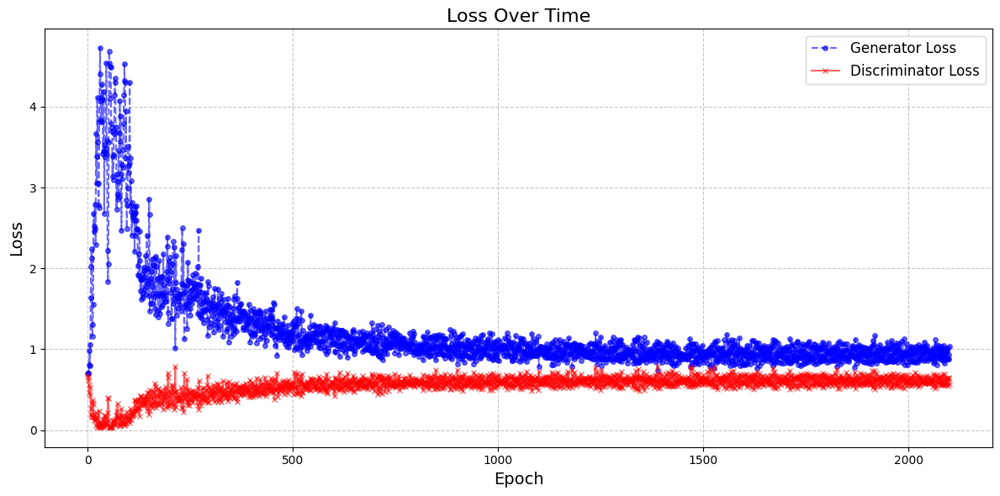

**********************
Epoch number: 90
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 42500: Generator loss: 0.9518096951246262, discriminator loss: 0.6097661238908768


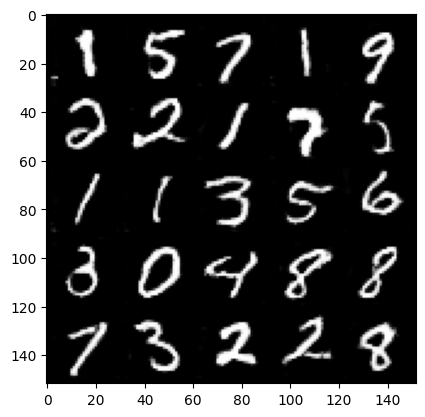

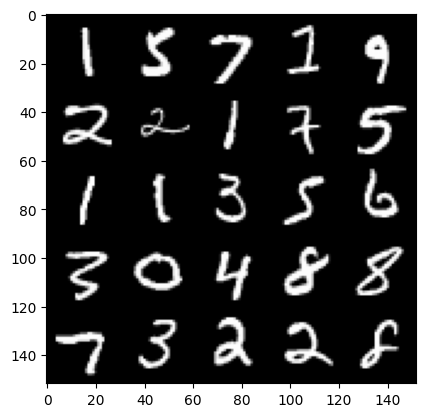

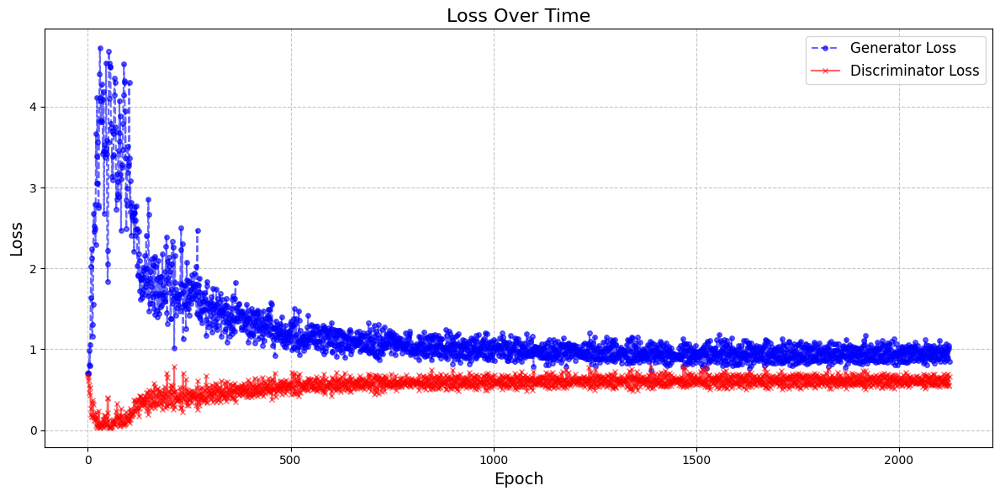

**********************
Epoch number: 91
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 43000: Generator loss: 0.9742380129098892, discriminator loss: 0.6106402317881584


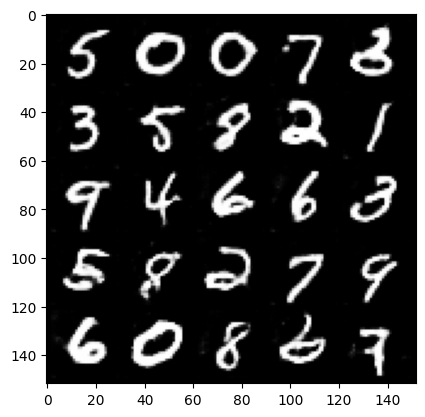

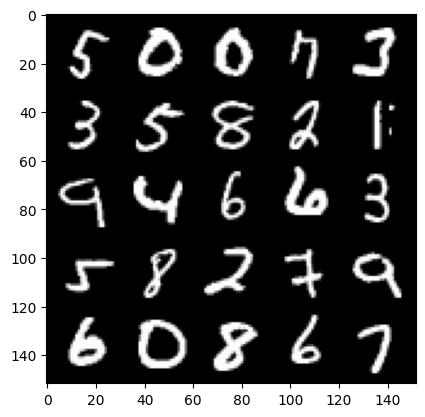

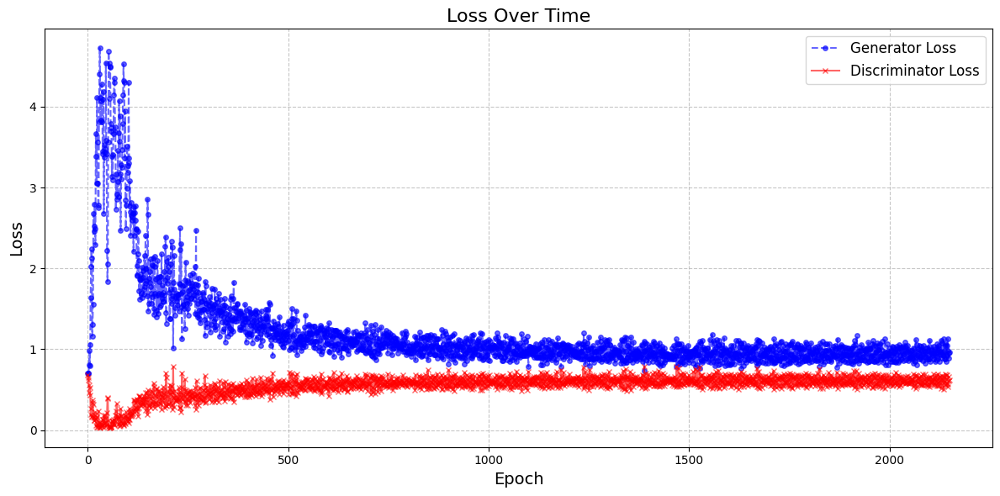

**********************
Epoch number: 92
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 43500: Generator loss: 0.9500998131036759, discriminator loss: 0.6103081602454186


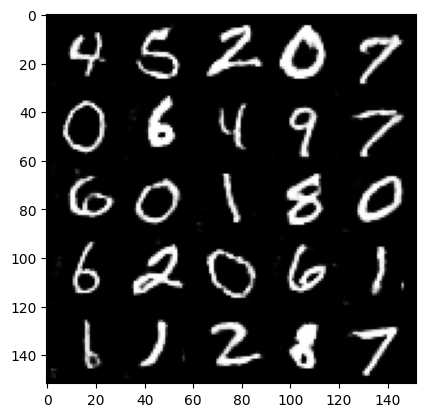

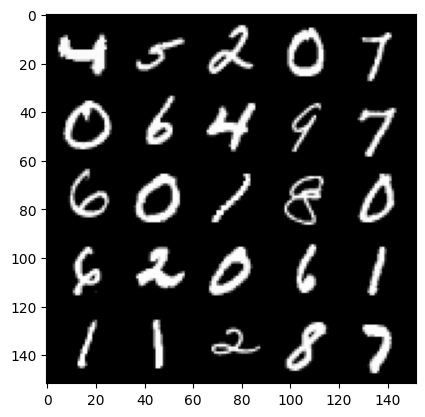

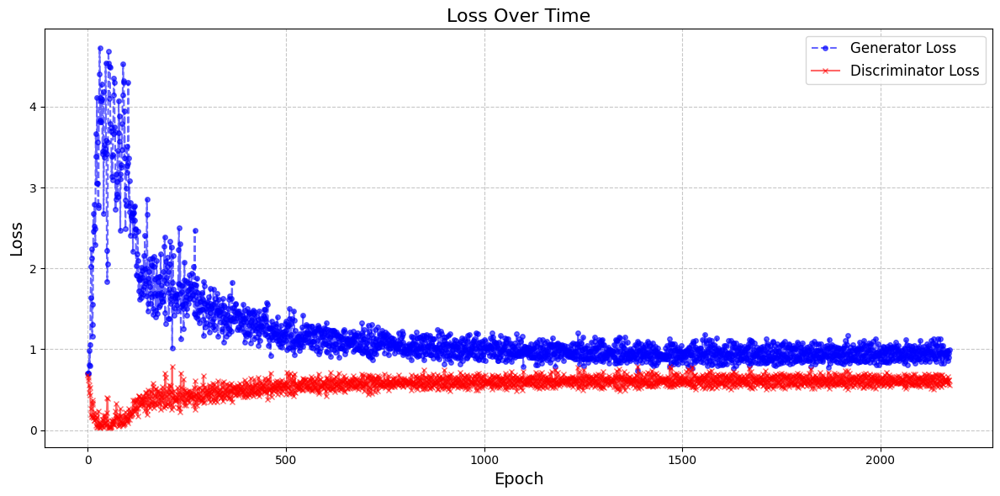

**********************
Epoch number: 93
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 44000: Generator loss: 0.9344526289701461, discriminator loss: 0.6092576448321343


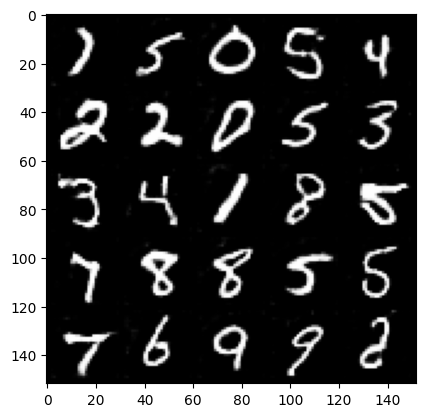

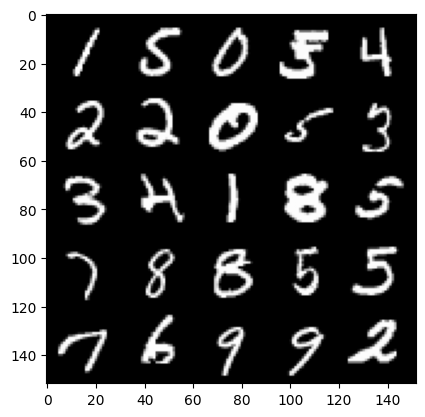

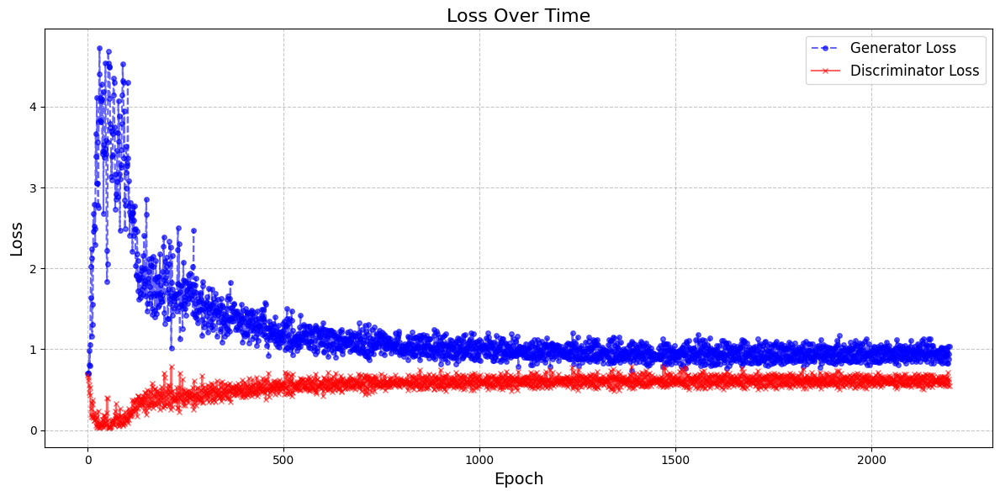

**********************
Epoch number: 94
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 44500: Generator loss: 0.9513132305145263, discriminator loss: 0.6110554074645043


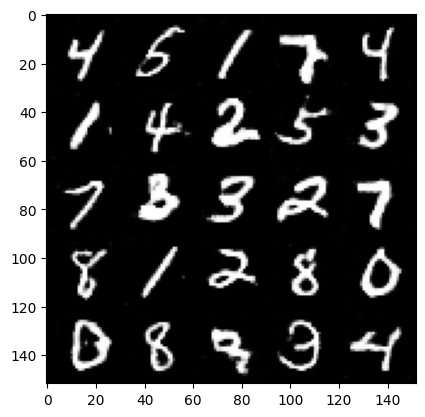

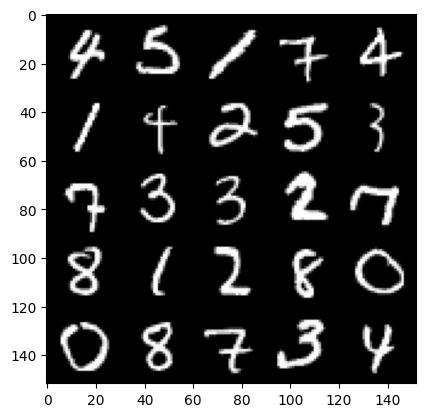

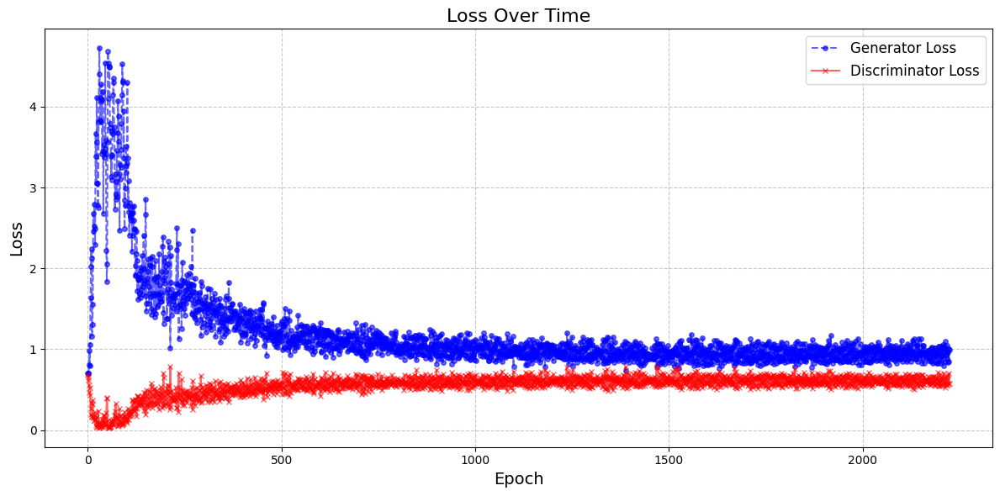

**********************
Epoch number: 95
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 45000: Generator loss: 0.9498188532590867, discriminator loss: 0.6052370947599411


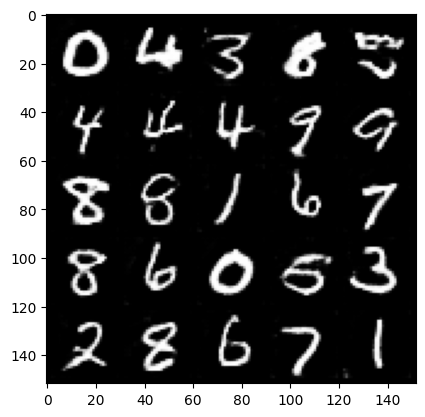

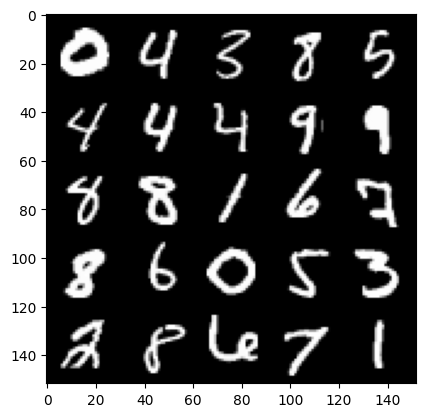

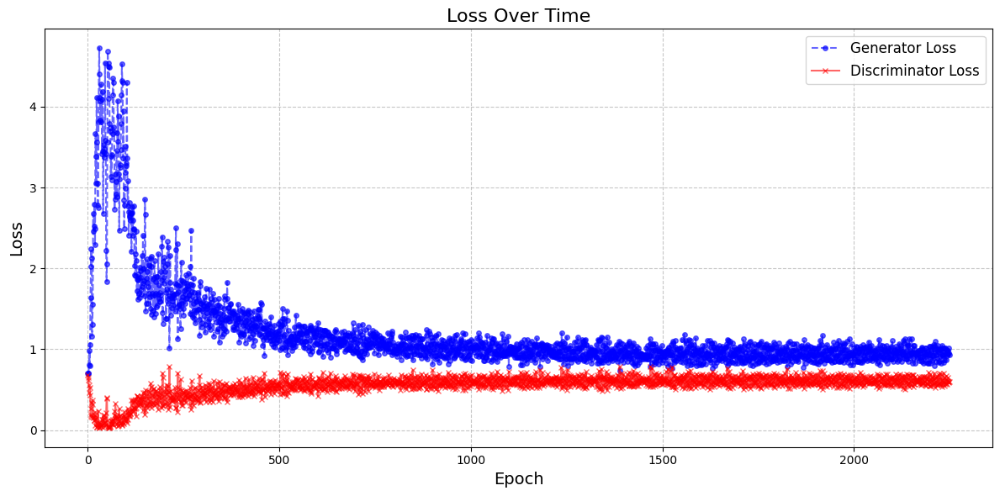

**********************
Epoch number: 96
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

**********************
Epoch number: 97
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 45500: Generator loss: 0.959628809928894, discriminator loss: 0.6098070608973503


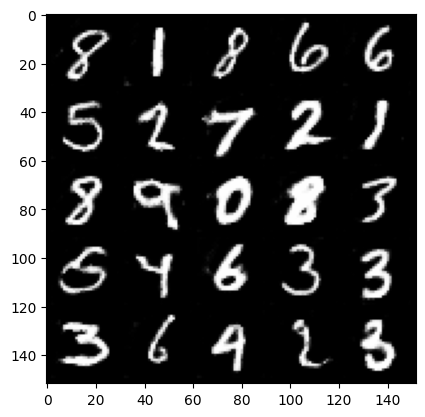

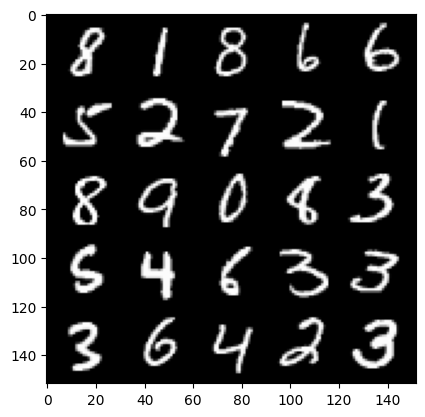

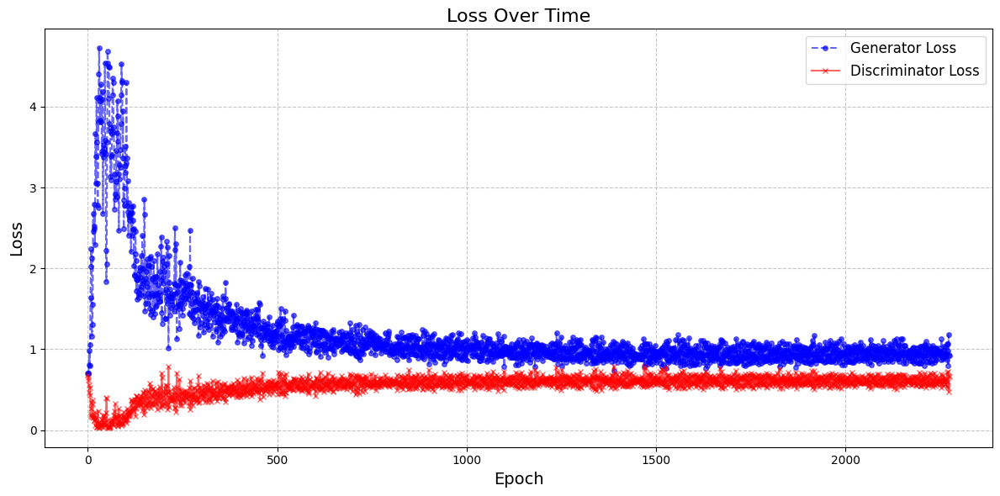

**********************
Epoch number: 98
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 46000: Generator loss: 0.9541712720394134, discriminator loss: 0.6015936813950539


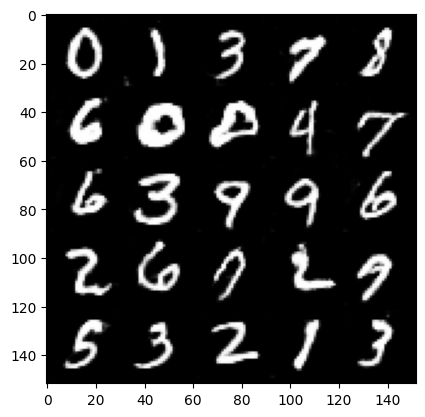

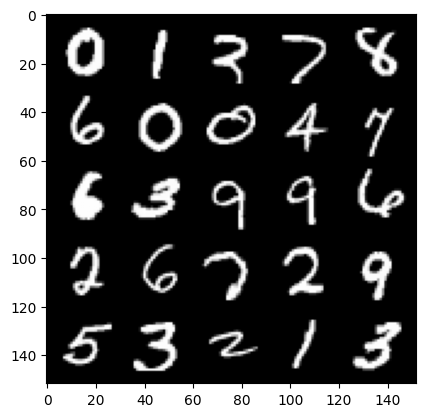

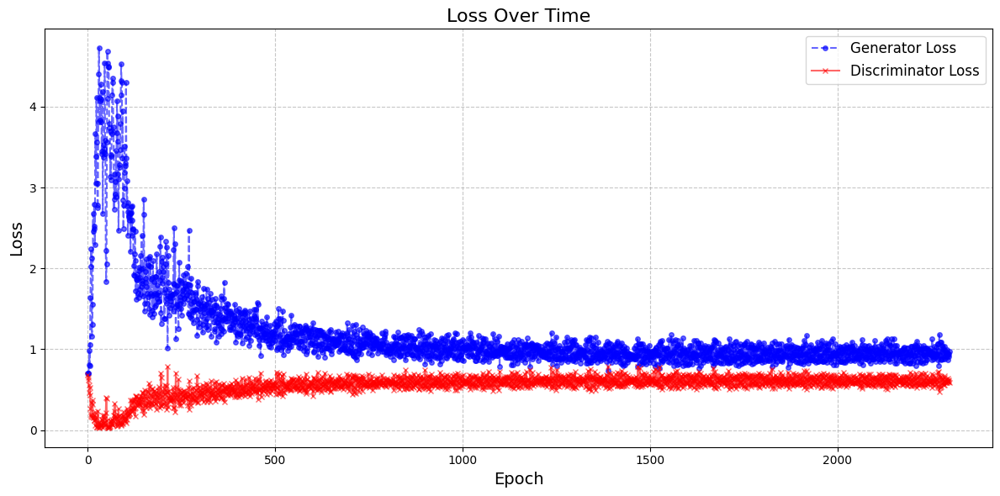

**********************
Epoch number: 99
**********************


  0%|          | 0/469 [00:00<?, ?it/s]

Step 46500: Generator loss: 0.939923623919487, discriminator loss: 0.6056312497258186


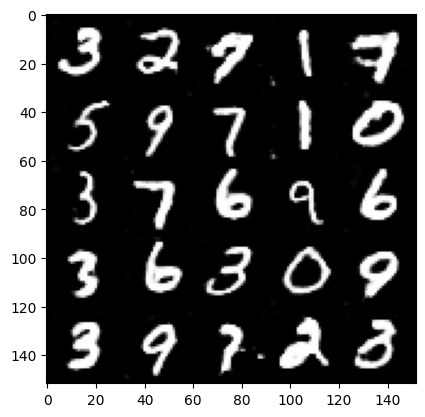

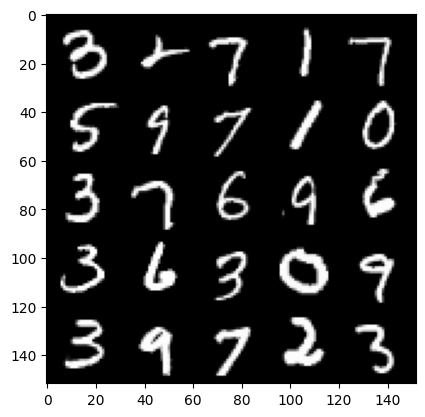

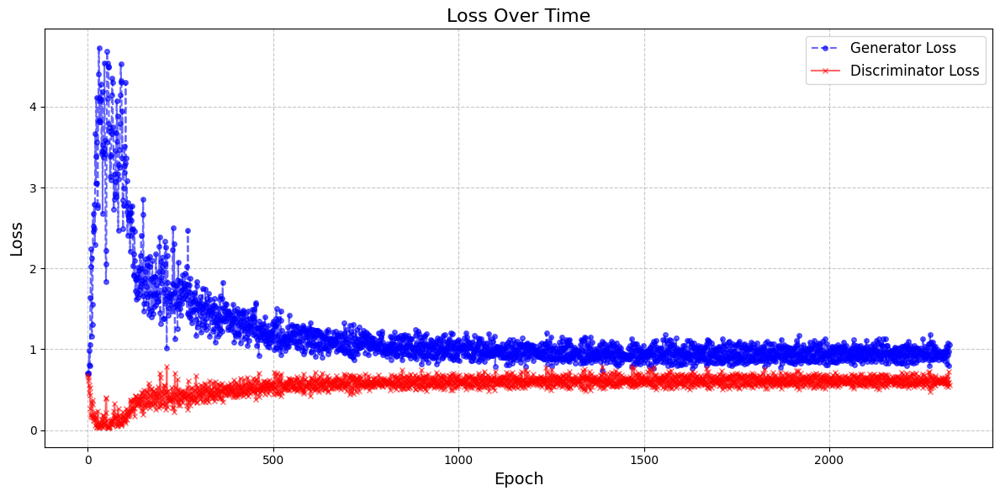

In [10]:
# Initialize variables to keep track of the best losses
best_disc_loss = float('inf')
best_gen_loss = float('inf')

# Directory where model checkpoints will be saved
checkpoint_dir = 'model_checkpoints'
os.makedirs(checkpoint_dir, exist_ok=True)

cur_step = 0
generator_losses = []
discriminator_losses = []

noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    print("**********************")
    print(f"Epoch number: {epoch}")
    print("**********************")
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)

        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images

        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)

        # 1) Create the input for the discriminator
        #    a) Combine the fake images with image_one_hot_labels,
        #       detach the generator (.detach()) so you do not backpropagate through it
        #    b) Combine the real images with image_one_hot_labels
        # 2) Get the discriminator's prediction on the fakes as disc_fake_pred
        # 3) Get the discriminator's prediction on the reals as disc_real_pred

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)

        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step()

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)

        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]

        # Plotting code
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)

            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins

            plt.figure(figsize=(12, 6))

            # Plot Generator Loss
            plt.plot(
                range(num_examples // step_bins),
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss",
                color='blue',
                linestyle='--',
                marker='o',
                markersize=4,
                alpha=0.6
            )

            # Plot Discriminator Loss
            plt.plot(
                range(num_examples // step_bins),
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss",
                color='red',
                linestyle='-',
                marker='x',
                markersize=4,
                alpha=0.6
            )

            # Customize plot
            plt.title('Loss Over Time', fontsize=16)
            plt.xlabel('Epoch', fontsize=14)
            plt.ylabel('Loss', fontsize=14)
            plt.grid(True, linestyle='--', alpha=0.7)
            plt.legend(fontsize=12)
            plt.tight_layout()

            # Show plot
            plt.show()
            plt.close()

        cur_step += 1
    # Check and save the models if loss improved
    avg_disc_loss = sum(discriminator_losses[-display_step:]) / display_step if len(discriminator_losses) >= display_step else disc_loss.item()
    avg_gen_loss = sum(generator_losses[-display_step:]) / display_step if len(generator_losses) >= display_step else gen_loss.item()

    if avg_disc_loss < best_disc_loss:
        best_disc_loss = avg_disc_loss
        torch.save(disc.state_dict(), os.path.join(checkpoint_dir, 'best_discriminator.pth'))
        print(f"Saved best discriminator model with loss: {best_disc_loss}")

    if avg_gen_loss < best_gen_loss:
        best_gen_loss = avg_gen_loss
        torch.save(gen.state_dict(), os.path.join(checkpoint_dir, 'best_generator.pth'))
        print(f"Saved best generator model with loss: {best_gen_loss}")

In [11]:
# Load the model weights
gen_checkpoint_path = 'model_checkpoints/best_generator.pth'
disc_checkpoint_path = 'model_checkpoints/best_discriminator.pth'

# Load state dicts
# gen.load_state_dict(torch.load(gen_checkpoint_path))
# disc.load_state_dict(torch.load(disc_checkpoint_path))


# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
We can generate some numbers with our new model! We can add interpolation as well to make it more interesting.

So starting from a image, we will produce intermediate images that look more and more like the ending image until we get to the final image. We're basically morphing one image into another. We can choose what these two images will be using our conditional GAN.

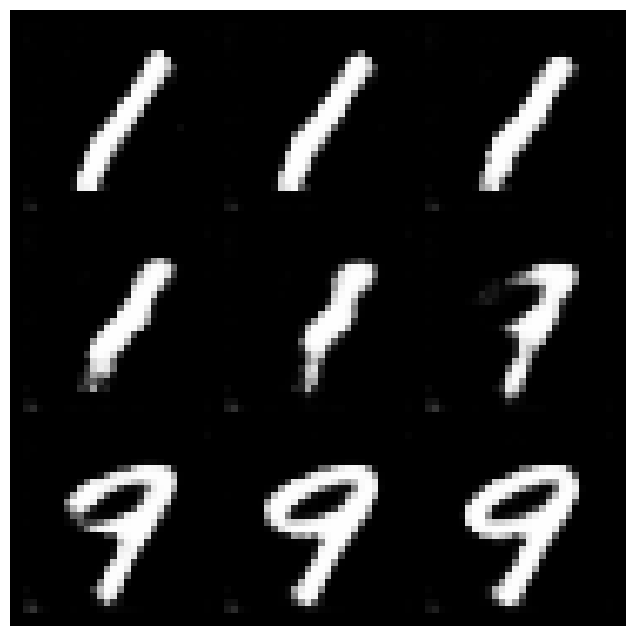

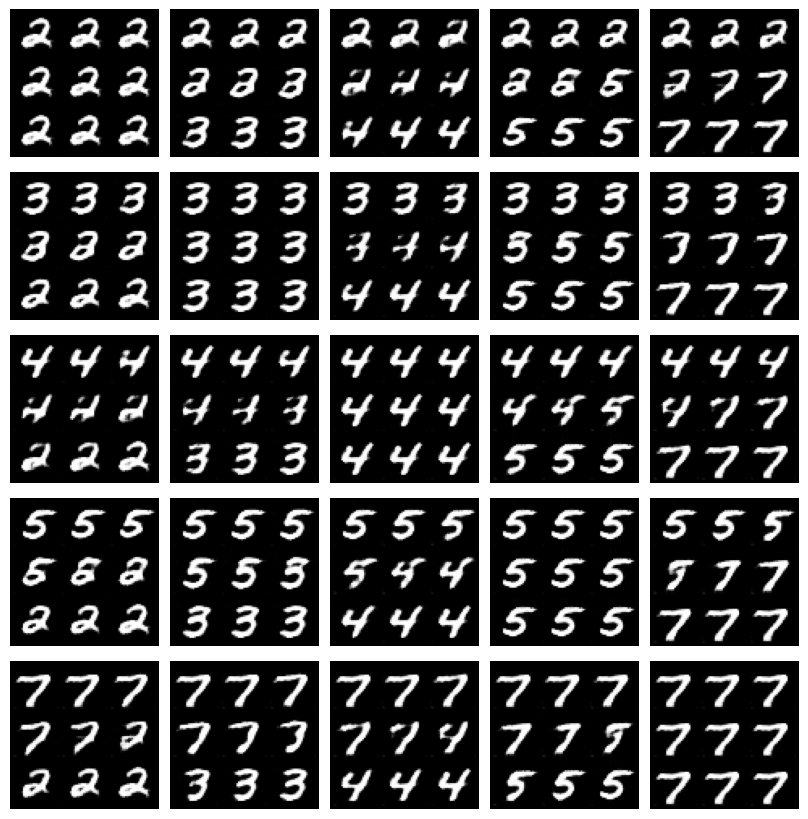

In [15]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number, n_interpolation, interpolation_noise):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 9 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number, n_interpolation, interpolation_noise)
_ = plt.axis('off')

### interpolations for a collection of different numbers, all in a single grid of interpolations.
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number, n_interpolation, interpolation_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if we hold the class constant, but instead we change the noise vector? We can also interpolate the noise vector and generate an image at each step.

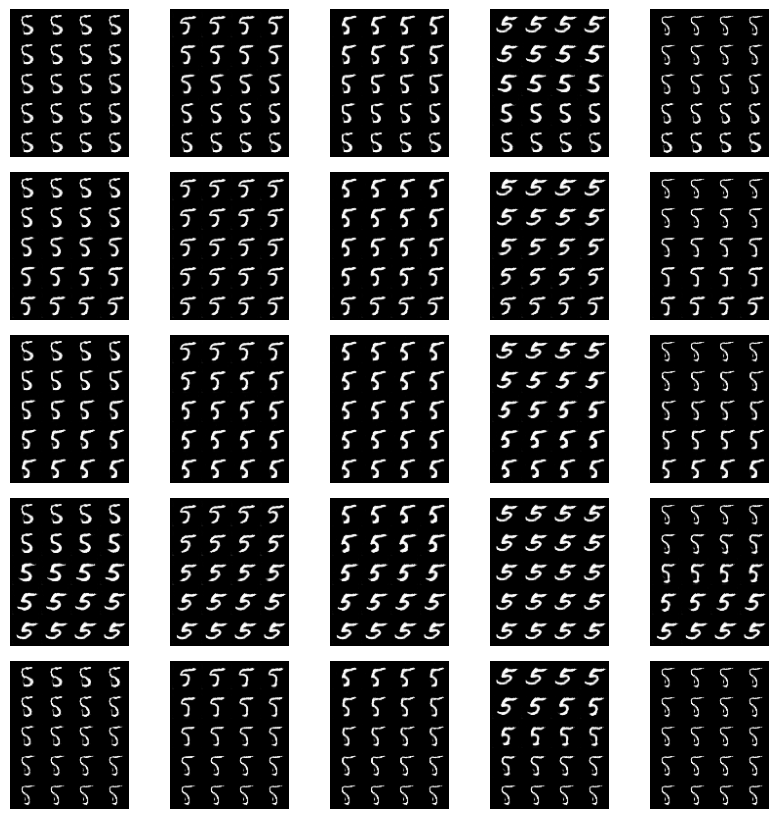

In [16]:
n_interpolation = 20 #9 # How many intermediate images you want + 2 (for the start and end image)

# This time we're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time We're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()